# Street-level analysis of public transport options in Oslo

The project will aim to :
* extract geo-coordinates of each street address
  * Street start address > street end address
* Use Foursquare API to obtain:
  * Bus stations
  * Bus stops
  * Metro
  * Light rail

# Part I: Web Scraping of postcodes and streets

## 1. Set up environment

In [1]:
import pandas as pd
import numpy as np
import folium
import urllib.request, urllib.parse, urllib.error
from urllib.request import urlopen
from bs4 import BeautifulSoup
import ssl
import re

## 2. Obtain and parse URL

#### 2.1 Ignore SSL errors

In [2]:
cntxt = ssl.create_default_context()
cntxt.check_hostname = False
cntxt.verify_mode = ssl.CERT_NONE

#### 2.2 Obtain URL

In [3]:
url = input('Please enter the website to obtain data from: ')
if len(url) < 1: url = 'https://www.erikbolstad.no/postnummer-koordinatar/kommune.php?kommunenummer=301'
print('You want data from >>>\n', url, '\n<<<')

Please enter the website to obtain data from:  


You want data from >>>
 https://www.erikbolstad.no/postnummer-koordinatar/kommune.php?kommunenummer=301 
<<<


#### 2.3 Parse URL

In [4]:
#Use a file-handle like object to open the url
html = urlopen(url, context= cntxt).read() #Read slurps everything in #Note that is additional function written at end

#Use BeautifulSoup to parse
soup = BeautifulSoup(html, 'html.parser')

## 3. Explore and obtain relevant data

For each Postkodenummer :
* Ignore postnummer til postboksar, postnummer til servicepostnummer, postnummer til gateadresser og postboksar
* Obtain Lat + Lon of postnummer of gate-/veg-adresse, save in table1
* Obtain all street names (Gate-/veg-adresse)
  * For each streetname :
      * Obtain Koordinatar of all addresses
          * Extract coodinates of start address/minimum
          * Extract coordinates of end address/last
          * ~~Estimate street length~~
          * Establish mid-point
      * Save in table2

In [5]:
type(soup)

bs4.BeautifulSoup

In [6]:
#soup

In [7]:
#Data is contained in the <tr> tags
tags = soup('tr')

In [8]:
tags

#Postcode info in the text field of 'a' tags
count = 0 #Initiate counter
for i in tags:
    count = count +1
    print('\nCount: {}'.format(count))
    if count == 5:
        break
        
    #Ignore Postboksar
    
    print(i)


Count: 1
<tr><th>Postnummer</th><th>Bruksområde</th><th>Koordinatar</th><th>Bydel</th><th class="h">Folketal<br/>2018</th></tr>

Count: 2
<tr class="ibruk">
<th itemscope="" itemtype="https://schema.org/PostalAddress"><a href="https://www.erikbolstad.no/postnummer-koordinatar/?postnummer=0001">0001 OSLO</a></th>
<td>Postboksar</td>
<td class="datakvalitet2"><a href="https://google.no/maps/?q=59.9116,10.7545">59.9116, 10.7545</a></td>
<td>Sentrum</td><td class="h"></td></tr>

Count: 3
<tr class="ikkjeibruk">
<th itemscope="" itemtype="https://schema.org/PostalAddress"><a href="https://www.erikbolstad.no/postnummer-koordinatar/?postnummer=0009">0009 OSLO </a></th>
<td>Ikkje i bruk</td>
<td class="datakvalitet6"><a href="https://google.no/maps/?q=59.91,10.75">59.9100, 10.7500</a> ?</td>
<td></td><td class="h"></td></tr>

Count: 4
<tr class="ibruk">
<th itemscope="" itemtype="https://schema.org/PostalAddress"><a href="https://www.erikbolstad.no/postnummer-koordinatar/?postnummer=0010">001

In [9]:
#Trying out parsing as per video: https://www.youtube.com/watch?v=ng2o98k983k
match = soup.tr
print(match)

<tr><th>Postnummer</th><th>Bruksområde</th><th>Koordinatar</th><th>Bydel</th><th class="h">Folketal<br/>2018</th></tr>


In [10]:
#If we want the text, use the text attribute
match2 = soup.tr.text
print(match2)#All are slurped together

PostnummerBruksområdeKoordinatarBydelFolketal2018


In [11]:
#Use find method and class_ argument to narrow down the exact attributes to extract
match3 = soup.find('tr', class_ = 'ibruk')
print(match3)

<tr class="ibruk">
<th itemscope="" itemtype="https://schema.org/PostalAddress"><a href="https://www.erikbolstad.no/postnummer-koordinatar/?postnummer=0001">0001 OSLO</a></th>
<td>Postboksar</td>
<td class="datakvalitet2"><a href="https://google.no/maps/?q=59.9116,10.7545">59.9116, 10.7545</a></td>
<td>Sentrum</td><td class="h"></td></tr>


In [12]:
#Now, we try to make things work for 1 postcode
## Once that is working, we can extend the logic to all postcodes
### From above match3, we drill down to the tags containing our info of interest - th > a > text
post = match3.th.a.text
print(post)

0001 OSLO


In [244]:
print(match3.a.text)

0001 OSLO


In [14]:
td = match3.find_all('td')#Multiple td tags within EACH tr tag
print(td)

[<td>Postboksar</td>, <td class="datakvalitet2"><a href="https://google.no/maps/?q=59.9116,10.7545">59.9116, 10.7545</a></td>, <td>Sentrum</td>, <td class="h"></td>]


In [245]:
#Extract tags that are in use
tagsinUse = soup.find_all('tr', class_ = 'ibruk')

count = 0 #Initiate counter
dictn = {} #With postcode as KEy, and everything else as LIST of values
lisT = []

for i in tagsinUse:
    #count = count +1
    #print('\nCount: {}'.format(count))
    #if count == 5:
     #   break
          
    #Look at the parts of the tag
    #print('TAG:', i)
    #print('Postnummer:', i.th.text)#WORKS
    #print(str(i.contents))
    #print(type(str(i.contents)))
    
    if re.search('Gate-/veg-adresse', str(i.contents)):#i.e. print only if postbox belongs to gate/veg-adresse
        #For intial testing
        #count = count +1
        #if count > 5:
               # break
            
        #print('\nCount: {}'.format(count))
        #print(str(i.contents))#Convert to str is important to be able to perform regEX
        #print(i.th.a.text)#Extract postcode number
        #print(len(i.contents))#Seems to be constant length of 9 (counting from 0)
        #print(i.contents[5].a.text)#From 5th element (counting from 0, extract the lat+ long)
        #contents[7].text #Extract bydel
        
        #print(i.th.a.text,i.contents[7].text, i.contents[5].a.text)
        pinCity = i.th.a.text.split(' ')#0018 OSLO #So there is space in between, split on it
        #print(pinCity[0])
        
        #Also split the latitude and longitude
        latlon = i.contents[5].a.text.split(',')
        #print(latlon[0], latlon[1])
        #list.append(i.contents[7].text), list.append(i.contents[5].a.text)
        lisT.append(i.contents[7].text), lisT.append(latlon[0]), lisT.append(latlon[1])
        dictn[pinCity[0]] = lisT
    else:
        continue#Ignore all other instances: Postboksar/Gateadresser og postboksar/Servicepostnummer
    lisT = []

#print('\n<<<----The dictionary follows------>>>>>')
#for k,v in dict.items():
 #   print(k,v)

In [246]:
#Convert to dataframe
data = pd.DataFrame.from_dict(dictn, orient='index')
data.head()

,0,1,2
0463,Sagene,59.9377,10.7552
1163,Nordstrand,59.8650,10.8026
0789,Vestre Aker,59.9692,10.6569
0358,St.Hanshaugen,59.9312,10.7311
0970,Grorud,59.9638,10.8961


In [18]:
#Make modifications on the table to make it prettier
#Assign postcodes to row index
#data.index.name = 'Postcode'
#data.head()

In [247]:
#Reset index
data.reset_index(inplace= True)
data.head()

,index,0,1,2
0,0463,Sagene,59.9377,10.7552
1,1163,Nordstrand,59.8650,10.8026
2,0789,Vestre Aker,59.9692,10.6569
3,0358,St.Hanshaugen,59.9312,10.7311
4,0970,Grorud,59.9638,10.8961


In [248]:
#Change column names
data.columns.values[0:] = ['Postcode','Bydel/District','Latitude','Longitude']
data.head()

,Postcode,Bydel/District,Latitude,Longitude
0,0463,Sagene,59.9377,10.7552
1,1163,Nordstrand,59.8650,10.8026
2,0789,Vestre Aker,59.9692,10.6569
3,0358,St.Hanshaugen,59.9312,10.7311
4,0970,Grorud,59.9638,10.8961


In [249]:
data.shape

(442, 4)

## 4. Obtain street-level information

In [60]:
def postCheck(pass_the_url):
    exceptions = ['0018','0045']
    #if (re.search(exceptions, pass_the_url) for post in exceptions):
    if [post for post in exceptions if re.search(post, pass_the_url)]:#Using List comprehension
        #if re.search(post, pass_the_url):
        print('Exceptional post found, skipping...')
        return 0
    else:
        print(pass_the_url)
        

In [92]:
import requests
#r = requests.get('https://no.wikipedia.org/wiki/Jonas_Gahr_Støre')
#print(r.text)

In [231]:
#Small version, to test things out

#Extract tags that are in use
tagsinUse = soup.find_all('tr', class_ = 'ibruk')

count = 0 #Initiate counter
midStreetDict = dict()
midStreetLoc = list()
failedStreet = list()

for i in tagsinUse:      
    if re.search('Gate-/veg-adresse', str(i.contents)): #i.e. print only if postbox belongs to gate/veg-adresse
        
        #For intial testing
        count = count +1
        if count > 6:break
        print('\nCount: {}'.format(count))
        print('Working on postcode {}...'.format(i.th.a.text))
        posturl = i.th.a.get('href', None )#Postcode link
        postCheck(posturl)#Custom function defined above
        
        #Parse Postcode link and open it
        html2 = urllib.request.urlopen(posturl, context=cntxt)#Open, similar to filehandle
        #print('HTML2 is {}'.format(html2))
        soup2 = BeautifulSoup(html2, 'html.parser')#Parse
        #print(soup2)
        
        #Establish canonical link that will combine with street address URL to form new URL
        canonical = 'https://www.erikbolstad.no/postnummer-koordinatar/'
        
        #Extract tag in the new link
        tagsinUse2 = soup2.find_all('table', style="margin-top: 4rem;")
        for j in tagsinUse2:
            #print('\n<<<<Printing all tags selected from soup2...>>>>')
            #print(j)
            td = j.find_all('td', itemtype="https://schema.org/StreetAddress")#Find the street addresses
            #print('<<<<Printing td tags...>>>>')
            #print(td,'\n')
            #print(j.td.a.text)#Gives only 1 street address#Early version of script
            for tag in td:
                streetUrl = canonical+tag.a.get('href',None)
                streetName = tag.a.text
                print(streetUrl)
                #print('Working on:', tag.a.text,'\n')
                print('Working on:', streetName)
                
                #Parse street url link and open it
                try:
                    #html3 = urllib.request.urlopen(streetUrl, context=cntxt)#Open, similar to filehandle
                    html3 = requests.get(streetUrl).text
                    #print('HTML3 is {}'.format(html3))
                    soup3 = BeautifulSoup(html3, 'html.parser')#Parse
                
                    #Extract all anchor tags since within them one finds the street address + geocoordinates
                    streets = soup3.find_all('a')
    
                    streetList = []
                    latlonList = []
                    #latlonTup = tuple()
                    for datas in streets:
                        text = datas.text
                        #print(text) 
                        #Only get the text that is street name or lat, long
                        if re.search(streetName+'\s[0-9]+', text):# or re.findall('[0-9]+,', text):
                            #print(text)
                            streetList.append(text)
                     
                        elif re.search('[0-9]+,', text):
                            coordinates = text.split(',')
                            #print(tuple(coordinates)) #Make into latlon coordinates tuple so that it can be appended to list
                            latlonList.append(tuple(coordinates))
                        
                    #print(streetList)
                    #print(latlonList)
                    combined = dict(zip(streetList, latlonList))
                
                    #Establish mid-points of streets
                    lat2 = []
                    long2 = []
                    for l in latlonList :
                        lat2.append(float(l[0]))
                        long2.append(float(l[1]))

                    midStreetLat = sum(lat2)/len(lat2)
                    midStreetLon = sum(long2)/len(long2)
                    #midStreetLoc.append(midStreetLat,midStreetLoc)
                    print(streetName,midStreetLat, midStreetLon,'\n')
                except:
                    print('Can\'t open URL, possible UnicodeEncode error. Skipping...\n')
                    failedStreet.append(streetName)
                    



Count: 1
Working on postcode 0018 OSLO...
Exceptional post found, skipping...

Count: 2
Working on postcode 0045 OSLO...
Exceptional post found, skipping...

Count: 3
Working on postcode 0050 OSLO...
https://www.erikbolstad.no/postnummer-koordinatar/?postnummer=0050
https://www.erikbolstad.no/postnummer-koordinatar/veg.php?veg=Stenersgata&kommune=301
Working on: Stenersgata
Stenersgata 59.91311111111111 10.752633333333334 


Count: 4
Working on postcode 0139 OSLO...
https://www.erikbolstad.no/postnummer-koordinatar/?postnummer=0139
https://www.erikbolstad.no/postnummer-koordinatar/veg.php?veg=Blåskjellveien&kommune=301
Working on: Blåskjellveien
Blåskjellveien 59.870850000000004 10.771999999999998 

https://www.erikbolstad.no/postnummer-koordinatar/veg.php?veg=Fiskekroken&kommune=301
Working on: Fiskekroken
Fiskekroken 59.87151269841268 10.772650793650794 

https://www.erikbolstad.no/postnummer-koordinatar/veg.php?veg=Fjordveien&kommune=301
Working on: Fjordveien
Fjordveien 59.8690962

In [233]:
print(failedStreet)

['Dronningens gate']


#### NOTE: FOLLOWING CODE TAKES ~45 mins to RUN

In [165]:
#LONG CODE # RUN ONLY IF ABSOLUTELY REQUIRED

#Extract tags that are in use
tagsinUse = soup.find_all('tr', class_ = 'ibruk')

count = 0 #Initiate counter
midStreetDict = dict()
midStreetLoc = list()

for i in tagsinUse:      
    if re.search('Gate-/veg-adresse', str(i.contents)): #i.e. print only if postbox belongs to gate/veg-adresse
        
        #For intial testing
        count = count +1
        #if count > 4:break
        print('\nCount: {}'.format(count))
        print('Working on postcode {}...'.format(i.th.a.text))
        posturl = i.th.a.get('href', None )#Postcode link
        postCheck(posturl)#Custom function defined above
        
        #Parse Postcode link and open it
        html2 = urllib.request.urlopen(posturl, context=cntxt)#Open, similar to filehandle
        #print('HTML2 is {}'.format(html2))
        soup2 = BeautifulSoup(html2, 'html.parser')#Parse
        #print(soup2)
        
        #Establish canonical link that will combine with street address URL to form new URL
        canonical = 'https://www.erikbolstad.no/postnummer-koordinatar/'
        
        #Extract tag in the new link
        tagsinUse2 = soup2.find_all('table', style="margin-top: 4rem;")
        for j in tagsinUse2:
            #print('\n<<<<Printing all tags selected from soup2...>>>>')
            #print(j)
            td = j.find_all('td', itemtype="https://schema.org/StreetAddress")#Find the street addresses
            #print('<<<<Printing td tags...>>>>')
            #print(td,'\n')
            #print(j.td.a.text)#Gives only 1 street address#Early version of script
            for tag in td:
                streetUrl = canonical+tag.a.get('href',None)
                streetName = tag.a.text
                print(streetUrl)
                #print('Working on:', tag.a.text,'\n')
                print('Working on:', streetName)
                
                #Parse street url link and open it
                try:
                    #html3 = urllib.request.urlopen(streetUrl, context=cntxt)#Open, similar to filehandle
                    html3 = requests.get(streetUrl).text
                    #print('HTML3 is {}'.format(html3))
                    soup3 = BeautifulSoup(html3, 'html.parser')#Parse
                
                    #Extract all anchor tags since within them one finds the street address + geocoordinates
                    streets = soup3.find_all('a')
    
                    streetList = []
                    latlonList = []
                    #latlonTup = tuple()
                    for datas in streets:
                        text = datas.text
                        #print(text) 
                        #Only get the text that is street name or lat, long
                        if re.search(streetName+'\s[0-9]+', text):# or re.findall('[0-9]+,', text):
                            #print(text)
                            streetList.append(text)
                     
                        elif re.search('[0-9]+,', text):
                            coordinates = text.split(',')
                            #print(tuple(coordinates)) #Make into latlon coordinates tuple so that it can be appended to list
                            latlonList.append(tuple(coordinates))
                        
                        #print(streetList)
                        #print(latlonList)
                    combined = dict(zip(streetList, latlonList))
                
                    #Establish mid-points of streets
                    lat2 = []
                    long2 = []
                    for l in latlonList :
                        lat2.append(float(l[0]))
                        long2.append(float(l[1]))

                    midStreetLat = sum(lat2)/len(lat2)
                    midStreetLon = sum(long2)/len(long2)
                #midStreetStr= str(midStreetLat) +','+ str(midStreetLon)
                #midStreetCoord = midStreetStr.split(',')
                #midStreetLoc.append((midStreetLat,midStreetLon))
                    midStreetLoc.append(midStreetLat), midStreetLoc.append(midStreetLon)
                    print(streetName,midStreetLat, midStreetLon,'\n')
                    midStreetDict[streetName] = midStreetLoc
                    midStreetLoc = []
                except:
                    print('Can\'t open URL, possible UnicodeEncode error. Skipping...\n')



Count: 1
Working on postcode 0018 OSLO...
Exceptional post found, skipping...

Count: 2
Working on postcode 0045 OSLO...
Exceptional post found, skipping...

Count: 3
Working on postcode 0050 OSLO...
https://www.erikbolstad.no/postnummer-koordinatar/?postnummer=0050
https://www.erikbolstad.no/postnummer-koordinatar/veg.php?veg=Stenersgata&kommune=301
Working on: Stenersgata
Stenersgata 59.91311111111111 10.752633333333334 


Count: 4
Working on postcode 0139 OSLO...
https://www.erikbolstad.no/postnummer-koordinatar/?postnummer=0139
https://www.erikbolstad.no/postnummer-koordinatar/veg.php?veg=Blåskjellveien&kommune=301
Working on: Blåskjellveien
Blåskjellveien 59.870850000000004 10.771999999999998 

https://www.erikbolstad.no/postnummer-koordinatar/veg.php?veg=Fiskekroken&kommune=301
Working on: Fiskekroken
Fiskekroken 59.87151269841268 10.772650793650794 

https://www.erikbolstad.no/postnummer-koordinatar/veg.php?veg=Fjordveien&kommune=301
Working on: Fjordveien
Fjordveien 59.8690962

In [172]:
#Create backup version of the dictionary created above, just in case
midStreetDict_backUp = midStreetDict

#Check backup dictionary formed
#for k,v in midStreetDict_backUp.items():
   # print(k,v)

Gregers Grams vei [59.93487605633801, 10.647214084507048]
Åsbrekka [59.9715588235294, 10.66439411764706]
Lilleborggata [59.936928571428574, 10.770171428571429]
Simensbrekka [59.90077777777779, 10.78355]
Krossveien [59.96255, 10.764100000000001]
Manglerudveien [59.90173483870969, 10.813363870967747]
Eltonveien [59.93868470588235, 10.801751764705877]
Alnagata [59.90304000000002, 10.774946666666667]
Malerhaugveien [59.91375303030304, 10.793398484848485]
Øvre Slottsgate [59.912312, 10.741635999999998]
Gamle Bygdevei [59.85662129277564, 10.825328517110275]
Gruegata [59.9131, 10.774228571428571]
Høydalsveien [59.834476000000016, 10.810259999999998]
Stormyrveien [59.91119310344828, 10.862331034482759]
Kaare Røddes plass [59.92040526315789, 10.784957894736845]
Danmarks gate [59.90806603773585, 10.789337735849056]
Lerdalstoppen [59.83596060606058, 10.801919191919195]
Stordamveien [59.91144067796606, 10.847769491525417]
Bredes vei [59.94281632653062, 10.933567346938776]
Skjønnhaugveien [59.88417

In [157]:
#Check a small sample of streets
streetDataSmall = pd.DataFrame.from_dict(combined, orient='index')

#Reset row index to numerical values
streetDataSmall.reset_index(inplace = True)

#Change column names
streetDataSmall.columns.values[0:] = ['StreetAddress','Latitude','Longitude']

#View first 5 rows
streetDataSmall.head()

,StreetAddress,Latitude,Longitude
0,Vargveien 16B,59.8702,10.7726
1,Vargveien 31,59.8690,10.7691
2,Vargveien 28,59.8693,10.7704
3,Vargveien 1C,59.8719,10.7765
4,Vargveien 32,59.8688,10.7697


In [184]:
#Arrange above df in ascending order of address
#streetDataSmall.sort_values('StreetAddress', ascending= True, axis = 0)
from natsort import order_by_index, index_natsorted
streetDataSmall.reindex(index=order_by_index(streetDataSmall.index, index_natsorted(streetDataSmall.StreetAddress))).reset_index()

,index,StreetAddress,Latitude,Longitude
0,31,Vargveien 1A,59.8721,10.7764
1,29,Vargveien 1B,59.8721,10.7764
2,3,Vargveien 1C,59.8719,10.7765
3,46,Vargveien 1D,59.8718,10.7765
4,18,Vargveien 1E,59.8716,10.7763
5,24,Vargveien 1F,59.8714,10.7763
6,40,Vargveien 1G,59.8714,10.7762
7,42,Vargveien 1H,59.8712,10.7760
8,39,Vargveien 2,59.8712,10.7767
9,38,Vargveien 3A,59.8707,10.7753


In [201]:
from natsort import natsorted
natsorted((k,v) for k,v in combined.items())#Sorts on K, and if you want v with it, bracket them together

[('Stensrudsvingen 2', ('59.8192', ' 10.8725')),
 ('Stensrudsvingen 4', ('59.8190', ' 10.8723')),
 ('Stensrudsvingen 5', ('59.8205', ' 10.8700')),
 ('Stensrudsvingen 6', ('59.8174', ' 10.8703')),
 ('Stensrudsvingen 7', ('59.8193', ' 10.8703')),
 ('Stensrudsvingen 8', ('59.8171', ' 10.8703')),
 ('Stensrudsvingen 10', ('59.8185', ' 10.8707')),
 ('Stensrudsvingen 12', ('59.8183', ' 10.8702')),
 ('Stensrudsvingen 14', ('59.8185', ' 10.8697'))]

In [227]:
#Obtain first and last address
#Find length of list
listLen = len(natsorted((k,v) for k,v in combined.items()))
#print(listLen)

count = 0
for i in natsorted((k,v) for k,v in combined.items()):
    count = count+1
    if count == 1:
        coords1 = i[1][0], i[1][1]#Can index within a list of a list in python
        print(coords1)#Geopy distance estimator takes in tuple
    elif count == listLen:
        coords2 = i[1][0], i[1][1]
        print(coords2)

('59.8192', ' 10.8725')
('59.8185', ' 10.8697')


In [229]:
import geopy.distance

coords_1 = (52.2296756, 21.0122287)
print(type(coords_1))
coords_2 = (52.406374, 16.9251681)
print(type(coords_2))

#print (geopy.distance.vincenty(coords_1, coords_2).km) #Vincenty is deprecated, the either of the 2 below
#print (geopy.distance.geodesic(coords_1, coords_2).km)
#print (geopy.distance.distance(coords_1, coords_2).km) #Default
print( geopy.distance.distance(coords1, coords2).m)

<class 'tuple'>
<class 'tuple'>
175.3858930348763


In [166]:
streetData = pd.DataFrame.from_dict(midStreetDict, orient= 'index')

#Reset index
streetData.reset_index(inplace = True)

#Rename columns
streetData.columns.values[0:] = ['Street','MidLatitude','MidLongitude']
streetData.head()

,Street,MidLatitude,MidLongitude
0,Gregers Grams vei,59.934876,10.647214
1,Åsbrekka,59.971559,10.664394
2,Lilleborggata,59.936929,10.770171
3,Simensbrekka,59.900778,10.783550
4,Krossveien,59.962550,10.764100


In [167]:
streetData.shape

(2460, 3)

In [168]:
streetData.isnull().sum()

Street          0
MidLatitude     0
MidLongitude    0
dtype: int64

# Part II: Extracting Foursquare data

### 1. Make folium maps of Oslo

#### 1.1 Using postcode info first

In [12]:
#1.1.1 Obtain coordinates of Oslo
import folium
from geopy.geocoders import Nominatim # module to convert an address into latitude and longitude values

address = 'Oslo, Norway'

geolocator = Nominatim(user_agent="oslo-utforske")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of {} are {}, {}.'.format(address, latitude, longitude))

GeocoderTimedOut: Service timed out

In [ ]:
#In case of Geocode errors while extracting lat, long of Oslo: 59.9133301, 10.7389701.

In [14]:
latitude = 59.9133301
longitude = 10.7389701

In [16]:
#Have a quick look at the post code table
data.head()

NameError: name 'data' is not defined

In [260]:
#The above has hidden characters in the column names, makes it difficult to call by column name
## Convert to to_list to make it work
data.columns = data.columns.tolist()
data[['Latitude']].head()

,Latitude
0,59.9377
1,59.8650
2,59.9692
3,59.9312
4,59.9638


In [279]:
data.columns

Index(['Postcode', 'Bydel/District', 'Latitude', 'Longitude'], dtype='object')

In [15]:
#1.1.2 Make map

map_oslo = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, postcode , district in zip(data['Latitude'], data['Longitude'],
                                                      data['Postcode'],data['Bydel/District']):
    
    #Create pop-up label to display
    label = '{}, {}'.format(postcode, district)#neighborhood, borough originally
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=3,#Change radius of circle marker
        popup=label,
        color='blue',
        fill=False,
        #fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_oslo)  
    
map_oslo


NameError: name 'data' is not defined

#### 1.2 Using street names

In [269]:
streetData.head()

,Street,MidLatitude,MidLongitude
0,Gregers Grams vei,59.934876,10.647214
1,Åsbrekka,59.971559,10.664394
2,Lilleborggata,59.936929,10.770171
3,Simensbrekka,59.900778,10.783550
4,Krossveien,59.962550,10.764100


In [277]:
#streetData[['Latitude']].head() #Gives error, so convert to list
streetData.columns = streetData.columns.tolist()

In [283]:
streetData.columns = streetData.columns.tolist()
streetData[['MidLatitude']].head()

,MidLatitude
0,59.934876
1,59.971559
2,59.936929
3,59.900778
4,59.962550


In [838]:
#1.2.1 Make map with street info
map_oslo = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, street , in zip(streetData['MidLatitude'], streetData['MidLongitude'],
                                                      streetData['Street']):
    
    #Create pop-up label to display
    label = '{}'.format(street)#neighborhood, borough originally
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=2,#Change radius of circle marker
        popup=label,
        color='blue',
        fill=False,
        #fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_oslo)  
    
map_oslo


### 2. Obtain transport options based on postcode

#### 2.1 Find Trikk

In [288]:
#https://foursquare.com/explore?mode=url&ne=59.92741%2C10.792394&q=Metro%20Station&sw=59.897332%2C10.731797

In [839]:
#2.1.1 Set up Foursquare credentials
CLIENT_ID = 'BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK'#'your-client-ID' # your Foursquare ID
CLIENT_SECRET = 'DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ'#'your-client-secret' # your Foursquare Secret
VERSION = '20190605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)


Your credentails:
CLIENT_ID: BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK
CLIENT_SECRET:DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ


In [291]:
#To SEARCH particular type of location (not EXPLORE, search means find, explore means : more about specific location)

#https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={}&v={}&query={}&radius={}

In [840]:
#2.1.2 Obtain info about first postcode
data.iloc[0:1,]

,Postcode,Bydel/District,Latitude,Longitude
0,0463,Sagene,59.9377,10.7552


In [841]:
#2.1.3 Extract lat, long
postLat = float(data.iloc[0, 2])#Must convert to float otherwise error later
postLon = float(data.iloc[0, 3])
area = data.iloc[0,1]
print(area, postLat, postLon)

Sagene 59.9377 10.7552


In [910]:
#2.1.3 Extract lat, long
postLat = float(data.iloc[1, 2])#Must convert to float otherwise error later
postLon = float(data.iloc[1, 3])
area = data.iloc[1,1]
print(area, postLat, postLon)

Nordstrand 59.865 10.8026


In [911]:
#2.1.4 Build the url
radius = 500
query = 'Trikk'#'Light Rail'
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.\
    format(CLIENT_ID, CLIENT_SECRET,postLat, postLon,VERSION,query,radius)
print(url)

https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.865,10.8026&v=20190605&query=Trikk&radius=500


In [912]:
#2.1.5 Send GET request and examine results
import requests
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5d272513c53093002cca35b9'},
 'response': {'venues': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/lightrail_',
       'suffix': '.png'},
      'id': '4bf58dd8d48988d1fc931735',
      'name': 'Light Rail Station',
      'pluralName': 'Light Rail Stations',
      'primary': True,
      'shortName': 'Light Rail'}],
    'hasPerk': False,
    'id': '503f09dde4b09c7b4e98d338',
    'location': {'cc': 'NO',
     'city': 'Oslo',
     'country': 'Norge',
     'distance': 440,
     'formattedAddress': ['Oslo', 'Norge'],
     'labeledLatLngs': [{'label': 'display',
       'lat': 59.86150338139403,
       'lng': 10.798903225090696}],
     'lat': 59.86150338139403,
     'lng': 10.798903225090696,
     'state': 'Oslo'},
    'name': 'Sæter (trikk)',
    'referralId': 'v-1562846483'},
   {'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/trainstation_',
       'suffix': '.png'},
      'id': '4bf58

In [436]:
#print('https://foursquare.com/explore?mode=url&ne=59.943104%2C10.760057&q=Metro%20Station&sw=59.927603%2C10.727484')
#Answers should be in 'response': {'venues': []} or response': {'venues': [{'categories': 

In [913]:
#2.1.6 Now try to extract the above info into a df i.e. convert json to df

from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
#venues = results['response']['groups'][0]['items']
try:
    places = results['response']['venues'][0]#usually the 1st element has the actual Trikk, others are derivatives e.g. Bus for Trikk
    #print(places)
    print(places['name'])
    #print(places['location']['lat'])#['labeledLatLngs'][0]['lat'])
    #print(places['location']['lng'])#['labeledLatLngs'][0]['lng'])
    print(str(places['location']['distance'])+'m')

    
    nearby_places = json_normalize(places)# flatten JSON i.e. convert to dataframe
    #print(type(nearby_places))#Is already a dataframe
    #Cols to keep
    cols_to_keep = ['name', 'location.distance', 'location.lat', 'location.lng']#Coln names Found in the above json_normalised dataframe #'location.address'
    nearby_places = nearby_places[cols_to_keep]
    #nearby_places.head()

    #Clean column names
    nearby_places.columns = [col.split(".")[-1] for col in nearby_places.columns]
    print(nearby_places.head())
except:
    print('No nearby {} found!'.format(query))
    nearby_places.iloc[0,0:] = 'NA'#Create empty dataframe with NA values

Sæter (trikk)
440m
            name  distance        lat        lng
0  Sæter (trikk)       440  59.861503  10.798903


In [914]:
nearby_places

,name,distance,lat,lng
0,Sæter (trikk),440,59.861503,10.798903


In [846]:
#Create a backup of the version of the data table, before manipulating column datatype (we need float for lat, long, NOT obj)
dataBackup = data
dataBackup.head()

,Postcode,Bydel/District,Latitude,Longitude
0,0463,Sagene,59.9377,10.7552
1,1163,Nordstrand,59.8650,10.8026
2,0789,Vestre Aker,59.9692,10.6569
3,0358,St.Hanshaugen,59.9312,10.7311
4,0970,Grorud,59.9638,10.8961


In [847]:
#data.dtypes.values[2:] = ['float64','float64']#Did not quite work like this
#data2 = data.infer_objects()
#data2.dtypes#Did not work either
data[['Latitude', 'Longitude']] = data[['Latitude','Longitude']].astype('float64')#inplace option does not exist
data.dtypes

Postcode           object
Bydel/District     object
Latitude          float64
Longitude         float64
dtype: object

In [1069]:
#SMALL VERSION...UP TO 5 POSTCODES
#10.6 Borrow function to run above on all postcodes i.e. obtain venue category for all the postcodes

def getNearbyVenues3(post, bydel, bydelLat, bydelLon, radius, query):#Where names = postcode
    
    venues_list=[]#Initialise empty list to store details
    for post, bydel, lat, lng in zip(post, bydel, bydelLat, bydelLon):
        print(post,'\t',bydel)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        print(url,'\n')

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        
        try:
            places = results['response']['venues'][0]
            # return only relevant information for each nearby venue
            venues_list.append([(
                post, #postcode
                bydel,#I think this is useful to have, several post codes are in the same borough that may have similar char.
                lat, 
                lng, 
                places['name'],
                places['location']['distance'])]) #for v in results])
        except:
                venues_list.append([ (post, bydel, lat, lng, 'NA', 'NA')]) #for v in results ])
            
            
    
    #Create new dataframe and fill it with values from the venue_list array with 2 nested for loops
                                                ##Note: placement of 'item' below
    #print(venues_list)
    nearby_venues = pd.DataFrame([item for Venue_list in venues_list for item in Venue_list])
    nearby_venues.columns = ['Postcode',#'Neighborhood' 
                             'Bydel',
                  'Postcode Latitude',#'Neighborhood Latitude' 
                  'Postcode Longitude',#'Neighborhood Longitude' 
                  'Venue', 
                  'Venue Distance']#, 
                  #'Venue Longitude', 
                  #'Venue Category']
    
    return(nearby_venues)

#2.1. Run the above code

#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
oslo_places = getNearbyVenues3(post=data['Postcode'][0:5],
                              bydel = data['Bydel/District'][0:5],
                              bydelLat=data['Latitude'][0:5],
                              bydelLon=data['Longitude'][0:5],
                              radius = 400,
                              query = 'Trikk'
                                )


0463 	 Sagene
https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9377,10.7552&v=20190605&query=Trikk&radius=400 

1163 	 Nordstrand
https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.865,10.8026&v=20190605&query=Trikk&radius=400 

0789 	 Vestre Aker
https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9692,10.6569&v=20190605&query=Trikk&radius=400 

0358 	 St.Hanshaugen
https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9312,10.7311&v=20190605&query=Trikk&radius=400 

0970 	 Grorud
https://api.foursquare.com/v2/v

In [1070]:
oslo_places

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance
0,0463,Sagene,59.9377,10.7552,NA,NA
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440
2,0789,Vestre Aker,59.9692,10.6569,NA,NA
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209
4,0970,Grorud,59.9638,10.8961,NA,NA


In [933]:
#FULL VERSION
#2.1.7 Borrow & modify function to run above on all postcodes i.e. obtain venue category for all the postcodes

def getNearbyVenues3(post, bydel, bydelLat, bydelLon, radius, query):#Where names = postcode
    
    venues_list=[]#Initialise empty list to store details
    for post, bydel, lat, lng in zip(post, bydel, bydelLat, bydelLon):
        print(post,'\t',bydel)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        print(url,'\n')

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        
        try:
            places = results['response']['venues'][0]
            # return only relevant information for each nearby venue
            venues_list.append([(
                post, #postcode
                bydel,#I think this is useful to have, several post codes are in the same borough that may have similar char.
                lat, 
                lng, 
                places['name'],
                places['location']['distance'])]) #for v in results])
        except:
                venues_list.append([ (post, bydel, lat, lng, 'NA', 'NA')]) #for v in results ])
            
            
    
    #Create new dataframe and fill it with values from the venue_list array with 2 nested for loops
                                                ##Note: placement of 'item' below
    #print(venues_list)
    nearby_venues = pd.DataFrame([item for Venue_list in venues_list for item in Venue_list])
    nearby_venues.columns = ['Postcode',#'Neighborhood' 
                             'Bydel',
                  'Postcode Latitude',#'Neighborhood Latitude' 
                  'Postcode Longitude',#'Neighborhood Longitude' 
                  'Venue', 
                  'Venue Distance']#, 
                  #'Venue Longitude', 
                  #'Venue Category']
    
    return(nearby_venues)

#2.1. Run the above code

#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
oslo_places = getNearbyVenues3(post=data['Postcode'],
                              bydel = data['Bydel/District'],
                              bydelLat=data['Latitude'],
                              bydelLon=data['Longitude'],
                              radius = 400,
                              query = 'Trikk'
                                )


0463 	 Sagene
https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9377,10.7552&v=20190605&query=Trikk&radius=400 

1163 	 Nordstrand
https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.865,10.8026&v=20190605&query=Trikk&radius=400 

0789 	 Vestre Aker
https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9692,10.6569&v=20190605&query=Trikk&radius=400 

0358 	 St.Hanshaugen
https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9312,10.7311&v=20190605&query=Trikk&radius=400 

0970 	 Grorud
https://api.foursquare.com/v2/v

In [1063]:
oslo_trikk = oslo_places

In [1064]:
oslo_trikk.shape

(442, 6)

In [1065]:
oslo_trikk.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance
0,0463,Sagene,59.9377,10.7552,NaN,NaN
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0
4,0970,Grorud,59.9638,10.8961,NaN,NaN


In [1066]:
oslo_trikk.isna().sum()

Postcode                0
Bydel                   0
Postcode Latitude       0
Postcode Longitude      0
Venue                 281
Venue Distance        281
dtype: int64

In [927]:
oslo_trikk.dtypes

Postcode               object
Bydel                  object
Postcode Latitude     float64
Postcode Longitude    float64
Venue                  object
Venue Distance          int64
dtype: object

In [942]:
oslo_trikk.replace('NA', np.nan, inplace = True)
oslo_trikk.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance
0,0463,Sagene,59.9377,10.7552,NaN,NaN
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0
4,0970,Grorud,59.9638,10.8961,NaN,NaN


In [947]:
oslo_trikk.isnull().sum().values[-1]

281

In [1102]:
print('Of the {} postcodes, one finds {} at {} postcodes'.format(oslo_trikk.shape[0], 'Trikk',\
                                                                 oslo_trikk.shape[0] - oslo_trikk.isnull().sum().values[-1] ))

Of the 442 postcodes, one finds Trikk at 161 postcodes


#### 2.1.2 Find Bus stops

In [1562]:
#1 Extract lat, long
postLat = float(data.iloc[359, 2])#Must convert to float otherwise error later
postLon = float(data.iloc[359, 3])
area = data.iloc[359,1]
post = data.iloc[359,0]
print(post, area, postLat, postLon)

0050 Sentrum 59.9129 10.7522


In [1565]:
#2 Build the url
radius = 400
query = 'Bus Stop'#'Bus Station'
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.\
    format(CLIENT_ID, CLIENT_SECRET,postLat, postLon,VERSION,query,radius)
print(url)

https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9129,10.7522&v=20190605&query=Bus Stop&radius=400


In [1566]:
#3 Send GET request and examine results
import requests
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5d28743b2081a200234035ee'},
 'response': {'venues': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/toys_',
       'suffix': '.png'},
      'id': '4bf58dd8d48988d1f3941735',
      'name': 'Toy / Game Store',
      'pluralName': 'Toy / Game Stores',
      'primary': True,
      'shortName': 'Toys & Games'}],
    'hasPerk': False,
    'id': '4c94a362f244b1f749b1231d',
    'location': {'address': 'Byporten Shopping',
     'cc': 'NO',
     'city': 'Oslo',
     'country': 'Norge',
     'crossStreet': 'Jernbanetorget 6',
     'distance': 87,
     'formattedAddress': ['Byporten Shopping (Jernbanetorget 6)',
      'Oslo',
      'Norge'],
     'labeledLatLngs': [{'label': 'display',
       'lat': 59.91212690832622,
       'lng': 10.75245014572376}],
     'lat': 59.91212690832622,
     'lng': 10.75245014572376,
     'state': 'Oslo'},
    'name': 'Game Stop',
    'referralId': 'v-1562932283'},
   {'categories': [{'icon': {'pr

In [1577]:
#4 Now try to extract the above info into a df i.e. convert json to df
import re
#venues = results['response']['groups'][0]['items']
#try:
places = results['response']['venues']
#print(places)

#if(places[0]['name'] == 'Buss 75A'):
    #print(places[0]['name'])
print('Length:',len(places))
busDict = dict()

if len(places) > 0:
    for i in range(len(places)):# len creates the number, range creates an iterable list because for works on A LIST
        if re.search('Buss?.+', places[i]['name']):
        #print(places[i]['categories'][0]['name'])#0 because it is a list of dictionary, and bus station name is inside categories
        #print(places[i]['location']['distance'])
            busDict[places[i]['location']['distance']] = places[i]['name']
        
        
elif len(places) == 0:
    busDict['NoDist'] = 'No bus station found'
    print('No bus stop nearby!')
    


Length: 30


In [1576]:
for k,v in busDict.items():
    print(k,v)

384 Buss for Flytoget
67 Buss 34
68 Busd 34
325 Buss 82E
199 Buss 31
108 Buss 70
77 Buss 30
144 Buss 54
403 Oslo Bussterminal
407 Bus Line
364 Platform 12 Oslo Bus Terminal
352 Buss mot Grorud
423 Platform 14 Oslo Bus Terminal
103 Buss 54
296 Bus Line
502 Buss 111
363 Buss 542 Til Drøbak
236 Bus4you
175 Buss 252
179 Buss 31 E
308 Buss 542 Seiersten Ekspress
374 Buss 37
375 Konkurenten Bus 28
248 Espresso House Bussterminalen
185 Buss 143


 Searching **'Bus Stop/Station'** also gives **'Bus Lines'**, that I will make the assumption denotes a **bus stand**, and so for practical purposes if the result throws a **'Bus Line'** instead of a **'Bus Station'**, I will consider that good enough

In [1589]:
#SMALL TEST VERSION
# Extend to all postcodes

busPost = {}
def getBusNearby (post, bydel, bydelLat, bydelLon, query, radius, count):
    
    for post, bydel, lat, lng in zip(post, bydel, bydelLat, bydelLon):
        count= count+1
        #if count in [ 54,  65,  96, 148, 150, 151, 193, 230, 313, 332, 396, 439]:#Peculiar, blank categories, though some have Bus lines
        #if count in [ 150, 313, 396, 439]:#Peculiar, blank categories/wrong category eg Moving Target, though some have Bus lines
        #if count in [332]:#332 BIG SENTRUM with 19 hits
        if count in [54,65, 96, 148, 150, 151, 193, 230, 313, 332, 396, 439,360]:#332 SUPER BIG SENTRUM with 30 hits
            print('\n',post,'\t',bydel,'\t',count)

            # create the API request URL
            url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        #print(url)

            
        # make the GET request
            results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(results)
        
            try:
                places = results['response']['venues']
                print('Number of entries in {} is {}'.format(post,len(places)))
                
                
                if len(places) > 0:
                    busList = list()
                    for i in range(len(places)):# len creates the number, range creates an iterable list because for works on A LIST
                        if re.search('Buss?.+', places[i]['name']):
                            #print(places[i]['categories'][0]['name'])#0 because it is a list of dictionary, and bus station name is inside categories
                            #print(places[i]['location']['distance'])
                            
                            print(places[i]['name'])
                            
                            #Add info to dictionary
                            if post not in busPost:
                            #Add info as tuple of bus route+distance
                                busList.append((places[i]['name'],places[i]['location']['distance']))
                                busPost[post] = busList #First entry
                                
                            #But if post is already in the dict, append to newBus, then append to busList
                            else:
                                #print('Post already exists')
                                #print(places[i]['name'],places[i]['location']['distance'])
                                newBus = places[i]['name'],places[i]['location']['distance']
                                #print(type(newBus))
                                busList.append(newBus)
                            
                
                
                #If there are entries from the GET request
                #if len(places) > 0: 
                    
                    #Exceptional for loop to investigate 19 hits at 0152, Sentrum
                    #for i in range(15):#range(len(places)):
                     #   print(places[i]['name'])
                    #print(places)
                    #print(places[3]['name'])
                    #print(places[0]['name'])
                    #print(places[0]['categories'][0]['shortName'])#[0]['shortName'])
                    #print(places[1]['categories'][0]['shortName'])#[0]['shortName'])
                    
                    #busList = list()
                    
                    #for i in range(len(places)):
                        #print('LOOP i = {} for range: {}'.format(i, range(len(places))))
                        
                        #If category is blank, exception 1, the expression (?:phrase) is for optional phrase
                            #(\sm.)? = ZERO or more white space followed by m. 
                            #So 20 Bussen matches
                            #Also 60-bussen mann
                            
                        #Here it seemed, one needs to go from outside > inside of json
                        #'name' is outside, 'categories' is inside, was unable to access 'name' when already inside 'category'
                        #if re.search('([A-Z].+ Buss?(?:holdeplass)?)|([0-9]+.+(B|b)ussen(\sm.)?)', places[i]['name']):
                        
                        #if re.search('60-bussen mann', places[i]['name']):
                            #print(places[i]['name'])
                            
                            #Add info to dictionary
                            #if post not in busPost:
                            #Add info as tuple of bus route+distance
                                #busList.append((places[i]['name'],places[i]['location']['distance']))
                                #busPost[post] = busList #First entry
                                
                            #But if post is already in the dict, append to newBus, then append to busList
                            #else:
                                #print('Post already exists')
                                #print(places[i]['name'],places[i]['location']['distance'])
                                #newBus = places[i]['name'],places[i]['location']['distance']
                                #print(type(newBus))
                                #busList.append(newBus)
                            
                        #elif re.search('Oslo Bussterminal',places[i]['name']):
                         #   print('YABADABADOO')
                        
                            
                        #If category describes 'Bus'
                        #elif re.search('Bus\s+', places[i]['categories'][0]['name']):
                            #print('<THIS>',places[i]['categories'][0]['name'],places[i]['location']['distance'])#Bus, distance
                                                      
                            #If key, i.e. postcode not exists, add new, else, append
                            #if post not in busPost:
                            #Add info as tuple of bus route+distance
                                #busList.append((places[i]['name'],places[i]['location']['distance']))
                                #busList.append(places[i]['categories'][0]['name'])
                                #busPost[post] = busList #First entry
                
                            #But if post is already in the dict, append to newBus, then append to busList
                            #else:
                                #print('Post already exists')
                                #print(places[i]['name'],places[i]['location']['distance'])
                                #newBus = places[i]['name'],places[i]['location']['distance']
                                #print(type(newBus))
                                #busList.append(newBus)
                                
                        #If category, shortNAME describes 'Bus'
                        #elif re.search('Bus\s+', places[i]['categories'][0]['shortName']):

                            
                        #else:
                            #busPost[post] = busList
                            #continue
                
                #For when no result from GET i.e. length is ZERO            
                #else:
                    #busPost[post] = '0'#str type helps later convert to pd dataframe easily
           
            
            except:
                #continue
                busPost[post] = '0'

        
    
#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
getBusNearby(post=data['Postcode'],#[0:5],#[0:20],
                              bydel = data['Bydel/District'],#[0:5],#[0:20],
                              bydelLat=data['Latitude'],#[0:5],#[0:20],
                              bydelLon=data['Longitude'],#[0:5],#[0:20],
                              radius = 400,
                              query = 'Bus Stops', count = 0
                                )   

#Must clean up data!
#Bus station gives Russian Space Station at Grünnerløkka!
#Bus line gives individual businesses like Henriette og something
#Best seems to be Bus Stops...but even then get Zoo! In Majorstua
#For regex: Buss/buss/Bussen/bussen
#Must get: Flaen Buss
#Must NOT: Lille Bussola
#OR
#
#Dig into CATEGORIES> Bus Line/Stop/Station
#Then
#Question: You want bus LINE info or just enough to know there is Bus line/stop/station?
#
#ANS: Since we are interested in clustering AFTER presence/absence of line/station/stop, we dont need LINE INFO


 1262 	 Søndre Nordstrand 	 54
Number of entries in 1262 is 1
Høgåsveien Bussholdeplass

 0951 	 Grorud 	 65
Number of entries in 0951 is 0

 0950 	 Bjerke 	 96
Number of entries in 0950 is 1
Buss 22 Majorstuen

 1259 	 Søndre Nordstrand 	 148
Number of entries in 1259 is 2
Høgåsveien Bussholdeplass
Rosenholmveien Busstopp

 0654 	 Gamle Oslo 	 150
Number of entries in 0654 is 4
Buss 37
Buss 60
331 Bussen mot Maura

 1263 	 Søndre Nordstrand 	 151
Number of entries in 1263 is 1
Høgåsveien Bussholdeplass

 1278 	 Søndre Nordstrand 	 193
Number of entries in 1278 is 1
UNI Buss

 1185 	 Nordstrand 	 230
Number of entries in 1185 is 1
Underveis med 74 Bussen

 0652 	 Gamle Oslo 	 313
Number of entries in 0652 is 3
Buss 60

 0152 	 Sentrum 	 332
Number of entries in 0152 is 19
Buss 542 Til Drøbak
Buss 542 Seiersten Ekspress
Buss 82E
Buss 37
Buss for Flytoget
Buss 83
Buss 34
81B-Bussen
Buss 32
Konkurenten Bus 28
Buss 143
Buss 31 E
Busd 34
Buss 54

 0050 	 Sentrum 	 360
Number of entries in 

In [1385]:
for i in range(0,2):
    print(i)

0
1


In [1590]:
for k,v in busPost.items():
    print(k,v)

0654 [('Buss 37', 442), ('Buss 60', 452), ('331 Bussen mot Maura', 287)]
0950 [('Buss 22 Majorstuen', 459)]
1263 [('Høgåsveien Bussholdeplass', 402)]
0050 [('Oslo Bussterminal', 403), ('Buss 34', 67), ('Buss 30', 77), ('Busd 34', 68), ('Buss 70', 108), ('Buss 54', 103), ('Buss 54', 144), ('Buss 252', 175), ('Buss 143', 185), ('Buss 31', 199), ('Buss 37', 374), ('Buss 31 E', 179), ('Bus4you', 236), ('Buss 82E', 325), ('Buss for Flytoget', 384), ('Buss 542 Seiersten Ekspress', 308), ('Buss mot Grorud', 352), ('Buss 542 Til Drøbak', 363), ('Konkurenten Bus 28', 375), ('Espresso House Bussterminalen', 248), ('Platform 12 Oslo Bus Terminal', 364), ('Buss 111', 502), ('Buss for tog', 408), ('Platform 14 Oslo Bus Terminal', 423), ('Bus4You to Gothenburg', 398), ('150 Oslo Bussterminal  - Gullhaug - Oslo Bussterminal', 423)]
1278 [('UNI Buss', 106)]
1185 [('Underveis med 74 Bussen', 392)]
0652 [('Buss 60', 371)]
0653 [('Buss 60', 344), ('20 Bussen', 462), ('331 Bussen mot Maura', 434)]
0152 [(

In [1591]:
osloBuses = pd.DataFrame.from_dict(busPost, orient='index')
osloBuses.head()

,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,25
0654,"(Buss 37, 442)","(Buss 60, 452)","(331 Bussen mot Maura, 287)",None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
0950,"(Buss 22 Majorstuen, 459)",None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
1263,"(Høgåsveien Bussholdeplass, 402)",None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
0050,"(Oslo Bussterminal, 403)","(Buss 34, 67)","(Buss 30, 77)","(Busd 34, 68)","(Buss 70, 108)","(Buss 54, 103)","(Buss 54, 144)","(Buss 252, 175)","(Buss 143, 185)","(Buss 31, 199)",...,"(Buss mot Grorud, 352)","(Buss 542 Til Drøbak, 363)","(Konkurenten Bus 28, 375)","(Espresso House Bussterminalen, 248)","(Platform 12 Oslo Bus Terminal, 364)","(Buss 111, 502)","(Buss for tog, 408)","(Platform 14 Oslo Bus Terminal, 423)","(Bus4You to Gothenburg, 398)",(150 Oslo Bussterminal - Gullhaug - Oslo Buss...
1278,"(UNI Buss, 106)",None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [1592]:
#Reset index
osloBuses.reset_index(inplace = True)

#Change columnnames
osloBuses.head()

,index,0,1,2,3,4,5,6,7,8,...,16,17,18,19,20,21,22,23,24,25
0,0654,"(Buss 37, 442)","(Buss 60, 452)","(331 Bussen mot Maura, 287)",None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
1,0950,"(Buss 22 Majorstuen, 459)",None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
2,1263,"(Høgåsveien Bussholdeplass, 402)",None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
3,0050,"(Oslo Bussterminal, 403)","(Buss 34, 67)","(Buss 30, 77)","(Busd 34, 68)","(Buss 70, 108)","(Buss 54, 103)","(Buss 54, 144)","(Buss 252, 175)","(Buss 143, 185)",...,"(Buss mot Grorud, 352)","(Buss 542 Til Drøbak, 363)","(Konkurenten Bus 28, 375)","(Espresso House Bussterminalen, 248)","(Platform 12 Oslo Bus Terminal, 364)","(Buss 111, 502)","(Buss for tog, 408)","(Platform 14 Oslo Bus Terminal, 423)","(Bus4You to Gothenburg, 398)",(150 Oslo Bussterminal - Gullhaug - Oslo Buss...
4,1278,"(UNI Buss, 106)",None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [1593]:
osloBuses.columns.values[0]= 'Postcode'
osloBuses.columns = osloBuses.columns.tolist()#Always seem to need to convert to list when changing column names
osloBuses[['Postcode']].head()

,Postcode
0,0654
1,0950
2,1263
3,0050
4,1278


In [1594]:
oslo_places.head()
oslo_places[['Postcode']].head()

,Postcode
0,0463
1,1163
2,0789
3,0358
4,0970


In [1595]:
osloTrikkBussSmall = pd.merge(oslo_places, osloBuses, on='Postcode')
osloTrikkBussSmall

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,...,16,17,18,19,20,21,22,23,24,25


In [1517]:
#FULL VERSION: ALL BUS IN POST CODES
# Extend to all postcodes

busPost = {}
def getBusNearby (post, bydel, bydelLat, bydelLon, query, radius, count):
    venues_list=[]#Initialise empty list to store details
    for post, bydel, lat, lng in zip(post, bydel, bydelLat, bydelLon):
        count = count+1
        #if count in [ 54,  65,  96, 148, 150, 151, 193, 230, 313, 332, 396, 439]:#Peculiar, blank categories, though some have Bus lines
        print('\n',post,'\t',bydel,'\t',count)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        #print(url)

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(results)
        
        try:
            places = results['response']['venues']
            print('Number of entries in {} is {}'.format(post,len(places)))
                
            #If there are entries from the GET request
            if len(places) > 0: 
                    #Exceptional for loop to investigate 19 hits at 0152, Sentrum
                    #for i in range(len(places)):
                        #print(places[i]['name'])
                    #print(places[3]['name'])
                    #print(places[0]['name'])
                    #print(places[0]['categories'][0]['shortName'])#[0]['shortName'])
                    #print(places[1]['categories'][0]['shortName'])#[0]['shortName'])
                busList = list()
                    
                for i in range(len(places)):
                    print('LOOP i = {} for range: {}'.format(i, range(len(places))))
                        
                    #If category is blank, exception 1, the expression (?:phrase) is for optional phrase
                            #(\sm.)? = ZERO or more white space followed by m. 
                            #So 20 Bussen matches
                            #Also 60-bussen mann
                        #Here it seemed, one needs to go from outside > inside of json
                        #'name' is outside, 'categories' is inside, was unable to access 'name' when already inside 'category'
                    if re.search('([A-Z].+ Buss?(?:holdeplass)?)|([0-9]+.+(B|b)ussen(\sm.)?)', places[i]['name']):
                        #if re.search('60-bussen mann', places[i]['name']):
                            #print(places[i]['name'])
                            
                            #Add info to dictionary
                        if post not in busPost:
                            #Add info as tuple of bus route+distance
                            busList.append((places[i]['name'],places[i]['location']['distance']))
                            busPost[post] = busList #First entry
                                
                            #But if post is already in the dict, append to newBus, then append to busList
                        else:
                                #print('Post already exists')
                                #print(places[i]['name'],places[i]['location']['distance'])
                            newBus = places[i]['name'],places[i]['location']['distance']
                                #print(type(newBus))
                            busList.append(newBus)
                            
                
                            
                    #If category describes 'Bus'
                    elif re.search('Bus\s+', places[i]['categories'][0]['name']):
                            #print('<THIS>',places[i]['categories'][0]['name'],places[i]['location']['distance'])#Bus, distance
                                                      
                            #If key, i.e. postcode not exists, add new, else, append
                        if post not in busPost:
                            #Add info as tuple of bus route+distance
                            busList.append((places[i]['name'],places[i]['location']['distance']))
                                #busList.append(places[i]['categories'][0]['name'])
                            busPost[post] = busList #First entry
                
                            #But if post is already in the dict, append to newBus, then append to busList
                        else:
                                #print('Post already exists')
                                #print(places[i]['name'],places[i]['location']['distance'])
                            newBus = places[i]['name'],places[i]['location']['distance']
                                #print(type(newBus))
                            busList.append(newBus)
                                
                        #If category, shortNAME describes 'Bus'
                        #elif re.search('Bus\s+', places[i]['categories'][0]['shortName']):

                        
                    else:
                        busPost[post] = busList
                        continue
                
            #For when no result from GET i.e. length is ZERO            
            else:
                busPost[post] = '0'#str type helps later convert to pd dataframe easily
           
            
        except:
            #continue
            busPost[post] = '0'

        
    
#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
getBusNearby(post=data['Postcode'],
                              bydel = data['Bydel/District'],
                              bydelLat=data['Latitude'],
                              bydelLon=data['Longitude'],
                              radius = 400,
                              query = 'Bus Stop', count = 0
                                )   


 0463 	 Sagene 	 1
Number of entries in 0463 is 2
LOOP i = 0 for range: range(0, 2)
LOOP i = 1 for range: range(0, 2)

 1163 	 Nordstrand 	 2
Number of entries in 1163 is 1
LOOP i = 0 for range: range(0, 1)

 0789 	 Vestre Aker 	 3
Number of entries in 0789 is 0

 0358 	 St.Hanshaugen 	 4
Number of entries in 0358 is 2
LOOP i = 0 for range: range(0, 2)
LOOP i = 1 for range: range(0, 2)

 0970 	 Grorud 	 5
Number of entries in 0970 is 1
LOOP i = 0 for range: range(0, 1)

 0556 	 Grünerløkka 	 6
Number of entries in 0556 is 3
LOOP i = 0 for range: range(0, 3)
LOOP i = 1 for range: range(0, 3)
LOOP i = 2 for range: range(0, 3)

 0664 	 Alna 	 7
Number of entries in 0664 is 3
LOOP i = 0 for range: range(0, 3)
LOOP i = 1 for range: range(0, 3)
LOOP i = 2 for range: range(0, 3)

 1088 	 Stovner 	 8
Number of entries in 1088 is 0

 0455 	 St.Hanshaugen 	 9
Number of entries in 0455 is 3
LOOP i = 0 for range: range(0, 3)
LOOP i = 1 for range: range(0, 3)
LOOP i = 2 for range: range(0, 3)

 01

In [1724]:
#FULL VERSION; CHANGED CODE
# Extend to all postcodes

busPost = {}
def getBusNearby (post, bydel, bydelLat, bydelLon, query, radius, count):
    
    for post, bydel, lat, lng in zip(post, bydel, bydelLat, bydelLon):
        count= count+1
        #if count in [ 54,  65,  96, 148, 150, 151, 193, 230, 313, 332, 396, 439]:#Peculiar, blank categories, though some have Bus lines
        #if count in [ 150, 313, 396, 439]:#Peculiar, blank categories/wrong category eg Moving Target, though some have Bus lines
        #if count in [332]:#332 BIG SENTRUM with 19 hits
        #if count in [54,65, 96, 148, 150, 151, 193, 230, 313, 332, 396, 439,360]:#332 SUPER BIG SENTRUM with 30 hits
        #if count in [ 12,  36, 117, 308, 316, 335, 344, 345, 347, 368, 392, 408, 423]:
        print('\n',post,'\t',bydel,'\t',count)

            # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        #print(url)

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(results)
        
        try:
            places = results['response']['venues']
            print('Number of entries in {} is {}'.format(post,len(places)))
            print(places)
                
            if len(places) > 0:
                busList = list()
                for i in range(len(places)):# len creates the number, range creates an iterable list because for works on A LIST
                    if re.search('(B|b)uss[the]*?', places[i]['name']):
                            #print(places[i]['categories'][0]['name'])#0 because it is a list of dictionary, and bus station name is inside categories
                            #print(places[i]['location']['distance'])
                            
                        print(places[i]['name'])
                            
                        #Add info to dictionary, if post does not exist already
                        if post not in busPost:
                            #Add info as tuple of bus route+distance
                            busList.append((places[i]['name'],places[i]['location']['distance']))
                            busPost[post] = busList #First entry
                                
                        #But if post is already in the dict, append to newBus, then append to busList
                        else:
                            #print('Post already exists')
                            #print(places[i]['name'],places[i]['location']['distance'])
                            newBus = places[i]['name'],places[i]['location']['distance']
                            #print(type(newBus))
                            busList.append(newBus)
                    
                    #If the search matches something else than Buss (hmm not sure...but is needed to ensure something like 0184 gets corretly printed!)
                    else:
                        #busPost[post] = 'YABBBADABBBAA' #'0'   
                        if post not in busPost:
                            #Add info as tuple of bus route+distance
                            busList.append((places[i]['name'],places[i]['location']['distance']))
                            busPost[post] = busList #First entry
                                
                        #But if post is already in the dict, append to newBus, then append to busList
                        else:
                            #print('Post already exists')
                            #print(places[i]['name'],places[i]['location']['distance'])
                            newBus = places[i]['name'],places[i]['location']['distance']
                            #print(type(newBus))
                            busList.append(newBus)

            #When places length = 0
            else: 
                busPost[post] = '' #'0'                        
            
        except:
        #continue
            busPost[post] = '' #'0'

        
    
#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
getBusNearby(post=data['Postcode'],#[0:5],#[0:20],
                              bydel = data['Bydel/District'],#[0:5],#[0:20],
                              bydelLat=data['Latitude'],#[0:5],#[0:20],
                              bydelLon=data['Longitude'],#[0:5],#[0:20],
                              radius = 400,
                              query = 'Bus Stops', count = 0
                                )   

#Must clean up data!
#Bus station gives Russian Space Station at Grünnerløkka!
#Bus line gives individual businesses like Henriette og something
#Best seems to be Bus Stops...but even then get Zoo! In Majorstua
#For regex: Buss/buss/Bussen/bussen
#Must get: Flaen Buss
#Must NOT: Lille Bussola
#OR
#
#Dig into CATEGORIES> Bus Line/Stop/Station
#Then
#Question: You want bus LINE info or just enough to know there is Bus line/stop/station?
#
#ANS: Since we are interested in clustering AFTER presence/absence of line/station/stop, we dont need LINE INFO


 0463 	 Sagene 	 1
Number of entries in 0463 is 2
[{'name': 'Buss 54', 'location': {'lng': 10.756701577140618, 'labeledLatLngs': [{'lng': 10.756701577140618, 'label': 'display', 'lat': 59.93750222839233}], 'formattedAddress': ['Oslo', 'Norge'], 'city': 'Oslo', 'state': 'Oslo', 'country': 'Norge', 'lat': 59.93750222839233, 'distance': 86, 'cc': 'NO'}, 'hasPerk': False, 'id': '4c0496f0f423a59381dbd116', 'categories': [{'name': 'Bus Line', 'icon': {'suffix': '.png', 'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/busstation_'}, 'id': '4bf58dd8d48988d12b951735', 'shortName': 'Bus', 'primary': True, 'pluralName': 'Bus Lines'}], 'referralId': 'v-1563005446'}, {'name': 'Buss 20', 'location': {'lng': 10.751201624653095, 'labeledLatLngs': [{'lng': 10.751201624653095, 'label': 'display', 'lat': 59.93739626446557}], 'formattedAddress': ['Oslo', 'Norge'], 'city': 'Oslo', 'state': 'Oslo', 'country': 'Norge', 'lat': 59.93739626446557, 'distance': 225, 'cc': 'NO'}, 'hasPerk': False, 'id': '

#### Merge the full Oslo Trikk and full Oslo Bus tables

In [1607]:
#Full Oslo Trikk table
oslo_trikk.shape

(442, 6)

In [1608]:
oslo_trikk.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance
0,0463,Sagene,59.9377,10.7552,NaN,NaN
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0
4,0970,Grorud,59.9638,10.8961,NaN,NaN


In [1800]:
#Check full dictionary of buses
#for k,v in busPost.items():
 #   print(k,v)

cleanBus = dict()    
for k,v in busPost.items():
    #print(v)
    clean =[]
    for tuple in v:
        #print((tuple)[1])#Acces the distance
        string = tuple[0]
        if re.search('\d', string):#If this returns a match
            if k not in cleanBus:#If key does not exist
                clean.append(string)#append to list
                cleanBus[k] = clean#Assign first entry 
            else: #if key already exists
                clean.append(string)#Only append to list
        else
                

for m,n in cleanBus.items():
    print(m,n)

0463 ['Buss 54', 'Buss 20']
0467 ['37 Buss Nydalen']
0358 ['Buss 25', '46 Bussen']
0162 ['Buss 31', 'Buss 32', 'Buss 32', 'Buss 151', 'Buss 33', 'Buss 36E', '151 Bussen til Rykkinn', 'Om My Way To Vibeke (bus31)']
0563 ['Buss 31', '31 bussjävel']
0556 ['Buss 30', 'Buss 21']
0681 ['Manglerud Bussholdeplass (Ring 3)']
0267 ['Buss 20', '31-bussen', '20-bussen']
0664 ['Buss 76', '482-bussen Oslo-Bjørkelangen', '66 bussen (helsfyr)']
0465 ['Buss 54', 'Buss 20']
0455 ['Buss 34', '345 bussen (vardefjellet)', '46 Bussen']
0173 ['Buss 54', 'Buss 33', 'Buss 21']
0265 ['Buss 20', 'Buss 131', '31-bussen', '20-bussen']
0279 ['Buss 31', 'Buss 200 til Hønefoss', '166-bussen mot Oslo S', '163-bussen', '143 Oslo Bussterminal']
0665 ['482-bussen Oslo-Bjørkelangen', 'Buss 68']
0369 ['Buss 42 Kolsås', 'Buss 28 Helsfyr-Fornebu', 'Buss 45']
0592 ['Buss 33']
0650 ['Buss 60', '60-bussen mann', '30-bussen, på Tøyen']
0364 ['20-bussenstoppet', 'Buss 45']
0555 ['Buss 30', 'Buss 21']
1185 ['Underveis med 74 Busse

In [1807]:
print('Length of Clean Oslo Bus dictionary is:', len(cleanBus))

Length of Clean Oslo Bus dictionary is: 239


In [1808]:
#osloBusesFull = pd.DataFrame.from_dict(busPost, orient= 'index')
#osloBusesFull.head()
osloBusesClean = pd.DataFrame.from_dict(cleanBus, orient = 'index')
osloBusesClean.head()

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0463,Buss 54,Buss 20,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
0467,37 Buss Nydalen,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
0358,Buss 25,46 Bussen,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
0162,Buss 31,Buss 32,Buss 32,Buss 151,Buss 33,Buss 36E,151 Bussen til Rykkinn,Om My Way To Vibeke (bus31),None,None,...,None,None,None,None,None,None,None,None,None,None
0563,Buss 31,31 bussjävel,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [1809]:
#osloBusesFull.shape
osloBusesClean.shape

(239, 24)

In [1810]:
#Reset index
osloBusesClean.reset_index(inplace = True)

#Change column name
osloBusesClean.columns.values[0] = 'Postcode'

#Change to list
osloBusesClean.columns = osloBusesClean.columns.tolist()

#Verfiy access to column
osloBusesClean[['Postcode']].head()

,Postcode
0,0463
1,0467
2,0358
3,0162
4,0563


In [2042]:
#Merge
#osloTrikkBussFull = pd.merge(oslo_trikk, osloBusesFull, on='Postcode')
#osloTrikkBussFull.head()
osloTrikkBussClean = pd.merge(oslo_trikk, osloBusesClean, on = 'Postcode', how = 'left')
osloTrikkBussClean.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,...,14,15,16,17,18,19,20,21,22,23
0,0463,Sagene,59.9377,10.7552,NaN,NaN,Buss 54,Buss 20,None,None,...,None,None,None,None,None,None,None,None,None,None
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0,Buss 75A,None,None,None,...,None,None,None,None,None,None,None,None,None,None
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0,Buss 25,46 Bussen,None,None,...,None,None,None,None,None,None,None,None,None,None
4,0970,Grorud,59.9638,10.8961,NaN,NaN,Buss 302,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [1815]:
#osloTrikkBussFull.tail()
osloTrikkBussClean.tail()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,...,14,15,16,17,18,19,20,21,22,23
437,0255,Frogner,59.9151,10.7219,Solli Plass (trikk),164.0,Buss 31,Buss 21,Buss 83 Tårnåsen,Buss 30,...,None,None,None,None,None,None,None,None,None,None
438,0653,Gamle Oslo,59.9126,10.7769,NaN,NaN,60-bussen mann,Buss 60,"30-bussen, på Tøyen",20 Bussen,...,None,None,None,None,None,None,None,None,None,None
439,0977,Stovner,59.9522,10.9146,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
440,0383,Ullern,59.9321,10.6362,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
441,0756,Vestre Aker,59.9531,10.6365,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1816]:
#Check shape of merged Trikk + Buss
#osloTrikkBussFull.shape
osloTrikkBussClean.shape

(442, 30)

In [1817]:
#Find missing postcodes in the bus dataset
#people_usa['ID'].isin(people_all['ID'])
pd.set_option('display.max_rows',None)
#Boolean Mask : oslo_trikk['Postcode'].isin(osloTrikkBussFull['Postcode'])
#Negate it
oslo_trikk[~oslo_trikk['Postcode'].isin(osloTrikkBussFull['Postcode'])].shape

(0, 6)

In [1818]:
oslo_trikk[~oslo_trikk['Postcode'].isin(osloTrikkBussFull['Postcode'])]

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance


In [1819]:
oslo_trikk[~oslo_trikk['Postcode'].isin(osloTrikkBussFull['Postcode'])].index.values+1

array([], dtype=int64)

In [1438]:
for i in range(0,4):
    print(i)

0
1
2
3


### Clean up the full Trikk and Bus dataframe by changing column type to strings

In [1826]:
#osloTrikkBussFull.columns.values
osloTrikkBussClean.columns.values

array(['Postcode', 'Bydel', 'Postcode Latitude', 'Postcode Longitude',
       'Venue', 'Venue Distance', 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
       12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23], dtype=object)

In [1827]:
#Check to see if can access columns with col name
osloTrikkBussClean['Postcode Longitude'].head() #The colns from oslo_trikk are OK, not the osloBuses, so edit those

0    10.7552
1    10.8026
2    10.6569
3    10.7311
4    10.8961
Name: Postcode Longitude, dtype: float64

In [1828]:
#Check the class of columns
osloTrikkBussClean.columns.map(type)

Index([<class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>, <class 'int'>, <class 'int'>,
       <class 'int'>, <class 'int'>, <class 'int'>, <class 'int'>,
       <class 'int'>, <class 'int'>, <class 'int'>, <class 'int'>,
       <class 'int'>, <class 'int'>, <class 'int'>, <class 'int'>,
       <class 'int'>, <class 'int'>, <class 'int'>, <class 'int'>,
       <class 'int'>, <class 'int'>, <class 'int'>, <class 'int'>,
       <class 'int'>, <class 'int'>],
      dtype='object')

In [1830]:
#Convert columns to string type
osloTrikkBussClean.columns = osloTrikkBussClean.columns.astype(str)

In [1831]:
#Check if conversion worked
osloTrikkBussClean.columns.map(type)

Index([<class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>],
      dtype='object')

In [1832]:
osloTrikkBussClean[['0']].head()

,0
0,Buss 54
1,Buss 75A
2,NaN
3,Buss 25
4,Buss 302


In [1833]:
#Check multiple specific columns
#Note syntax for obtaining dataframe
osloTrikkBussClean.iloc[0:5,6:]

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,Buss 54,Buss 20,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
1,Buss 75A,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Buss 25,46 Bussen,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
4,Buss 302,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [1834]:
#Bottom rows FROM SPECIFIC COLUMNS
#Note syntax- double brackets and NO :
osloTrikkBussClean.iloc[[-5,-4,-3,-2,-1], [1,6,7,8,9,]]


,Bydel,0,1,2,3
437,Frogner,Buss 31,Buss 21,Buss 83 Tårnåsen,Buss 30
438,Gamle Oslo,60-bussen mann,Buss 60,"30-bussen, på Tøyen",20 Bussen
439,Stovner,NaN,NaN,NaN,NaN
440,Ullern,NaN,NaN,NaN,NaN
441,Vestre Aker,NaN,NaN,NaN,NaN


In [1835]:
#Check how many null values, this will also give af transport options
osloTrikkBussClean.isnull().sum()

Postcode                0
Bydel                   0
Postcode Latitude       0
Postcode Longitude      0
Venue                 281
Venue Distance        281
0                     203
1                     297
2                     353
3                     380
4                     399
5                     412
6                     418
7                     423
8                     429
9                     431
10                    432
11                    433
12                    433
13                    435
14                    436
15                    437
16                    437
17                    438
18                    438
19                    438
20                    439
21                    439
22                    440
23                    441
dtype: int64

In [1852]:
#print('From above, we can see that of the {} postcodes, at least {} don\'t have trikk and at least {} don\'t have bus within 400m').format(osloTrikkBussClean.shape[0],osloTrikkBussClean.shape[0],osloTrikkBussClean.shape[0])
osloTrikkBussClean.shape[0]
print('From {} postcodes, trikk is available at {} postcodes, while at least 1 bus is available at {} postcodes within 400m distance'.format(osloTrikkBussClean.shape[0], osloTrikkBussClean.shape[0]-281, 
                                                                                                                         osloTrikkBussClean.shape[0]-203))      

From 442 postcodes, trikk is available at 161 postcodes, while at least 1 bus is available at 239 postcodes within 400m distance


In [1956]:
osloTrikkBussClean_small = osloTrikkBussClean.iloc[[0,1,2,4,5,-5,-4,-3,-2,-1], [0,1,4,6,7,8,9]]
osloTrikkBussClean_small

,Postcode,Bydel,Venue,0,1,2,3
0,0463,Sagene,NaN,Buss 54,Buss 20,None,None
1,1163,Nordstrand,Sæter (trikk),Buss 75A,None,None,None
2,0789,Vestre Aker,NaN,NaN,NaN,NaN,NaN
4,0970,Grorud,NaN,Buss 302,None,None,None
5,0556,Grünerløkka,Birkelunden (trikk),Buss 30,Buss 21,None,None
437,0255,Frogner,Solli Plass (trikk),Buss 31,Buss 21,Buss 83 Tårnåsen,Buss 30
438,0653,Gamle Oslo,NaN,60-bussen mann,Buss 60,"30-bussen, på Tøyen",20 Bussen
439,0977,Stovner,NaN,NaN,NaN,NaN,NaN
440,0383,Ullern,NaN,NaN,NaN,NaN,NaN
441,0756,Vestre Aker,NaN,NaN,NaN,NaN,NaN


In [1957]:
#Reset row index manually
#manualIndex = np.arange(osloTrikkBussClean_small.shape[0])
manualIndex = range(osloTrikkBussClean_small.shape[0])
manualIndex #This will be inserted into Index, note it is not an array class, but RANGE class

range(0, 10)

In [1958]:
osloTrikkBussClean_small.index.values

array([  0,   1,   2,   4,   5, 437, 438, 439, 440, 441])

In [1959]:
osloTrikkBussClean_small.index = manualIndex
osloTrikkBussClean_small

,Postcode,Bydel,Venue,0,1,2,3
0,0463,Sagene,NaN,Buss 54,Buss 20,None,None
1,1163,Nordstrand,Sæter (trikk),Buss 75A,None,None,None
2,0789,Vestre Aker,NaN,NaN,NaN,NaN,NaN
3,0970,Grorud,NaN,Buss 302,None,None,None
4,0556,Grünerløkka,Birkelunden (trikk),Buss 30,Buss 21,None,None
5,0255,Frogner,Solli Plass (trikk),Buss 31,Buss 21,Buss 83 Tårnåsen,Buss 30
6,0653,Gamle Oslo,NaN,60-bussen mann,Buss 60,"30-bussen, på Tøyen",20 Bussen
7,0977,Stovner,NaN,NaN,NaN,NaN,NaN
8,0383,Ullern,NaN,NaN,NaN,NaN,NaN
9,0756,Vestre Aker,NaN,NaN,NaN,NaN,NaN


In [1960]:
#osloTrikkBussClean_small.sum(axis = 'columns', numeric_only = True) #Trying out the sum function directly

In [1961]:
osloTrikkBussClean_small.notnull()

,Postcode,Bydel,Venue,0,1,2,3
0,True,True,False,True,True,False,False
1,True,True,True,True,False,False,False
2,True,True,False,False,False,False,False
3,True,True,False,True,False,False,False
4,True,True,True,True,True,False,False
5,True,True,True,True,True,True,True
6,True,True,False,True,True,True,True
7,True,True,False,False,False,False,False
8,True,True,False,False,False,False,False
9,True,True,False,False,False,False,False


In [1962]:
osloTrikkBussClean_small.notnull().sum(axis = 'rows')#output displays coln names and total NON-null/coln

Postcode    10
Bydel       10
Venue        3
0            6
1            4
2            2
3            2
dtype: int64

In [1963]:
osloTrikkBussClean_small.notnull().sum(axis = 'columns')#output displays row Indices and total NON-null/row

0    4
1    4
2    2
3    3
4    5
5    7
6    6
7    2
8    2
9    2
dtype: int64

In [1965]:
osloTrikkBussClean_small.notnull().sum(axis = 'columns').sort_values(ascending = False)#Sort in descending order of non-null values i.e. highest transport to lowest

#Also store this in a new coln named totalTransport
osloTrikkBussClean_small['totalTransp']= osloTrikkBussClean_small.notnull().sum(axis = 'columns').sort_values(ascending = False)

In [1966]:
newIndex = osloTrikkBussClean_small.notnull().sum(axis = 'columns').sort_values(ascending = False).index #Obtain index
newIndex

Int64Index([5, 6, 4, 1, 0, 3, 9, 8, 7, 2], dtype='int64')

In [1967]:
osloTrikkBussClean_small.index.values

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [2025]:
#Attempt to change old index to new custom ordered index
#osloTrikkBussClean_small.index = newIndex
orderedTrikkBuss_small = osloTrikkBussClean_small.iloc[newIndex,]
manualIndex2 = range(orderedTrikkBuss_small.shape[0])
orderedTrikkBuss_small.index = manualIndex2
orderedTrikkBuss_small

,Postcode,Bydel,Venue,0,1,2,3,totalTransp
0,0255,Frogner,Solli Plass (trikk),Buss 31,Buss 21,Buss 83 Tårnåsen,Buss 30,7
1,0653,Gamle Oslo,NaN,60-bussen mann,Buss 60,"30-bussen, på Tøyen",20 Bussen,6
2,0556,Grünerløkka,Birkelunden (trikk),Buss 30,Buss 21,None,None,5
3,1163,Nordstrand,Sæter (trikk),Buss 75A,None,None,None,4
4,0463,Sagene,NaN,Buss 54,Buss 20,None,None,4
5,0970,Grorud,NaN,Buss 302,None,None,None,3
6,0756,Vestre Aker,NaN,NaN,NaN,NaN,NaN,2
7,0383,Ullern,NaN,NaN,NaN,NaN,NaN,2
8,0977,Stovner,NaN,NaN,NaN,NaN,NaN,2
9,0789,Vestre Aker,NaN,NaN,NaN,NaN,NaN,2


### Attempt basic visualisation 

In [2026]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [2027]:
df_small = orderedTrikkBuss_small[['totalTransp','Postcode','Bydel']]
df_small

,totalTransp,Postcode,Bydel
0,7,0255,Frogner
1,6,0653,Gamle Oslo
2,5,0556,Grünerløkka
3,4,1163,Nordstrand
4,4,0463,Sagene
5,3,0970,Grorud
6,2,0756,Vestre Aker
7,2,0383,Ullern
8,2,0977,Stovner
9,2,0789,Vestre Aker


In [2028]:
#Join Postcode and Bydel into a single column
df_small['Area'] = df_small['Postcode'].astype('str')+','+df_small['Bydel']
df_small

/opt/local/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


,totalTransp,Postcode,Bydel,Area
0,7,0255,Frogner,"0255,Frogner"
1,6,0653,Gamle Oslo,"0653,Gamle Oslo"
2,5,0556,Grünerløkka,"0556,Grünerløkka"
3,4,1163,Nordstrand,"1163,Nordstrand"
4,4,0463,Sagene,"0463,Sagene"
5,3,0970,Grorud,"0970,Grorud"
6,2,0756,Vestre Aker,"0756,Vestre Aker"
7,2,0383,Ullern,"0383,Ullern"
8,2,0977,Stovner,"0977,Stovner"
9,2,0789,Vestre Aker,"0789,Vestre Aker"


In [2029]:
#Change row index to Area so that it is easy to refer to it while making plots
df_small.index = df_small['Area']

#Drop the existing postcode column
df_small.drop('Area', axis = 1, inplace = True)
df_small

/opt/local/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/pandas/core/frame.py:3940: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


,totalTransp,Postcode,Bydel
Area,,,
"0255,Frogner",7,0255,Frogner
"0653,Gamle Oslo",6,0653,Gamle Oslo
"0556,Grünerløkka",5,0556,Grünerløkka
"1163,Nordstrand",4,1163,Nordstrand
"0463,Sagene",4,0463,Sagene
"0970,Grorud",3,0970,Grorud
"0756,Vestre Aker",2,0756,Vestre Aker
"0383,Ullern",2,0383,Ullern
"0977,Stovner",2,0977,Stovner


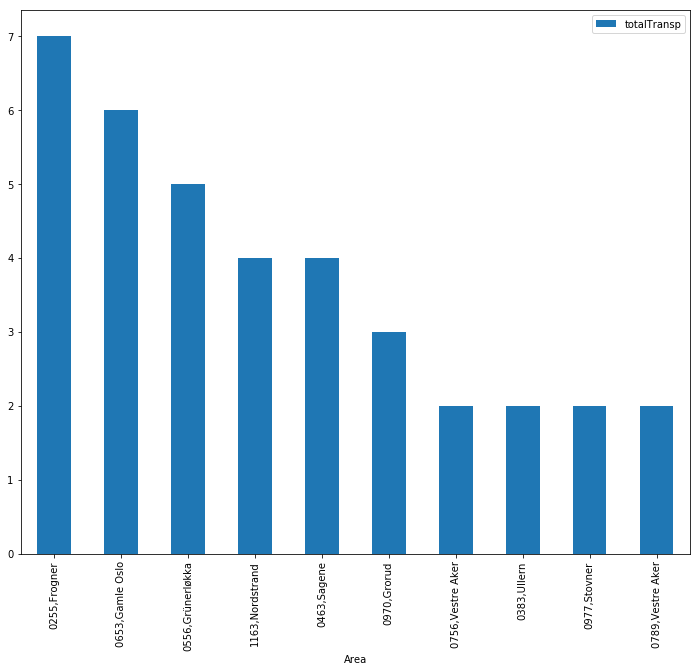

In [2030]:
df_small[['totalTransp']].plot(kind = 'bar', figsize = (12,10)) #width, height

## Path ahead

* Plot top 5 areas with most + bottom 5 area with least transport options
* Obtain data for T-Bane and merge with the clean data
* Repeat analysis for Street Level data  
 - Obtain Trikk
 - Obtain Buss + Clean
 - Obtain T-Bane & merge with above
 - Plot top 5 and bottom 5 areas
 

### Top 5 and bottom 5 areas in terms of transport options

In [2048]:
osloTrikkBussClean.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,...,14,15,16,17,18,19,20,21,22,23
0,0463,Sagene,59.9377,10.7552,NaN,NaN,Buss 54,Buss 20,None,None,...,None,None,None,None,None,None,None,None,None,None
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0,Buss 75A,None,None,None,...,None,None,None,None,None,None,None,None,None,None
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0,Buss 25,46 Bussen,None,None,...,None,None,None,None,None,None,None,None,None,None
4,0970,Grorud,59.9638,10.8961,NaN,NaN,Buss 302,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [ ]:
#Obtain sum of transport options based on col4, col6:col23

In [2049]:
osloTrikkBussClean.notnull().sum(axis = 'columns').sort_values(ascending = False)-4 #Sort in descending order of non-null values i.e. highest transport to lowest

#Also store this in a new coln named totalTransport
osloTrikkBussClean['Total Transport']= osloTrikkBussClean.notnull().sum(axis = 'columns').sort_values(ascending = False)-4#Subtract -4 for the first 4 colns that are not about transport

In [2050]:
newIndex = osloTrikkBussClean.notnull().sum(axis = 'columns').sort_values(ascending = False).index #Obtain index
newIndex

Int64Index([306, 261, 359,  25, 259, 331, 301, 352, 207,  36,
            ...
            225, 224, 223, 440, 214, 213, 212, 210, 209, 220],
           dtype='int64', length=442)

In [2051]:
osloTrikkBussClean.index.values

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [2230]:
#Attempt to change old index to new custom ordered index
#osloTrikkBussClean_small.index = newIndex
orderedTrikkBuss = osloTrikkBussClean.iloc[newIndex,]

#Get range for the index values
manualIndex2 = range(orderedTrikkBuss.shape[0])

#Assign this new index
orderedTrikkBuss.index = manualIndex2
orderedTrikkBuss.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,Total Transport
0,0184,Sentrum,59.9136,10.7525,Jernbanetorget (Trikk/B),204.0,Buss 30,Buss 54,Buss 54,Buss 34,Buss 31,Busd 34,Buss 70,Buss 252,Buss 143,buss 500,Bus4you,Buss 31 E,Buss 82E,Buss 111,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Platform 12 Oslo Bus Terminal,Konkurenten Bus 28,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,81B-Bussen,26
1,0185,Sentrum,59.9118,10.7571,Jernbanetorget (Trikk/B),398.0,buss 500,Bus4you,Platform 12 Oslo Bus Terminal,Bus4You to Gothenburg,platform 29 oslo bussterminal,Platform 14 Oslo Bus Terminal,Buss 252,Buss 490E,Buss 30,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,Buss 70,550 Oslo Bussterminal - Lillestrøm,Buss 143,Buss 34,Busd 34,Buss 54,Konkurenten Bus 28,Plattform 18 - Buss 411 Lillestrøm,Buss 54,Buss 31,Buss 542 Seiersten Ekspress,plattform 20-Buss 501 enebakk-Lillestrøm,Buss 31 E,None,25
2,0050,Sentrum,59.9129,10.7522,Jernbanetorget (Trikk/B),141.0,Buss 30,Buss 34,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Buss 143,Buss 31,Buss 31 E,buss 500,Bus4you,Buss 82E,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Konkurenten Bus 28,Platform 12 Oslo Bus Terminal,Buss 111,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,None,None,24
3,0154,Sentrum,59.9115,10.7475,Jernbanetorget (Trikk/B),163.0,Buss 542 Seiersten Ekspress,Buss 542 Til Drøbak,Buss 31 E,Buss 82E,Buss 30,Buss 34,Buss 32,Buss 143,Buss 83,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Konkurenten Bus 28,Buss 37,Buss 31,81B-Bussen,81A-bussen,Om My Way To Vibeke (bus31),None,None,None,None,22
4,0155,Sentrum,59.9129,10.7483,Jernbanetorget (Trikk/B),120.0,Buss 54,Buss 31 E,Buss 30,Buss 34,Buss 54,Buss 31,Busd 34,Buss 542 Til Drøbak,Buss 37,Buss 82E,Buss 143,Buss 542 Seiersten Ekspress,Buss 70,Buss 252,Buss 83,81B-Bussen,81A-bussen,None,None,None,None,None,None,None,19


In [2057]:
#Observe postcodes with least amount of transport options
print ('A total of ',orderedTrikkBuss[orderedTrikkBuss['Total Transport'] < 1].shape[0],'postcodes don\'t seem to have any tranposrt options!')

A total of  168 postcodes don't seem to have any tranposrt options!


In [2058]:
#Plot top 5 postcodes with most number of transport options
orderedTrikkBuss_top5 = orderedTrikkBuss[['Postcode','Bydel','Total Transport']].head()
orderedTrikkBuss_top5

,Postcode,Bydel,Total Transport
0,0184,Sentrum,26
1,0185,Sentrum,25
2,0050,Sentrum,24
3,0154,Sentrum,22
4,0155,Sentrum,19


In [2095]:
#Change row index to a custom index of postcode+bydel to make plotting easier
orderedTrikkBuss_top5['Area'] = orderedTrikkBuss_top5['Postcode'].astype('str')+',' + orderedTrikkBuss_top5['Bydel']

#Make this new column the new row index
orderedTrikkBuss_top5.index = orderedTrikkBuss_top5['Area']

#Drop the Area column
orderedTrikkBuss_top5.drop('Area', axis = 'columns', inplace = True)
orderedTrikkBuss_top5

,Postcode,Bydel,Total Transport
Area,,,
"0184,Sentrum",0184,Sentrum,26
"0185,Sentrum",0185,Sentrum,25
"0050,Sentrum",0050,Sentrum,24
"0154,Sentrum",0154,Sentrum,22
"0155,Sentrum",0155,Sentrum,19


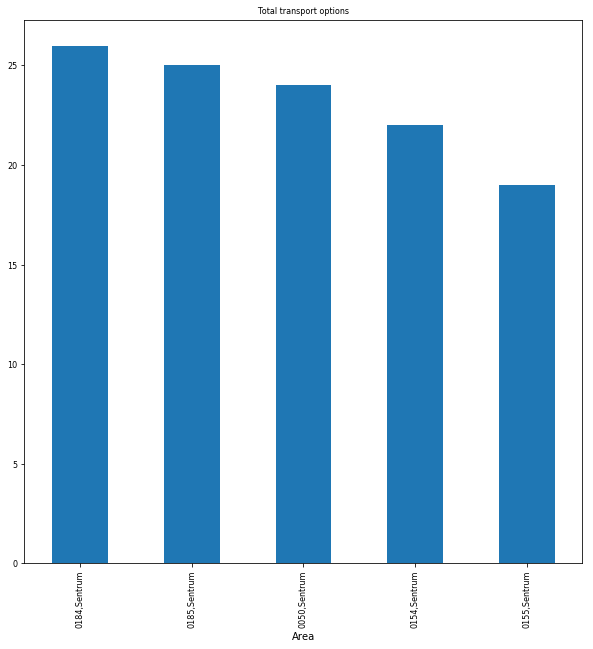

In [2096]:
#Plot
orderedTrikkBuss_top5['Total Transport'].plot(kind = 'bar', figsize = (10,10), title = 'Total transport options')

In [2091]:
#Try plotting with seaborn
import seaborn as sns

In [2097]:
#Reset index, as with seaborn the Area can be the column name
orderedTrikkBuss_top5.reset_index(inplace = True)
orderedTrikkBuss_top5

,Area,Postcode,Bydel,Total Transport
0,"0184,Sentrum",0184,Sentrum,26
1,"0185,Sentrum",0185,Sentrum,25
2,"0050,Sentrum",0050,Sentrum,24
3,"0154,Sentrum",0154,Sentrum,22
4,"0155,Sentrum",0155,Sentrum,19


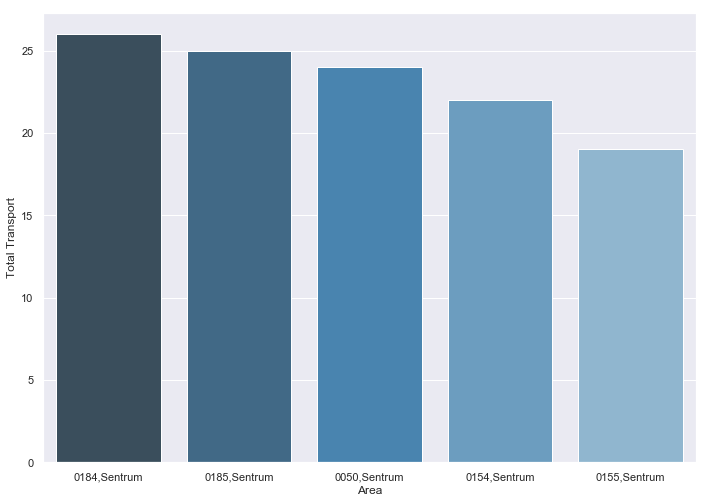

In [2108]:
#sns.set(rc={'figure.figsize':(12,9)})

bar = sns.barplot(x='Area', 
                  y = 'Total Transport', 
                  data = orderedTrikkBuss_top5, 
                  palette = 'Blues_d')

### Attempt clustering, just to make sure things are working as intended

In [2130]:
#Since we have many categorical variable columns, we need to perform one-hot encoding on each of them
#Especially Venue + cols0 till end

#First, we must find a way to select those columns
TransCols =  list(range(24))#Create list of cols numbered 0 -> 23 #range is an ITERATOR in Python 3.x, so must convert to list
TransCols.insert(0, 'Venue')#Insert Venue
TransCols
orderedTrikkBuss[TransCols].head()
#orderedTrikkBuss[['Venue']].head()#,np.arange(23)].head()
#osloOneHot = pd.get_dummies(orderedTrikkBuss[['Venue']])

,Venue,0,1,2,3,4,5,6,7,8,...,14,15,16,17,18,19,20,21,22,23
0,Jernbanetorget (Trikk/B),Buss 30,Buss 54,Buss 54,Buss 34,Buss 31,Busd 34,Buss 70,Buss 252,Buss 143,...,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Platform 12 Oslo Bus Terminal,Konkurenten Bus 28,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,81B-Bussen
1,Jernbanetorget (Trikk/B),buss 500,Bus4you,Platform 12 Oslo Bus Terminal,Bus4You to Gothenburg,platform 29 oslo bussterminal,Platform 14 Oslo Bus Terminal,Buss 252,Buss 490E,Buss 30,...,Busd 34,Buss 54,Konkurenten Bus 28,Plattform 18 - Buss 411 Lillestrøm,Buss 54,Buss 31,Buss 542 Seiersten Ekspress,plattform 20-Buss 501 enebakk-Lillestrøm,Buss 31 E,None
2,Jernbanetorget (Trikk/B),Buss 30,Buss 34,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Buss 143,Buss 31,...,Buss 542 Seiersten Ekspress,Konkurenten Bus 28,Platform 12 Oslo Bus Terminal,Buss 111,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,None,None
3,Jernbanetorget (Trikk/B),Buss 542 Seiersten Ekspress,Buss 542 Til Drøbak,Buss 31 E,Buss 82E,Buss 30,Buss 34,Buss 32,Buss 143,Buss 83,...,Konkurenten Bus 28,Buss 37,Buss 31,81B-Bussen,81A-bussen,Om My Way To Vibeke (bus31),None,None,None,None
4,Jernbanetorget (Trikk/B),Buss 54,Buss 31 E,Buss 30,Buss 34,Buss 54,Buss 31,Busd 34,Buss 542 Til Drøbak,Buss 37,...,Buss 83,81B-Bussen,81A-bussen,None,None,None,None,None,None,None


In [2135]:
#Attempt one hot encoding
pd.set_option('display.max_columns', None) #Set NO limits to number of columns on display

#One-hot encode
oneHot = pd.get_dummies(orderedTrikkBuss[TransCols], prefix='', prefix_sep= '')
oneHot.head()

,Biermanns Gate (trikk),Birkelunden (trikk),Bislett (trikk),Briskeby (trikk),Carl Berners plass (Trikk),Disen (trikk),Dronningens gate (trikk & B),Forskningsparken (trikk),Frogner Plass (trikk),Frydenlund (Trikk),Furulund (trikk),Grefsenplatået (trikk),Grefsenveien (trikk),Hoff (trikk),Jernbanetorget (Trikk/B),Jernbanetorget Eurparådets Plass (trikk),John Colletts plass (trikk),Kastellet (trikk),Kjelsåsalleen (trikk),Lakkegata skole (trikk & B),Lilleaker (trikk),Ljabru (trikk & B),Majorstuen (trikk & B),Munkegata (trikk & B),Nationaltheatret (trikk & B),Nobels gate (trikk),Nydalen (trikk),Rosenhoff (trikk og buss),Sandaker Senter (trikk),Schous Plass (trikk),Skøyen (trikk),Sofienberg (trikk),Solli Plass (trikk),Sportsplassen (trikk),St. Halvards plass (trikk & B),Stensgata (trikk),Storo (trikk),Sæter (trikk),Thune (trikk),Tinghuset (trikk),Torshov (trikk),Trikk 11,Trikk 12,Trikk 13,Trikk 17,Trikk 18,Trikk 19,Ullern (trikk),Ullevål Stadion (trikk),Ullevål Sykehus (trikk),Universitetet Blindern (trikk),Vigelandsparken (trikk),Vikatorvet (trikk),143 Oslo Bussterminal,166-bussen mot Oslo S,20-bussen,20-bussenstoppet,242-bussen,25-bussen,"30-bussen, på Tøyen",31-bussen,32-bussen mot Kværnerbyen,321 Oslo Bussterminal,331 Bussen mot Maura,37 Buss Nydalen,401 Oslo Bussterminal - Kjeller,46 Bussen,"46-bussen, Ullerntoppen",482-bussen Oslo-Bjørkelangen,60-bussen mann,80E Bussen,Abildsø 73 Bussen,Bus 111 Majorstuen o/ Stortorvet,Bus 18 Stop,Buss #24,Buss #45,Buss 100,Buss 111,Buss 119,Buss 131,Buss 142,Buss 169 til Lierbyen,Buss 20,Buss 200 til Hønefoss,Buss 21,Buss 22 Majorstuen,Buss 25,Buss 251 Slemmestad - Oslo,Buss 28,Buss 30,Buss 302,Buss 31,Buss 31E Fornebu Ekspress,Buss 32,Buss 321,Buss 33,Buss 34,Buss 35,Buss 37 Helsfyr,Buss 401,Buss 41,Buss 411 Oslo bussterminal,Buss 42 Kolsås,Buss 431,Buss 45,Buss 46,Buss 490E,Buss 51,Buss 515,Buss 54,Buss 542 Seiersten Ekspress,Buss 542 Til Drøbak,Buss 55 B,Buss 56 Nydalen,Buss 57,Buss 58,Buss 5C,Buss 60,Buss 64B,Buss 64a (Buss 64A),Buss 65,Buss 66,Buss 74,Buss 75A,Buss 76,Buss 76 (Kantarellen - Hauketo),Buss 77 (Holmlia - Bjørndal),Buss 78B,Buss 79,Buss 79 Grorud T,Buss 80E,Buss 80e,Buss 83,Buss 83 Tårnåsen,Buss 85,Manglerud Bussholdeplass (Ring 3),Pauseplass buss 25,R10 - Oslo - Lillehammer - Buss for tog,Smestad (Buss 23),Underveis med 34 bussen,Underveis med 74 Bussen,buss 500,143 Oslo Bussterminal,20-bussen,20-bussenstoppet,242-bussen,"30-bussen, på Tøyen",31 bussjävel,31-bussen,331 Bussen mot Maura,345 bussen (vardefjellet),401 Oslo Bussterminal,46 Bussen,"46-bussen, Ullerntoppen",482-bussen Oslo-Bjørkelangen,60-bussen mann,66 bussen (helsfyr),78 Bussen,Bus 18 Stop,Bus4you,Buss 100,Buss 119,Buss 131,Buss 151,Buss 151 Oslo Bussterminal,Buss 169 til Lierbyen,Buss 20,Buss 200 til Hønefoss,Buss 21,Buss 28 Helsfyr-Fornebu,Buss 30,Buss 301,Buss 31,Buss 31 E,Buss 31E Tonsenhagen,Buss 32,Buss 321,Buss 33,Buss 34,Buss 35,Buss 415 Nesåsen ekspress,Buss 431,Buss 45,Buss 490E,Buss 54,Buss 542 Til Drøbak,Buss 55 B,Buss 56 Solemskogen,Buss 57,Buss 60,Buss 65,Buss 66,Buss 68,Buss 70,Buss 73,Buss 77,Buss 77 (Holmlia - Bjørndal),Buss 79,Buss 80,Buss 80E,Buss 82E,Buss 83,Ekeberg Camping Buss 74,Platform 14 Oslo Bus Terminal,132-bussen,143 Oslo Bussterminal,151 Bussen til Rykkinn,163-bussen,166-bussen mot Oslo S,20 Bussen,20-bussen,20-bussenstoppet,"30-bussen, på Tøyen",31-bussen,345 bussen (vardefjellet),411-bussen,46 Bussen,492 Fjerdingby Buss,5B buss for T-bane,60-bussen mann,66 bussen (helsfyr),Busd 34,Buss 131,Buss 142,Buss 21,Buss 251 Slemmestad - Oslo,Buss 30,Buss 301,Buss 31,Buss 31 E,Buss 32,Buss 33,Buss 34,Buss 35,Buss 37,Buss 411 Lillestrøm,Buss 45,Buss 54,Buss 542 Seiersten Ekspress,Buss 65,Buss 66,Buss 75A,Buss 79,Buss 79 Grorud T,Buss 80E,Buss 80e,Buss 83,Buss 83 Tårnåsen,Om My Way To Vibeke (bus31),Platform 12 Oslo Bus Terminal,Platform 14 Oslo Bus Terminal,Plattform 18 - Buss 411 Lillestrøm,buss 500,12 M:stua - Buss for trikk,156-bussen,163-bussen,166-bussen mot Oslo S,20 Bussen,20-bussen,3

In [2132]:
#Check dimensions
oneHot.shape #442 rows, 458 cols

(442, 458)

In [2141]:
#Insert info about Postcode + Bydel

#Create combined column of Postcode + Bydel
oneHot['Area'] = orderedTrikkBuss['Postcode'].astype('str')+','+orderedTrikkBuss['Bydel']

#Bring the column Area to the front i.e. change the position
cols = oneHot.columns.tolist()
cols

#Rearrange such that the last column is the first column
cols = cols[-1:] + cols[:-1]
cols

#Put the new order back
oneHot = oneHot[cols]
oneHot.head()



Area  Biermanns Gate (trikk)  Birkelunden (trikk)  Bislett (trikk)  \
0  0184,Sentrum                       0                    0                0   
1  0185,Sentrum                       0                    0                0   
2  0050,Sentrum                       0                    0                0   
3  0154,Sentrum                       0                    0                0   
4  0155,Sentrum                       0                    0                0   

   Briskeby (trikk)  Carl Berners plass (Trikk)  Disen (trikk)  \
0                 0                           0              0   
1                 0                           0              0   
2                 0                           0              0   
3                 0                           0              0   
4                 0                           0              0   

   Dronningens gate (trikk & B)  Forskningsparken (trikk)  \
0                             0                         0   
1                             0                         0   
2                             0                         0   
3                             0                         0   
4                             0                         0   

   Frogner Plass (trikk)  Frydenlund (Trikk)  Furulund (trikk)  \
0                      0                   0                 0   
1                      0                   0                 0   
2                      0                   0                 0   
3                      0                   0                 0   
4                      0                   0                 0   

   Grefsenplatået (trikk)  Grefsenveien (trikk)  Hoff (trikk)  \
0                       0                     0             0   
1                       0                     0             0   
2                       0                     0             0   
3                       0                     0             0   
4                       0                     0             0   

   Jernbanetorget (Trikk/B)  Jernbanetorget Eurparådets Plass (trikk)  \
0                         1                                         0   
1                         1                                         0   
2                         1                                         0   
3                         1                                         0   
4                         1                                         0   

   John Colletts plass (trikk)  Kastellet (trikk)  Kjelsåsalleen (trikk)  \
0                            0                  0                      0   
1                            0                  0                      0   
2                            0                  0                      0   
3                            0                  0                      0   
4                            0                  0                      0   

   Lakkegata skole (trikk & B)  Lilleaker (trikk)  Ljabru (trikk & B)  \
0                            0                  0                   0   
1                            0                  0                   0   
2                            0                  0                   0   
3                            0                  0                   0   
4                            0                  0                   0   

   Majorstuen (trikk & B)  Munkegata (trikk & B)  \
0                       0                      0   
1                       0                      0   
2                       0                      0   
3                       0                      0   
4                       0                      0   

   Nationaltheatret (trikk & B)  Nobels gate (trikk)  Nydalen (trikk)  \
0                             0                    0                0   
1                             0                    0                0   
2                             0                    0                0   
3                             0 

In [2159]:
#Import module
from sklearn.cluster import KMeans

#Create object
kclusters = 5
kmClust = KMeans(n_clusters= kclusters, init='k-means++', n_init= 15, random_state= 1)

#Fit the object
kmLabels = kmClust.fit(oneHot.drop(['Area'], axis = 'columns'))

In [2160]:
#Check labels
kmLabels.labels_[0:10]

array([3, 4, 1, 2, 1, 1, 1, 1, 0, 1], dtype=int32)

In [2163]:
#Add cluster labels back into the dataframe
oneHot.insert(1, 'Cluster', kmLabels.labels_)
#oneHot.drop('Cluster', inplace = True, axis= 'columns') #For correcting a wrongly added info/If it exists already, e.g. while re-running
oneHot.head()

Area  Cluster  Biermanns Gate (trikk)  Birkelunden (trikk)  \
0  0184,Sentrum        3                       0                    0   
1  0185,Sentrum        4                       0                    0   
2  0050,Sentrum        1                       0                    0   
3  0154,Sentrum        2                       0                    0   
4  0155,Sentrum        1                       0                    0   

   Bislett (trikk)  Briskeby (trikk)  Carl Berners plass (Trikk)  \
0                0                 0                           0   
1                0                 0                           0   
2                0                 0                           0   
3                0                 0                           0   
4                0                 0                           0   

   Disen (trikk)  Dronningens gate (trikk & B)  Forskningsparken (trikk)  \
0              0                             0                         0   
1              0                             0                         0   
2              0                             0                         0   
3              0                             0                         0   
4              0                             0                         0   

   Frogner Plass (trikk)  Frydenlund (Trikk)  Furulund (trikk)  \
0                      0                   0                 0   
1                      0                   0                 0   
2                      0                   0                 0   
3                      0                   0                 0   
4                      0                   0                 0   

   Grefsenplatået (trikk)  Grefsenveien (trikk)  Hoff (trikk)  \
0                       0                     0             0   
1                       0                     0             0   
2                       0                     0             0   
3                       0                     0             0   
4                       0                     0             0   

   Jernbanetorget (Trikk/B)  Jernbanetorget Eurparådets Plass (trikk)  \
0                         1                                         0   
1                         1                                         0   
2                         1                                         0   
3                         1                                         0   
4                         1                                         0   

   John Colletts plass (trikk)  Kastellet (trikk)  Kjelsåsalleen (trikk)  \
0                            0                  0                      0   
1                            0                  0                      0   
2                            0                  0                      0   
3                            0                  0                      0   
4                            0                  0                      0   

   Lakkegata skole (trikk & B)  Lilleaker (trikk)  Ljabru (trikk & B)  \
0                            0                  0                   0   
1                            0                  0                   0   
2                            0                  0                   0   
3                            0                  0                   0   
4                            0                  0                   0   

   Majorstuen (trikk & B)  Munkegata (trikk & B)  \
0                       0                      0   
1                       0                      0   
2                       0                      0   
3                       0                      0   
4                       0                      0   

   Nationaltheatret (trikk & B)  Nobels gate (trikk)  Nydalen (trikk)  \
0                             0                    0                0   
1                             0                    0                0   
2                             0                    

#### 12. Visualise k-means clusters

In [2164]:
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

#Make map object
map_cluster = folium.Map(location=[latitude, longitude], zoom_start=12)


# set color scheme for the clusters
x = np.arange(kclusters)#kclusters
ys = [i + x + (i*x)**2 for i in range(kclusters)]#kclusters
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to map
markers_colors = []
for lat, lng, area, cluster in zip(orderedTrikkBuss['Postcode Latitude'], orderedTrikkBuss['Postcode Longitude'],
                                   oneHot['Area'], oneHot['Cluster'].astype('int')):
    
    #Create pop-up label to display
    #label = '{}, {}'.format(postcode, district)#neighborhood, borough originally
    #label = folium.Popup(label, parse_html=True)
    #folium.CircleMarker(
        #[lat, lng],
        #radius=3,#Change radius of circle marker
        #popup=label,
        #color='blue',
        #fill=False,
        #fill_color='#3186cc',
        #fill_opacity=0.7,
        #parse_html=False).add_to(map_oslo)  
    
#map_oslo


    label = folium.Popup(str(area) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_cluster)
       
map_cluster

The above, while informative, does not seem to suit the end goal of clustering based on number of transport options.  
So the next idea, would be to instead of clustering on categorical, cluster on total transport options

### Attempt at clustering with Numerical variables

In [2165]:
#We use the orderedTrikkBuss dataset
orderedTrikkBuss.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,Total Transport
0,0184,Sentrum,59.9136,10.7525,Jernbanetorget (Trikk/B),204.0,Buss 30,Buss 54,Buss 54,Buss 34,Buss 31,Busd 34,Buss 70,Buss 252,Buss 143,buss 500,Bus4you,Buss 31 E,Buss 82E,Buss 111,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Platform 12 Oslo Bus Terminal,Konkurenten Bus 28,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,81B-Bussen,26
1,0185,Sentrum,59.9118,10.7571,Jernbanetorget (Trikk/B),398.0,buss 500,Bus4you,Platform 12 Oslo Bus Terminal,Bus4You to Gothenburg,platform 29 oslo bussterminal,Platform 14 Oslo Bus Terminal,Buss 252,Buss 490E,Buss 30,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,Buss 70,550 Oslo Bussterminal - Lillestrøm,Buss 143,Buss 34,Busd 34,Buss 54,Konkurenten Bus 28,Plattform 18 - Buss 411 Lillestrøm,Buss 54,Buss 31,Buss 542 Seiersten Ekspress,plattform 20-Buss 501 enebakk-Lillestrøm,Buss 31 E,None,25
2,0050,Sentrum,59.9129,10.7522,Jernbanetorget (Trikk/B),141.0,Buss 30,Buss 34,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Buss 143,Buss 31,Buss 31 E,buss 500,Bus4you,Buss 82E,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Konkurenten Bus 28,Platform 12 Oslo Bus Terminal,Buss 111,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,None,None,24
3,0154,Sentrum,59.9115,10.7475,Jernbanetorget (Trikk/B),163.0,Buss 542 Seiersten Ekspress,Buss 542 Til Drøbak,Buss 31 E,Buss 82E,Buss 30,Buss 34,Buss 32,Buss 143,Buss 83,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Konkurenten Bus 28,Buss 37,Buss 31,81B-Bussen,81A-bussen,Om My Way To Vibeke (bus31),None,None,None,None,22
4,0155,Sentrum,59.9129,10.7483,Jernbanetorget (Trikk/B),120.0,Buss 54,Buss 31 E,Buss 30,Buss 34,Buss 54,Buss 31,Busd 34,Buss 542 Til Drøbak,Buss 37,Buss 82E,Buss 143,Buss 542 Seiersten Ekspress,Buss 70,Buss 252,Buss 83,81B-Bussen,81A-bussen,None,None,None,None,None,None,None,19


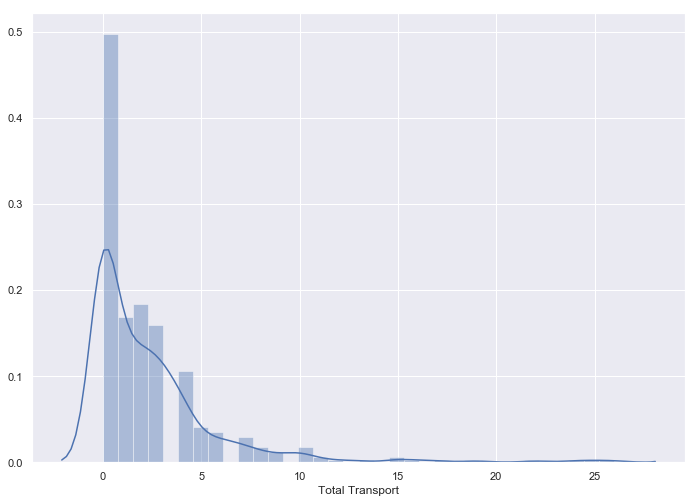

In [2170]:
#Let us make frequency distribution plot/histogram of total transport
#sns.jointplot(x="Postcode", y="Total Transport", data=orderedTrikkBuss)#Scatterplot

sns.distplot(orderedTrikkBuss['Total Transport'])

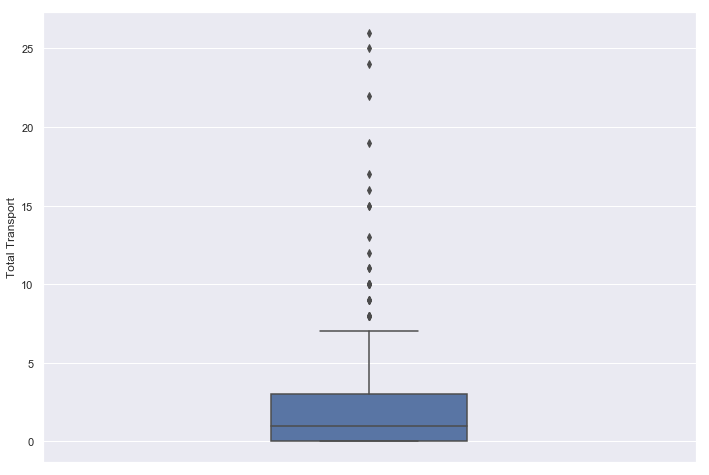

In [2175]:
#Box plot
sns.boxplot(y= orderedTrikkBuss['Total Transport'], width = 0.3)

In [2219]:
#Scatter plot with pandas
dataForScatter = orderedTrikkBuss[['Postcode','Total Transport']]
dataForScatter.dtypes

#Since scatter plots require X axis to be numerical and converting postcodes to int seem to generate a bit weird data, we will make row index = column
dataForScatter.index.name = 'Postcode,sorted'
dataForScatter.head()

#Reset index
dataForScatter.reset_index(inplace = True)
dataForScatter.head()
#dataForScatter['Postcode'] = dataForScatter['Postcode'].astype('int')
#dataForScatter.dtypes

#dataForScatter.head()

,"Postcode,sorted",Postcode,Total Transport
0,0,0184,26
1,1,0185,25
2,2,0050,24
3,3,0154,22
4,4,0155,19


In [2184]:
dataForScatter.shape

(442, 2)

In [2187]:
#dataForScatter.index.values

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


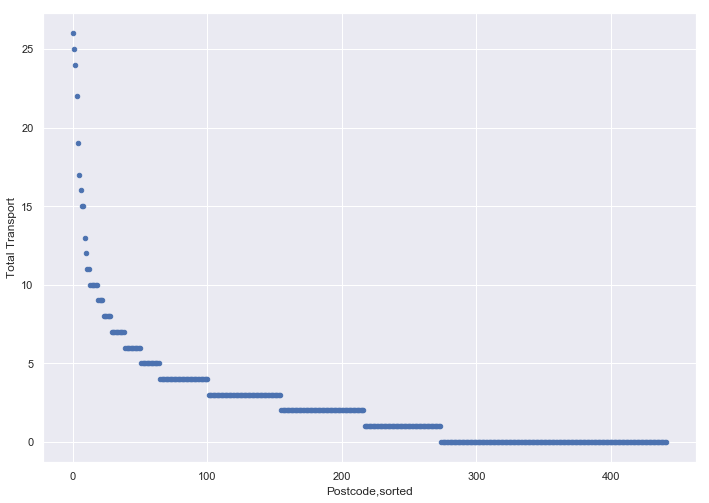

In [2193]:
dataForScatter.plot(kind = 'scatter',
                   x = 'Postcode,sorted',
                   y = 'Total Transport')

In [2194]:
#Testing how k-means clustering would work on numerical data
from sklearn.datasets.samples_generator import make_blobs
X, y_true = make_blobs(n_samples=300, centers=4,
                       cluster_std=0.60, random_state=0)
X.shape

(300, 2)

In [2197]:
type(X) #It is an array of tuples

numpy.ndarray

In [2205]:
X[0:5]

array([[ 0.83685684,  2.13635938],
       [-1.4136581 ,  7.40962324],
       [ 1.15521298,  5.09961887],
       [-1.01861632,  7.81491465],
       [ 1.27135141,  1.89254207]])

In [2207]:
#Accessing 1st element in the tuple
X[0][0]

0.8368568407639814

In [2208]:
#Accessing 2nd element in tuple
X[0][1]

2.1363593767535285

In [2209]:
#Accessing series of 1st elements
X[0:5, 0]

array([ 0.83685684, -1.4136581 ,  1.15521298, -1.01861632,  1.27135141])

In [2210]:
#Accessing series of 2nd elements
X[0:5,1]

array([2.13635938, 7.40962324, 5.09961887, 7.81491465, 1.89254207])

In [2220]:
#Import module
from sklearn.cluster import KMeans

#Create object
kclusters = 5
kmClust = KMeans(n_clusters= kclusters, init='k-means++', n_init= 15, random_state= 1)

#Fit the object
kmLabels2 = kmClust.fit(dataForScatter.drop(['Postcode,sorted','Postcode'], axis = 'columns'))

In [2221]:
#Check labels
kmLabels2.labels_[0:10]

array([1, 1, 1, 1, 1, 1, 2, 2, 2, 2], dtype=int32)

In [2222]:
#Insert into the dataframe
dataForScatter.insert(1, 'Cluster', kmLabels2.labels_)
dataForScatter.head()

,"Postcode,sorted",Cluster,Postcode,Total Transport
0,0,1,0184,26
1,1,1,0185,25
2,2,1,0050,24
3,3,1,0154,22
4,4,1,0155,19


In [2223]:
dataForScatter.tail()

,"Postcode,sorted",Cluster,Postcode,Total Transport
437,437,4,0958,0
438,438,4,0752,0
439,439,4,0969,0
440,440,4,0972,0
441,441,4,0960,0


In [2224]:
dataForScatter

,"Postcode,sorted",Cluster,Postcode,Total Transport
0,0,1,0184,26
1,1,1,0185,25
2,2,1,0050,24
3,3,1,0154,22
4,4,1,0155,19
5,5,1,0152,17
6,6,2,0188,16
7,7,2,0186,15
8,8,2,0181,15
9,9,2,0191,13


So in theory, clustering directly on the **total transport** options should work.  
Just make sure the clustering is done ONLY on the column of _total transport_ and drop the _other columns_

In [2231]:
orderedTrikkBuss.head() 

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,Total Transport
0,0184,Sentrum,59.9136,10.7525,Jernbanetorget (Trikk/B),204.0,Buss 30,Buss 54,Buss 54,Buss 34,Buss 31,Busd 34,Buss 70,Buss 252,Buss 143,buss 500,Bus4you,Buss 31 E,Buss 82E,Buss 111,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Platform 12 Oslo Bus Terminal,Konkurenten Bus 28,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,81B-Bussen,26
1,0185,Sentrum,59.9118,10.7571,Jernbanetorget (Trikk/B),398.0,buss 500,Bus4you,Platform 12 Oslo Bus Terminal,Bus4You to Gothenburg,platform 29 oslo bussterminal,Platform 14 Oslo Bus Terminal,Buss 252,Buss 490E,Buss 30,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,Buss 70,550 Oslo Bussterminal - Lillestrøm,Buss 143,Buss 34,Busd 34,Buss 54,Konkurenten Bus 28,Plattform 18 - Buss 411 Lillestrøm,Buss 54,Buss 31,Buss 542 Seiersten Ekspress,plattform 20-Buss 501 enebakk-Lillestrøm,Buss 31 E,None,25
2,0050,Sentrum,59.9129,10.7522,Jernbanetorget (Trikk/B),141.0,Buss 30,Buss 34,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Buss 143,Buss 31,Buss 31 E,buss 500,Bus4you,Buss 82E,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Konkurenten Bus 28,Platform 12 Oslo Bus Terminal,Buss 111,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,None,None,24
3,0154,Sentrum,59.9115,10.7475,Jernbanetorget (Trikk/B),163.0,Buss 542 Seiersten Ekspress,Buss 542 Til Drøbak,Buss 31 E,Buss 82E,Buss 30,Buss 34,Buss 32,Buss 143,Buss 83,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Konkurenten Bus 28,Buss 37,Buss 31,81B-Bussen,81A-bussen,Om My Way To Vibeke (bus31),None,None,None,None,22
4,0155,Sentrum,59.9129,10.7483,Jernbanetorget (Trikk/B),120.0,Buss 54,Buss 31 E,Buss 30,Buss 34,Buss 54,Buss 31,Busd 34,Buss 542 Til Drøbak,Buss 37,Buss 82E,Buss 143,Buss 542 Seiersten Ekspress,Buss 70,Buss 252,Buss 83,81B-Bussen,81A-bussen,None,None,None,None,None,None,None,19


In [2238]:
#K-means clustering on Total Transport
kclusters = 5

#Create object
kmClust = KMeans(init = 'k-means++', n_clusters = kclusters, n_init= 12, random_state= 1)

#Fit
kmLabels3 = kmClust.fit(orderedTrikkBuss[['Total Transport']])

#Check labels
kmLabels3.labels_[0:6]

array([1, 1, 1, 1, 1, 3], dtype=int32)

In [2244]:
#Insert into dataframe of ordered bus trikk
#orderedTrikkBuss.insert(4, 'Cluster', kmLabels3.labels_)
orderedTrikkBuss.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Cluster,Venue,Venue Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,Total Transport
0,0184,Sentrum,59.9136,10.7525,1,Jernbanetorget (Trikk/B),204.0,Buss 30,Buss 54,Buss 54,Buss 34,Buss 31,Busd 34,Buss 70,Buss 252,Buss 143,buss 500,Bus4you,Buss 31 E,Buss 82E,Buss 111,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Platform 12 Oslo Bus Terminal,Konkurenten Bus 28,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,81B-Bussen,26
1,0185,Sentrum,59.9118,10.7571,1,Jernbanetorget (Trikk/B),398.0,buss 500,Bus4you,Platform 12 Oslo Bus Terminal,Bus4You to Gothenburg,platform 29 oslo bussterminal,Platform 14 Oslo Bus Terminal,Buss 252,Buss 490E,Buss 30,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,Buss 70,550 Oslo Bussterminal - Lillestrøm,Buss 143,Buss 34,Busd 34,Buss 54,Konkurenten Bus 28,Plattform 18 - Buss 411 Lillestrøm,Buss 54,Buss 31,Buss 542 Seiersten Ekspress,plattform 20-Buss 501 enebakk-Lillestrøm,Buss 31 E,None,25
2,0050,Sentrum,59.9129,10.7522,1,Jernbanetorget (Trikk/B),141.0,Buss 30,Buss 34,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Buss 143,Buss 31,Buss 31 E,buss 500,Bus4you,Buss 82E,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Konkurenten Bus 28,Platform 12 Oslo Bus Terminal,Buss 111,Platform 14 Oslo Bus Terminal,Bus4You to Gothenburg,Buss 37,platform 29 oslo bussterminal,None,None,24
3,0154,Sentrum,59.9115,10.7475,1,Jernbanetorget (Trikk/B),163.0,Buss 542 Seiersten Ekspress,Buss 542 Til Drøbak,Buss 31 E,Buss 82E,Buss 30,Buss 34,Buss 32,Buss 143,Buss 83,Busd 34,Buss 70,Buss 54,Buss 54,Buss 252,Konkurenten Bus 28,Buss 37,Buss 31,81B-Bussen,81A-bussen,Om My Way To Vibeke (bus31),None,None,None,None,22
4,0155,Sentrum,59.9129,10.7483,1,Jernbanetorget (Trikk/B),120.0,Buss 54,Buss 31 E,Buss 30,Buss 34,Buss 54,Buss 31,Busd 34,Buss 542 Til Drøbak,Buss 37,Buss 82E,Buss 143,Buss 542 Seiersten Ekspress,Buss 70,Buss 252,Buss 83,81B-Bussen,81A-bussen,None,None,None,None,None,None,None,19


In [2241]:
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

#Make map object
map_cluster = folium.Map(location=[latitude, longitude], zoom_start=11)


# set color scheme for the clusters
x = np.arange(kclusters)#kclusters
ys = [i + x + (i*x)**2 for i in range(kclusters)]#kclusters
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to map
markers_colors = []
for lat, lng, post, district, cluster in zip(orderedTrikkBuss['Postcode Latitude'], orderedTrikkBuss['Postcode Longitude'],
                                   orderedTrikkBuss['Postcode'], orderedTrikkBuss['Bydel'], orderedTrikkBuss['Cluster'].astype('int')):
    

    label = folium.Popup(str(post) + str(district) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_cluster)
       
map_cluster

So, in theory, our idea **FINALLY WORKS!!!**

### Extract T-bane info

In [839]:
#2.1.1 Set up Foursquare credentials
CLIENT_ID = 'BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK'#'your-client-ID' # your Foursquare ID
CLIENT_SECRET = 'DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ'#'your-client-secret' # your Foursquare Secret
VERSION = '20190605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)


Your credentails:
CLIENT_ID: BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK
CLIENT_SECRET:DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ


In [291]:
#To SEARCH particular type of location (not EXPLORE, search means find, explore means : more about specific location)

#https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={}&v={}&query={}&radius={}

In [2351]:
#2.1.2 Obtain info about first postcode
data.iloc[240:247,]

,Postcode,Bydel/District,Latitude,Longitude
240,1062,Alna,59.9368,10.9127
241,0158,Sentrum,59.9120,10.7390
242,1294,Søndre Nordstrand,59.8214,10.8631
243,0192,Gamle Oslo,59.9043,10.7717
244,0452,St.Hanshaugen,59.9300,10.7346
245,1254,Søndre Nordstrand,59.8370,10.7880
246,0860,Nordre Aker,59.9601,10.7340


In [2246]:
#2.1.3 Extract lat, long
postLat = float(data.iloc[0, 2])#Must convert to float otherwise error later
postLon = float(data.iloc[0, 3])
area = data.iloc[0,1]
print(area, postLat, postLon)

Sagene 59.9377 10.7552


In [2376]:
#2.1.3 Extract lat, long
postLat = float(data.iloc[301, 2])#Must convert to float otherwise error later
postLon = float(data.iloc[301, 3])
area = data.iloc[301,1]
print(area, postLat, postLon)

Gamle Oslo 59.9126 10.7608


In [2392]:
#2.1.4 Build the url
radius = 400
query = 'T-bane'#'Metro Station was not giving me the results
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.\
    format(CLIENT_ID, CLIENT_SECRET,postLat, postLon,VERSION,query,radius)
print(url)

https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9126,10.7608&v=20190605&query=T-bane&radius=400


In [2393]:
#2.1.5 Send GET request and examine results
import requests
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5d2c7db70d2be7002c5d02e1'},
 'response': {'venues': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/subway_',
       'suffix': '.png'},
      'id': '4bf58dd8d48988d1fd931735',
      'name': 'Metro Station',
      'pluralName': 'Metro Stations',
      'primary': True,
      'shortName': 'Metro'}],
    'hasPerk': False,
    'id': '4b1415d2f964a5200f9d23e3',
    'location': {'address': 'Grønland',
     'cc': 'NO',
     'city': 'Oslo',
     'country': 'Norge',
     'distance': 32,
     'formattedAddress': ['Grønland', '0188 Oslo', 'Norge'],
     'labeledLatLngs': [{'label': 'display',
       'lat': 59.91266177233612,
       'lng': 10.7613601229046}],
     'lat': 59.91266177233612,
     'lng': 10.7613601229046,
     'postalCode': '0188',
     'state': 'Oslo'},
    'name': 'Grønland (T)',
    'referralId': 'v-1563196856'},
   {'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/medical_de

In [2355]:
#print('https://foursquare.com/explore?mode=url&ne=59.943104%2C10.760057&q=Metro%20Station&sw=59.927603%2C10.727484')
#Answers should be in 'response': {'venues': []} or response': {'venues': [{'categories': 

In [2394]:
#results['response']['venues'][4]

In [2395]:
for i in results['response']['venues']:
    print('\n<<<<<<<<Element>>>>>>>>>>')
    
    #print(i)
    #if re.search('Metro', i['categories'][0]['shortName']):
    #print(i['categories']) #Some have blank categories
    #print(len(i['categories']))
    
    if (len(i['categories']) > 0) and (i['categories'][0]['shortName'] == 'Metro'):
        print('yay')
        print(i['name'])
        print(i['location']['distance'])
        print(i['categories'][0]['shortName'])
    else:
        print('nay')


<<<<<<<<Element>>>>>>>>>>
yay
Grønland (T)
32
Metro

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay


In [2396]:
#4 Now try to save the above results into a dictionary
import re
#venues = results['response']['groups'][0]['items']
#try:
places = results['response']['venues']
#print(places)

#if(places[0]['name'] == 'Buss 75A'):
    #print(places[0]['name'])
print('Length:',len(places))
metroDict = dict()

if len(places) > 0:     
            
    for i in results['response']['venues']:
        print('\n<<<<<<<<Element>>>>>>>>>>')
    
        if (len(i['categories']) > 0) and (i['categories'][0]['shortName'] == 'Metro'):
            print('yay')
            print(i['name'])#Name of the Metro stop
            print(i['location']['distance'])#Distance of the metro stop
            print(i['categories'][0]['shortName'])
            metroDict[ i['location']['distance']] = i['name']
        else:
            print('nay')
        
        
elif len(places) == 0:#If GET response is blank
    metroDict['NoDistance'] = 'No Metro station found'
    print('No T-bane stop nearby!')
    


Length: 30

<<<<<<<<Element>>>>>>>>>>
yay
Grønland (T)
32
Metro

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay

<<<<<<<<Element>>>>>>>>>>
nay


In [2397]:
for k,v in metroDict.items():
    print(k,v)

32 Grønland (T)


In [2346]:
#FULL VERSION; CHANGED CODE
# Extend to all postcodes

metroPost = {}
def getMetroNearby (post, bydel, bydelLat, bydelLon, query, radius, count):
    
    for post, bydel, lat, lng in zip(post, bydel, bydelLat, bydelLon):
        count= count+1
        #if count in [ 54,  65,  96, 148, 150, 151, 193, 230, 313, 332, 396, 439]:#Peculiar, blank categories, though some have Bus lines
        #if count in [ 150, 313, 396, 439]:#Peculiar, blank categories/wrong category eg Moving Target, though some have Bus lines
        #if count in [332]:#332 BIG SENTRUM with 19 hits
        #if count in [54,65, 96, 148, 150, 151, 193, 230, 313, 332, 396, 439,360]:#332 SUPER BIG SENTRUM with 30 hits
        #if count in [ 12,  36, 117, 308, 316, 335, 344, 345, 347, 368, 392, 408, 423]:
        print('\n',post,'\t',bydel,'\t',count)

            # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        #print(url)

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(results)
        
        try:
            places = results['response']['venues']
            print('Number of entries in {} is {}'.format(post,len(places)))
            print(places)
            
            if len(places) > 0:     
            
                for i in results['response']['venues']:
                    #print('\n<<<<<<<<Element>>>>>>>>>>')
                    metroList = list()
                    if (len(i['categories']) > 0) and (i['categories'][0]['shortName'] == 'Metro'):
                        print('yay')
                        print(i['name'])#Name of the Metro stop
                        print(i['location']['distance'])#Distance of the metro stop
                        print(i['categories'][0]['shortName'])
                        #metroPost[ i['location']['distance']] = i['name']
                        metroTuple = i['name'], i['location']['distance']
                        metroList.append(metroTuple)
                        metroPost[post] = metroList
                        
                    else:#If no Metro found
                        metroPost[post] = ''
            else:
                print('nay')
                metroPost[post] = ''
                            
        except:
        #continue
            metroPost[post] = '' #'0'

        
    
#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
getMetroNearby(post=data['Postcode'], #[0:5],#[0:20],
               bydel = data['Bydel/District'], #[0:5],#[0:20],
               bydelLat=data['Latitude'], #[0:5],#[0:20],
               bydelLon=data['Longitude'], #[0:5],#[0:20],
               radius = 400,
               query = 'Metro Station', count = 0
               )   

#Must clean up data!
#Bus station gives Russian Space Station at Grünnerløkka!
#Bus line gives individual businesses like Henriette og something
#Best seems to be Bus Stops...but even then get Zoo! In Majorstua
#For regex: Buss/buss/Bussen/bussen
#Must get: Flaen Buss
#Must NOT: Lille Bussola
#OR
#
#Dig into CATEGORIES> Bus Line/Stop/Station
#Then
#Question: You want bus LINE info or just enough to know there is Bus line/stop/station?
#
#ANS: Since we are interested in clustering AFTER presence/absence of line/station/stop, we dont need LINE INFO


 0463 	 Sagene 	 1
Number of entries in 0463 is 1
[{'name': 'Metronome Spartacus', 'location': {'lng': 10.757591, 'labeledLatLngs': [{'lng': 10.757591, 'label': 'display', 'lat': 59.934504}], 'formattedAddress': ['Sandaker veien 24c', 'Oslo', 'Norge'], 'city': 'Oslo', 'state': 'Oslo', 'country': 'Norge', 'lat': 59.934504, 'distance': 379, 'cc': 'NO', 'address': 'Sandaker veien 24c'}, 'hasPerk': False, 'id': '4c9727d5533aa093da7ed745', 'categories': [{'name': 'Office', 'icon': {'suffix': '.png', 'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/default_'}, 'id': '4bf58dd8d48988d124941735', 'shortName': 'Office', 'primary': True, 'pluralName': 'Offices'}], 'referralId': 'v-1563194684'}]

 1163 	 Nordstrand 	 2
Number of entries in 1163 is 0
[]
nay

 0789 	 Vestre Aker 	 3
Number of entries in 0789 is 0
[]
nay

 0358 	 St.Hanshaugen 	 4
Number of entries in 0358 is 1
[{'name': 'metropolis', 'location': {'lng': 10.727304, 'labeledLatLngs': [{'lng': 10.727304, 'label': 'display', 

JSONDecodeError: Expecting value: line 1 column 1 (char 0)

In [2345]:
for k,v in metroPost.items():
    print(k,v)

0463 
0366 [('Valkyrie plass spøkelsestasjon', 138)]
0789 
0358 
0575 
0556 
0664 
0161 
0455 
0173 
0265 [('Elisenberg spøkelsestasjon', 122)]
0678 
0045 
0282 
0665 
0585 
0956 
0650 
0364 [('Valkyrie plass spøkelsestasjon', 259)]
1156 
1071 
0690 
0350 
0881 
0154 
1166 
0590 
0472 
0681 
0354 
1051 
1151 
0982 
0983 
0666 
0654 
0596 
0191 
0574 
0177 
0470 
0450 
0561 
0253 
0773 
0851 
1154 
0262 [('Elisenberg spøkelsestasjon', 321)]
1176 
1187 
0873 
0382 
0476 
0891 
1262 
0558 
0251 
0880 
0568 
0484 
1157 
0480 
0178 
1253 
0951 
0151 
0566 
0751 
0489 
0679 
0256 
1161 
1286 
0567 
1163 
0693 
0274 
0872 
0689 
0584 
1061 
0669 
0564 
0456 
0174 
0874 
0856 
0963 
0662 
0855 
1087 
0363 [('Valkyrie plass spøkelsestasjon', 256)]
0950 
0589 
1153 
1164 
0586 
0182 
0667 
0260 
1255 
0979 
0758 
0978 
0550 
0757 
0279 
1272 
0375 
0160 
0554 
0175 
0359 
0183 
0594 
0570 
0785 
0671 
0194 
1283 
0477 
0565 
0691 
0150 
0153 
0863 
1188 
1167 
0365 [('Valkyrie plass spøkelsestas

In [2335]:
print('The length of the Metro dictionary is {}'.format(len(metroPost)))

The length of the Metro dictionary is 350


In [2464]:
#SMALL TEST VERSION > UPGRADED TO FULL VERSION NOW
# Extend to all postcodes

metroPost = {}
def getMetroNearby (post, bydel, bydelLat, bydelLon, query, radius, count):
    
    for post, bydel, lat, lng in zip(post, bydel, bydelLat, bydelLon):
        count= count+1
        #if count in [ 54,  65,  96, 148, 150, 151, 193, 230, 313, 332, 396, 439]:#Peculiar, blank categories, though some have Bus lines
        #if count in [ 150, 313, 396, 439]:#Peculiar, blank categories/wrong category eg Moving Target, though some have Bus lines
        #if count in [332]:#332 BIG SENTRUM with 19 hits
        #if count in [54,65, 96, 148, 150, 151, 193, 230, 313, 332, 396, 439,360]:#332 SUPER BIG SENTRUM with 30 hits
        #if count in [ 12,  36, 117, 308, 316, 335, 344, 345, 347, 368, 392, 408, 423]:
        #if count in range(247):
        #if count in [179,180,300,301,302]:
        print('\n',post,'\t',bydel,'\t',count)

            # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(results)
        
        try:
            places = results['response']['venues']
            print('Number of entries in {} is {}'.format(post,len(places)))
                #print(places)
            
            if len(places) > 0:     
                metroList = list()
                for i in results['response']['venues']:
                    #print('\n<<<<<<<<Element>>>>>>>>>>')
                        
                        
                    if (len(i['categories']) > 0) and (i['categories'][0]['shortName'] == 'Metro'):
                        print('yay')
                            #print(i['name'])#Name of the Metro stop
                            #print(i['location']['distance'])#Distance of the metro stop
                            #print(i['categories'][0]['shortName'])
                            #metroPost[ i['location']['distance']] = i['name']
                        
                        metroTuple = i['name'], i['location']['distance']
                        print(metroTuple)
                        metroList.append(metroTuple)
                        metroPost[post] = metroList
                        
                            #Add info to dictionary, if post does not exist already
                            #if post not in metroPost:
                             #Add info as tuple of bus route+distance
                             #   metroList.append((places[i]['name'],places[i]['location']['distance']))
                              #  metroPost[post] = busList #First entry
                                
                            #But if post is already in the dict, append to newMetro, then append to metroList, that automatically changes the dictionary
                            #else:
                             #   newMetro = i['name'],i['location']['distance']
                                #print(type(newBus))
                              #  metroList.append(newMetro)

                        
                        
                        
                    
                    
                    elif (len(i['categories']) > 0) and (i['categories'][0]['shortName'] != 'Metro'):#If the short name is NOT metro
                        #metroPost[post].append('')
                            continue #Just skip and go to the next, DO NOT ASSIGN or APPEND any value as that replaces the HITS above
            
                else:#When no GET response
                    print('nay')
                    metroPost[post] = metroList
                            
        except:
        #continue
            metroPost[post] = metroList #'0'

        
    
#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
getMetroNearby(post=data['Postcode'], #[0:5],#[0:20],
               bydel = data['Bydel/District'], #[0:5],#[0:20],
               bydelLat=data['Latitude'], #[0:5],#[0:20],
               bydelLon=data['Longitude'], #[0:5],#[0:20],
               radius = 400,
               query = 'T-bane', count = 0
               )   

#Must clean up data!
#Bus station gives Russian Space Station at Grünnerløkka!
#Bus line gives individual businesses like Henriette og something
#Best seems to be Bus Stops...but even then get Zoo! In Majorstua
#For regex: Buss/buss/Bussen/bussen
#Must get: Flaen Buss
#Must NOT: Lille Bussola
#OR
#
#Dig into CATEGORIES> Bus Line/Stop/Station
#Then
#Question: You want bus LINE info or just enough to know there is Bus line/stop/station?
#
#ANS: Since we are interested in clustering AFTER presence/absence of line/station/stop, we dont need LINE INFO


 0463 	 Sagene 	 1
Number of entries in 0463 is 30
nay

 1163 	 Nordstrand 	 2
Number of entries in 1163 is 7
nay

 0789 	 Vestre Aker 	 3
Number of entries in 0789 is 1
yay
('Voksenlia (T)', 284)
nay

 0358 	 St.Hanshaugen 	 4
Number of entries in 0358 is 30
nay

 0970 	 Grorud 	 5
Number of entries in 0970 is 1
yay
('Romsås (T)', 346)
nay

 0556 	 Grünerløkka 	 6
Number of entries in 0556 is 30
nay

 0664 	 Alna 	 7
Number of entries in 0664 is 8
nay

 1088 	 Stovner 	 8
Number of entries in 1088 is 3
nay

 0455 	 St.Hanshaugen 	 9
Number of entries in 0455 is 14
nay

 0173 	 St.Hanshaugen 	 10
Number of entries in 0173 is 30
nay

 0265 	 Frogner 	 11
Number of entries in 0265 is 30
nay

 0357 	 Frogner 	 12
Number of entries in 0357 is 30
yay
('Valkyrie plass spøkelsestasjon', 437)
nay

 0045 	 Stovner 	 13
Number of entries in 0045 is 6
yay
('Rommen (T)', 255)
nay

 0270 	 Frogner 	 14
Number of entries in 0270 is 30
nay

 0665 	 Alna 	 15
Number of entries in 0665 is 9
nay

 0592

In [2466]:
 for k,v in metroPost.items():
        print(k,v)

0463 []
0366 [('Majorstuen (T)', 231), ('Valkyrie plass spøkelsestasjon', 138)]
0789 [('Voksenlia (T)', 284)]
0358 []
0575 []
0556 []
0664 []
1088 []
0455 []
0173 []
0265 []
0357 [('Valkyrie plass spøkelsestasjon', 437)]
0045 [('Rommen (T)', 255)]
0282 []
0665 []
0585 [('Løren (T)', 317)]
0956 [('Løren (T)', 317)]
0650 [('Tøyen (T)', 414), ('Ellingsrud 2 (T)', 397)]
0364 [('Majorstuen (T)', 298), ('Valkyrie plass spøkelsestasjon', 259)]
1156 [('Bergkrystallen (T)', 214)]
1071 [('Trosterud (T)', 440)]
0690 [('Bøler (T)', 309)]
0350 []
0881 []
0154 [('Jernbanetorget (T)', 275), ('Stortinget (T)', 343)]
1166 []
0590 []
0472 []
0681 []
0354 []
1051 [('Furuset (T)', 169)]
1151 [('Munkelia (T)', 184), ('Lambertseter (T)', 366), ('Vestli v/ Majorstua 4 (T)', 375), ('Frognerseteren 1 (T)', 406)]
0982 []
0654 [('Ensjø (T)', 435), ('Tøyen (T)', 386), ('Linje 4 (Ringen-Bergkrystallen)', 456), ('Ellingsrud 2 (T)', 382)]
0596 [('Veitvet (T)', 153)]
0191 []
0574 []
0177 []
0470 []
0450 []
0561 [('Gr

In [2467]:
len(metroPost)

405

In [2481]:
#Convert to dataframe
metroData = pd.DataFrame.from_dict(metroPost, orient= 'index')
metroData.head()

#Reset index
metroData.reset_index(inplace = True)
metroData.head()

#Change coln names from 0,1,2,3 to something bettee
metroData.columns = ['Postcode','T-bane_1','T-bane_2','T-bane_3','T-bane_4']
metroData.head()


,Postcode,T-bane_1,T-bane_2,T-bane_3,T-bane_4
0,0463,None,None,None,None
1,0366,"(Majorstuen (T), 231)","(Valkyrie plass spøkelsestasjon, 138)",None,None
2,0789,"(Voksenlia (T), 284)",None,None,None
3,0358,None,None,None,None
4,0575,None,None,None,None


In [2477]:
osloTrikkBussClean.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,Total Transport
0,0463,Sagene,59.9377,10.7552,NaN,NaN,Buss 54,Buss 20,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,2
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0,Buss 75A,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,3
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0,Buss 25,46 Bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,4
4,0970,Grorud,59.9638,10.8961,NaN,NaN,Buss 302,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,1


In [2482]:
#Merge metro info to above dataframe
#osloTrikkBussClean = pd.merge(oslo_trikk, osloBusesClean, on = 'Postcode', how = 'left')
osloTrikkBussTBane = pd.merge(osloTrikkBussClean, metroData, on = 'Postcode', how = 'left')
osloTrikkBussTBane.shape

(442, 35)

In [2484]:
#Drop the Total Transport column
osloTrikkBussTBane.drop('Total Transport', axis = 'columns', inplace = True)
osloTrikkBussTBane.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,T-bane_1,T-bane_2,T-bane_3,T-bane_4
0,0463,Sagene,59.9377,10.7552,NaN,NaN,Buss 54,Buss 20,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0,Buss 75A,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"(Voksenlia (T), 284)",None,None,None
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0,Buss 25,46 Bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,0970,Grorud,59.9638,10.8961,NaN,NaN,Buss 302,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,"(Romsås (T), 346)",None,None,None


### Extract Train info

Most proper train stations seem to have the name 'stasjon' in the title. This may be useful for extracting out the specific stations only, otherwise, quite messy data.  
Also, another way to extract specific data may be, if category is not blank, use the category ID, that is also a thing e.g. _Metro_ has '4bf58dd8d48988d1fd931735' and _Train Station_ has '4bf58dd8d48988d129951735' while _Train_ has '4bf58dd8d48988d12a951735'

In [2246]:
#2.1.3 Extract lat, long
#postLat = float(data.iloc[0, 2])#Must convert to float otherwise error later
#postLon = float(data.iloc[0, 3])
#area = data.iloc[0,1]
#print(area, postLat, postLon)

Sagene 59.9377 10.7552


In [2485]:
#2.1.3 Extract lat, long
postLat = float(data.iloc[300, 2])#Must convert to float otherwise error later
postLon = float(data.iloc[300, 3])
area = data.iloc[300,1]
print(area, postLat, postLon)

Ullern 59.9212 10.6779


In [2577]:
#2.1.3 Extract lat, long
postLat = float(data.iloc[362, 2])#Must convert to float otherwise error later
postLon = float(data.iloc[362, 3])
area = data.iloc[362,1]
post = data.iloc[362, 0]
print(post, area, postLat, postLon)

0161 Sentrum 59.9138 10.7331


In [2586]:
#2.1.4 Build the url
radius = 2000
query = 'Train Station and Metro Station'#'Metro Station was not giving me the results
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.\
    format(CLIENT_ID, CLIENT_SECRET,postLat, postLon,VERSION,query,radius)
print(url)

https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.9138,10.7331&v=20190605&query=Train Station and Metro Station&radius=2000


In [2587]:
#2.1.5 Send GET request and examine results
import requests
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5d2d93e6348eba56a4eb5f9b'},
 'response': {'venues': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/trainstation_',
       'suffix': '.png'},
      'id': '4bf58dd8d48988d129951735',
      'name': 'Train Station',
      'pluralName': 'Train Stations',
      'primary': True,
      'shortName': 'Train Station'}],
    'hasPerk': False,
    'id': '4b0588b8f964a52058d622e3',
    'location': {'address': 'Jernbanetorget 1',
     'cc': 'NO',
     'city': 'Oslo',
     'country': 'Norge',
     'distance': 1216,
     'formattedAddress': ['Jernbanetorget 1', '0154 Oslo', 'Norge'],
     'lat': 59.91067263897103,
     'lng': 10.753992636958571,
     'postalCode': '0154',
     'state': 'Oslo'},
    'name': 'Oslo Sentralstasjon',
    'referralId': 'v-1563268070'},
   {'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/subway_',
       'suffix': '.png'},
      'id': '4bf58dd8d48988d1fd931735',
      '

In [2355]:
#print('https://foursquare.com/explore?mode=url&ne=59.943104%2C10.760057&q=Metro%20Station&sw=59.927603%2C10.727484')
#Answers should be in 'response': {'venues': []} or response': {'venues': [{'categories': 

In [2394]:
#results['response']['venues'][4]

In [2520]:
trainDict = dict()
trainList = list()
for i in results['response']['venues']:
    
    if (len(i['categories']) > 0) and (i['categories'][0]['shortName'] == 'Train Station'):
        print('yay')
        print(i['name'], '\t', i['location']['distance'] )
        print(i['categories'][0]['shortName'])
        print(i['location']['postalCode'])
        trainList.append(i['name']), trainList.append(i['location']['distance'])
        trainDict[ i['location']['postalCode'] ] = trainList
    else:
        print('nay')

yay
Skøyen stasjon 	 112
Train Station
0277
nay


Function must handle following cases:  
* GET request returns 0
* if GET request > 0:
  * if len[categories] > 0 and matches Train Station
    * if post/key does not exist
    * if post/key already exists
  * if len[categores] > 0 and DOES NOT match Train Station
    * if post/key does not exist
    * if post/key already exists

In [2521]:
for k,v in trainDict.items():
    print(k,v)

0277 ['Skøyen stasjon', 112]


In [2588]:
#Extend to run through all postcodes
trainPost = dict()
def getTrainsNearby (post, bydel, bydelLat, bydelLon, radius, query, count):
    
    for post, bydel, lat, lng in zip(post, bydel, bydelLat, bydelLon):
        count= count+1
        print('\n',post,'\t',bydel,'\t',count)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(len(results))#of type Dictionary with 2 keys = 'meta', 'response'
        #print(results ['meta'])
        #print(results ['response'])
        #print(len(results ['response']['venues']))
        
        #Situation 1: GET gives result
        try:
            places = results['response']['venues']
            print('Number of entries in {} is {}'.format(post,len(places)))
            print(places)
            
            #Situation 2: GET result > 0
            if len(places) > 0:     
                
                
                trainList = list()
                for i in results['response']['venues']:
                    
                    #Situation 2.1: len > 0 + matches Train Station
                    if (len(i['categories']) > 0) and (i['categories'][0]['shortName'] == 'Train Station'):#'Train Station'
                        
                        #Situation 2.1.1 if post/key does NOT EXIST already
                        if post not in trainPost:
                            trainTuple = i['name'], i['location']['distance']
                            trainList.append(trainTuple)
                            #First assignment
                            trainPost[post] = trainList #post as key from the loop function above
                            
                        #Situation 2.1.2 if post/key EXISTS already
                        elif post in trainPost:
                            trainTuple = i['name'], i['location']['distance']
                            trainList.append(trainTuple)
                            
                        
                    
                    #Situation 2.2: len > 0 + does NOT MATCH Train Station
                    elif (len(i['categories']) > 0) and (i['categories'][0]['shortName'] != 'Train Station'):#If the short name is NOT 'Train Station'
                       
                        #Situation 2.2.1 key does NOT exist
                        if post not in trainPost:
                            #First assignment
                            trainPost[post] = trainList #post as key from the loop function above
                            
                        #Situation 2.2.2 key EXISTS
                        elif post in trainPost:
                            continue #Just skip no need to do anything as postcode already exists with a BLANK list OR a list that HAS INFO
                        
            #Situation 2: GET result = 0
            elif len(places) == 0:
                print('<<We have this situation>>')
                trainPostPost[post] = trainList #'0'

                                
                
        #Situation 1: GET does not give result
        except:
        #continue
            print('We have this situation')
            trainPost[post] = [] #Keeping blank list as value

        
    
    
    
    
getTrainsNearby(post=data['Postcode'],         #[0:200],#[0:20],
               bydel = data['Bydel/District'], #[0:200],#[0:20],
               bydelLat=data['Latitude'],      #[0:200],#[0:20],
               bydelLon=data['Longitude'],     #[0:200],#[0:20],
               radius = 400,
               query = 'Train Station',
               count = 0
               )   



 0463 	 Sagene 	 1
Number of entries in 0463 is 0
[]
<<We have this situation>>
We have this situation

 1163 	 Nordstrand 	 2
Number of entries in 1163 is 0
[]
<<We have this situation>>
We have this situation

 0789 	 Vestre Aker 	 3
Number of entries in 0789 is 0
[]
<<We have this situation>>
We have this situation

 0358 	 St.Hanshaugen 	 4
Number of entries in 0358 is 0
[]
<<We have this situation>>
We have this situation

 0970 	 Grorud 	 5
Number of entries in 0970 is 0
[]
<<We have this situation>>
We have this situation

 0556 	 Grünerløkka 	 6
Number of entries in 0556 is 2
[{'name': 'Sannergata (B)', 'location': {'lng': 10.759698118747018, 'labeledLatLngs': [{'lng': 10.759698118747018, 'label': 'display', 'lat': 59.928497084369866}], 'formattedAddress': ['Sannergata', 'Oslo', 'Norge'], 'city': 'Oslo', 'state': 'Oslo', 'country': 'Norge', 'lat': 59.928497084369866, 'distance': 120, 'cc': 'NO', 'address': 'Sannergata'}, 'hasPerk': False, 'id': '4c291802ed0ac9b6cc4261aa', 'cat

In [2589]:
[(k,v) for k,v in trainPost.items()]

[('0463', []),
 ('0366', []),
 ('0789', []),
 ('0358', []),
 ('0575', []),
 ('0556', []),
 ('0664', []),
 ('0161', []),
 ('0455', []),
 ('0173', []),
 ('0265', []),
 ('0678', []),
 ('0045', []),
 ('0282', []),
 ('0665', []),
 ('0585', []),
 ('0956', []),
 ('0650', []),
 ('0364', []),
 ('1156', []),
 ('1071', []),
 ('0690', []),
 ('0350', []),
 ('0881', []),
 ('0154', [('Oslo Sentralstasjon', 373)]),
 ('1166', []),
 ('0590', []),
 ('0472', []),
 ('0681', []),
 ('0354', []),
 ('1051', []),
 ('1151', []),
 ('0982', []),
 ('0983', []),
 ('0666', []),
 ('0654', []),
 ('0596', []),
 ('0191', []),
 ('0574', []),
 ('0177', []),
 ('0470', []),
 ('0450', []),
 ('0561', []),
 ('0253', []),
 ('0773', []),
 ('0851', []),
 ('1154', []),
 ('0262', []),
 ('1176', []),
 ('1187', []),
 ('0873', []),
 ('0382', []),
 ('0476', []),
 ('0891', []),
 ('1262', []),
 ('0558', []),
 ('0251', []),
 ('0880', []),
 ('0568', []),
 ('0484', []),
 ('1157', []),
 ('0480', []),
 ('0178', []),
 ('1253', []),
 ('0951', []

In [2590]:
print('Length of dictionary is {}'.format(len(trainPost)))

Length of dictionary is 442


Foursquare API seems to miss the Nationaltheatret train station, possibly because it is labeled on the train page as both Train Station AND Metro station : https://foursquare.com/v/nationaltheatret-stasjon/4bbd9f64a8cf76b075f9b1fd.  
So manually add it to the 0161 key in the dictionary

In [2600]:
for k,v in trainPost.items():
    if k == '0161':
        trainPost[k].append('Nationaltheatret stasjon')
        print(k,v)

0161 ['Nationaltheatret stasjon']


In [2603]:
sorted( [(k,v) for k,v in trainPost.items()] )

[('0018', []),
 ('0045', []),
 ('0050', [('Oslo Sentralstasjon', 267)]),
 ('0139', []),
 ('0150', []),
 ('0151', []),
 ('0152', [('Oslo Sentralstasjon', 421)]),
 ('0153', []),
 ('0154', [('Oslo Sentralstasjon', 373)]),
 ('0155', [('Oslo Sentralstasjon', 402)]),
 ('0157', []),
 ('0158', []),
 ('0159', []),
 ('0160', []),
 ('0161', ['Nationaltheatret stasjon']),
 ('0162', []),
 ('0164', []),
 ('0165', []),
 ('0166', []),
 ('0167', []),
 ('0168', []),
 ('0169', []),
 ('0170', []),
 ('0171', []),
 ('0172', []),
 ('0173', []),
 ('0174', []),
 ('0175', []),
 ('0176', []),
 ('0177', []),
 ('0178', []),
 ('0179', []),
 ('0180', []),
 ('0181', []),
 ('0182', []),
 ('0183', []),
 ('0184', [('Oslo Sentralstasjon', 336)]),
 ('0185', [('Oslo Sentralstasjon', 214)]),
 ('0186', []),
 ('0187', []),
 ('0188', [('Oslo Sentralstasjon', 436)]),
 ('0190', []),
 ('0191', []),
 ('0192', []),
 ('0193', []),
 ('0194', []),
 ('0195', []),
 ('0196', []),
 ('0198', []),
 ('0250', []),
 ('0251', []),
 ('0252', [])

In [2607]:
#Convert to dataframe
trainData = pd.DataFrame.from_dict(trainPost, orient = 'index')
trainData.head()

#Reset index
trainData.reset_index(inplace = True)

#Change column names
trainData.columns = ['Postcode','Train Station']
trainData.head()

,Postcode,Train Station
0,0463,None
1,0366,None
2,0789,None
3,0358,None
4,0575,None


In [2608]:
#Merge with trikk bus tbane
osloTrikkBussTBane.head()

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,T-bane_1,T-bane_2,T-bane_3,T-bane_4
0,0463,Sagene,59.9377,10.7552,NaN,NaN,Buss 54,Buss 20,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0,Buss 75A,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"(Voksenlia (T), 284)",None,None,None
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0,Buss 25,46 Bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,0970,Grorud,59.9638,10.8961,NaN,NaN,Buss 302,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,"(Romsås (T), 346)",None,None,None


In [2611]:
osloTrikkBussTBaneTog = pd.merge(osloTrikkBussTBane, trainData, on = 'Postcode', how = 'left')
osloTrikkBussTBaneTog.head(10)

,Postcode,Bydel,Postcode Latitude,Postcode Longitude,Venue,Venue Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,T-bane_1,T-bane_2,T-bane_3,T-bane_4,Train Station
0,0463,Sagene,59.9377,10.7552,NaN,NaN,Buss 54,Buss 20,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1,1163,Nordstrand,59.8650,10.8026,Sæter (trikk),440.0,Buss 75A,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
2,0789,Vestre Aker,59.9692,10.6569,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"(Voksenlia (T), 284)",None,None,None,None
3,0358,St.Hanshaugen,59.9312,10.7311,Stensgata (trikk),209.0,Buss 25,46 Bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,0970,Grorud,59.9638,10.8961,NaN,NaN,Buss 302,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,"(Romsås (T), 346)",None,None,None,None
5,0556,Grünerløkka,59.9279,10.7615,Birkelunden (trikk),120.0,Buss 30,Buss 21,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6,0664,Alna,59.9174,10.8192,NaN,NaN,Buss 76,482-bussen Oslo-Bjørkelangen,66 bussen (helsfyr),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7,1088,Stovner,59.9435,10.9338,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None
8,0455,St.Hanshaugen,59.9334,10.7418,Trikk 17,401.0,Buss 34,345 bussen (vardefjellet),46 Bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
9,0173,St.Hanshaugen,59.9278,10.7472,NaN,NaN,Buss 54,Buss 33,Buss 21,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


# Part III: Final Street Level analysis

## Step 1: Obtain Trikk

In [2612]:
streetData.head()

,Street,MidLatitude,MidLongitude
0,Gregers Grams vei,59.934876,10.647214
1,Åsbrekka,59.971559,10.664394
2,Lilleborggata,59.936929,10.770171
3,Simensbrekka,59.900778,10.783550
4,Krossveien,59.962550,10.764100


In [2613]:
streetData.shape

(2460, 3)

In [2620]:
#FULL VERSION: Trikk for street

def getTrikkNearby(post, bydelLat, bydelLon, radius, query):#Where names = postcode
    
    venues_list=[]#Initialise empty list to store details
    for post, lat, lng in zip(post, bydelLat, bydelLon):
        print(post)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        #print(url,'\n')

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        
        try:
            places = results['response']['venues'][0]
            # return only relevant information for each nearby venue
            venues_list.append([(
                post, #postcode
                #bydel,#I think this is useful to have, several post codes are in the same borough that may have similar char.
                lat, 
                lng, 
                places['name'],
                places['location']['distance'])]) #for v in results])
        except:
                venues_list.append([ (post, lat, lng, 'NA', 'NA')]) #for v in results ])
            
            
    
    #Create new dataframe and fill it with values from the venue_list array with 2 nested for loops
                                                ##Note: placement of 'item' below
    #print(venues_list)
    nearby_venues = pd.DataFrame([item for Venue_list in venues_list for item in Venue_list])
    nearby_venues.columns = ['Street',#'Neighborhood' 
                             
                  'Street Latitude',#'Neighborhood Latitude' 
                  'Street Longitude',#'Neighborhood Longitude' 
                  'Trikk', 
                  'Trikk Distance']#, 
                  #'Venue Longitude', 
                  #'Venue Category']
    
    return(nearby_venues)

#2.1. Run the above code

#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
#Must store the result as the result and output is a dataframe called nearby_venues
streetTrikk = getTrikkNearby(post=streetData['Street'],
               bydelLat=streetData['MidLatitude'],
               bydelLon=streetData['MidLongitude'],
               radius = 400,
               query = 'Trikk'
               )

#getTrainsNearby(post=data['Postcode'],         #[0:200],#[0:20],
#               bydel = data['Bydel/District'], #[0:200],#[0:20],
#               bydelLat=data['Latitude'],      #[0:200],#[0:20],
#               bydelLon=data['Longitude'],     #[0:200],#[0:20],
#               radius = 400,
#               query = 'Train Station',
#               count = 0
#               )   


Gregers Grams vei
Åsbrekka
Lilleborggata
Simensbrekka
Krossveien
Manglerudveien
Eltonveien
Alnagata
Malerhaugveien
Øvre Slottsgate
Gamle Bygdevei
Gruegata
Høydalsveien
Stormyrveien
Kaare Røddes plass
Danmarks gate
Lerdalstoppen
Stordamveien
Bredes vei
Skjønnhaugveien
Iver Olsens vei
Vestheimgata
Trygve Strømbergs vei
Fagerborggata
Kongsvingergata
Mårveien
Thygesons vei
Åslandkroken
Peter Møllers vei
Tåsen allé
Øvreseterveien
Albert Nordengens plass
Inkognitogata
Tungebråtveien
Borger Withs gate
Dalerudveien
Kalbakkstubben
Dr. Dedichens vei
Stovnerbakken
Fjellknattveien
Hammerstads gate
Bygdøyveien
Korsvollbråtan
Øvre Lunden
Tennisveien
Dybwads gate
Bølerskrenten
Jon P. Erliens vei
Ekraveien
Nordengstubben
Skullerudbakken
Østre Holmensvingen
Firkløverveien
Vestre Haugen
Elsters gate
Faunveien
Nordmørgata
Bredtvetveien
Borgestadveien
Jordstjerneveien
Waldemars hage
Kudalsveien
Gårdsveien
Ris skolevei
Konglerudtoppen
Gangstuveien
St. Halvards gate
Ivar Welles vei
Gaupefaret
Dag Hammarskjö

In [2622]:
#Check shape of df
streetTrikk.shape

(2460, 5)

In [2623]:
#View
streetTrikk.head()

,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance
0,Gregers Grams vei,59.934876,10.647214,NA,NA
1,Åsbrekka,59.971559,10.664394,NA,NA
2,Lilleborggata,59.936929,10.770171,Torshov (trikk),401
3,Simensbrekka,59.900778,10.783550,NA,NA
4,Krossveien,59.962550,10.764100,NA,NA


## Step 2: Obtain & clean Bus info

In [ ]:
#Check Breigata buses in small
#if count in [1896,1897]:


In [2653]:
#2.1.3 Extract lat, long
postLat = float(streetData.iloc[1896, 1])#Must convert to float otherwise error later
postLon = float(streetData.iloc[1896, 2])
street = streetData.iloc[1896, 0]
print(street, postLat, postLon)

Breigata 59.91416538461537 10.761711538461537


In [2655]:
#2.1.4 Build the url
radius = 400
query = 'Bus Stop'#'Metro Station was not giving me the results
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.\
    format(CLIENT_ID, CLIENT_SECRET,postLat, postLon,VERSION,query,radius)
print(url)

https://api.foursquare.com/v2/venues/search?client_id=BM0CR1IATYT5MYOT22LOQUBZQIRHP5USSCRMHTUCLXBM0LXK&client_secret=DVJJFZIYHTAZOU0AH5FBIU4X0LYIDSKNMCK3WRYG2U20G4JJ&ll=59.91416538461537,10.761711538461537&v=20190605&query=Bus Stop&radius=400


In [2656]:
#2.1.5 Send GET request and examine results
import requests
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5d2db302a1979300381d5e9f'},
 'response': {'venues': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/busstation_',
       'suffix': '.png'},
      'id': '4bf58dd8d48988d1fe931735',
      'name': 'Bus Station',
      'pluralName': 'Bus Stations',
      'primary': True,
      'shortName': 'Bus Station'}],
    'hasPerk': False,
    'id': '4b27b196f964a5209c8824e3',
    'location': {'address': 'Schweigaards gate 10',
     'cc': 'NO',
     'city': 'Oslo',
     'country': 'Norge',
     'distance': 298,
     'formattedAddress': ['Schweigaards gate 10', '0185 Oslo', 'Norge'],
     'labeledLatLngs': [{'label': 'display',
       'lat': 59.911823872977315,
       'lng': 10.75910915186856}],
     'lat': 59.911823872977315,
     'lng': 10.75910915186856,
     'postalCode': '0185',
     'state': 'Oslo'},
    'name': 'Oslo Bussterminal',
    'referralId': 'v-1563276034'},
   {'categories': [{'icon': {'prefix': 'https://ss3.4sqi.n

In [2668]:
#FULL VERSION; CHANGED CODE
# Extend to all postcodes

busPost = {}
def getBusNearby (post, bydelLat, bydelLon, query, radius, count):
    
    for post, lat, lng in zip(post, bydelLat, bydelLon):
        count= count+1
        #if count in [1896,1897]:
        print('\n',post,'\t',count)

            # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        #print(url)

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(results)
        
        try:
            places = results['response']['venues']
            print('Number of entries in {} is {}'.format(post,len(places)))
            #print(places)
                
            if len(places) > 0:
                busList = list()
                for i in range(len(places)):# len creates the number, range creates an iterable list because for works on A LIST
                    
                    if re.search('(B|b)uss[the]*?', places[i]['name']):
                            
                        #Add info to dictionary, if post does not exist already
                        if post not in busPost:
                            #Add info as tuple of bus route+distance
                            busList.append((places[i]['name'],places[i]['location']['distance']))
                            busPost[post] = busList #First entry
                                
                        #But if post is already in the dict, append to newBus, then append to busList
                        else:
                                #print('Post already exists')
                                #print(places[i]['name'],places[i]['location']['distance'])
                            newBus = places[i]['name'],places[i]['location']['distance']
                                #print(type(newBus))
                            busList.append(newBus)
                    
                    #If the search matches something else than Buss (hmm not sure...but is needed to ensure something like 0184 gets corretly printed!)
                    else:
                            #busPost[post] = 'YABBBADABBBAA' #'0'   
                            
                        if post not in busPost:
                            #Add info as tuple of bus route+distance
                            busList.append((places[i]['name'],places[i]['location']['distance']))
                            busPost[post] = busList #First entry
                                
                        #But if post is already in the dict, append to newBus, then append to busList
                        else:
                                #print('Post already exists')
                                #print(places[i]['name'],places[i]['location']['distance'])
                                #newBus = places[i]['name'],places[i]['location']['distance']
                                #print(type(newBus))
                                #busList.append(newBus)
                            continue

            #When places length = 0
            else: 
                busPost[post] = '' #'0'                        
            
        except:
        #continue
            busPost[post] = '' #'0'

        
    
#ColnNames
#Postcode 	Bydel/District 	Latitude 	Longitude
getBusNearby(post=streetData['Street'],#[0:2000],#[0:5],#[0:20],
             bydelLat=streetData['MidLatitude'],#[0:2000],#[0:5],#[0:20],
             bydelLon=streetData['MidLongitude'],#[0:2000],#[0:5],#[0:20],
             radius = 400,
             query = 'Bus Stops',
             count = 0
             )   



 Gregers Grams vei 	 1
Number of entries in Gregers Grams vei is 0

 Åsbrekka 	 2
Number of entries in Åsbrekka is 0

 Lilleborggata 	 3
Number of entries in Lilleborggata is 1

 Simensbrekka 	 4
Number of entries in Simensbrekka is 2

 Krossveien 	 5
Number of entries in Krossveien is 1

 Manglerudveien 	 6
Number of entries in Manglerudveien is 0

 Eltonveien 	 7
Number of entries in Eltonveien is 1

 Alnagata 	 8
Number of entries in Alnagata is 5

 Malerhaugveien 	 9
Number of entries in Malerhaugveien is 2

 Øvre Slottsgate 	 10
Number of entries in Øvre Slottsgate is 14

 Gamle Bygdevei 	 11
Number of entries in Gamle Bygdevei is 0

 Gruegata 	 12
Number of entries in Gruegata is 4

 Høydalsveien 	 13
Number of entries in Høydalsveien is 1

 Stormyrveien 	 14
Number of entries in Stormyrveien is 0

 Kaare Røddes plass 	 15
Number of entries in Kaare Røddes plass is 0

 Danmarks gate 	 16
Number of entries in Danmarks gate is 3

 Lerdalstoppen 	 17
Number of entries in Lerdalstop

#### Clean the street bus dictionary

In [2669]:
len(busPost)

2460

In [2659]:
[(k,v) for k,v in busPost.items()]

[('Malerhaugveien', [('OSL Crew bus', 302), ('Buss 21', 406)]),
 ('Øvreseterveien', ''),
 ('Lilleborggata', [('Buss 55 B', 182)]),
 ('Simensbrekka',
  [('Underveis med 34 bussen', 361), ('Kværnerbyen Buss Stopp', 440)]),
 ('Manglerudveien', ''),
 ('Eltonveien', [('Buss 31', 403)]),
 ('Alnagata',
  [('Buss 74', 172),
   ('Buss 34', 354),
   ('Buss 70', 280),
   ('411-bussen', 426),
   ('Underveis med 34 bussen', 443)]),
 ('Gregers Grams vei', ''),
 ('Øvre Slottsgate',
  [('Buss 32', 138),
   ('Buss 83', 155),
   ('Buss 37', 226),
   ('Buss 542 Til Drøbak', 442),
   ('Buss 82E', 500),
   ('Buss 542 Seiersten Ekspress', 450),
   ('Buss 31 E', 451),
   ('IKEA-bussen', 459),
   ('81A-bussen', 536),
   ('Midlertidig bussholdeplass for Jernbanetorget - Dronningens gate', 326),
   ('81B-Bussen', 511)]),
 ('Gruegata',
  [('Buss 60', 234),
   ('60-bussen mann', 165),
   ('30-bussen, på Tøyen', 259),
   ('20 Bussen', 403)]),
 ('Høydalsveien', [('Lerdal (buss)', 381)]),
 ('Stormyrveien', ''),
 ('K

In [2670]:
#Check full dictionary of buses
#for k,v in busPost.items():
 #   print(k,v)

cleanBus = dict()    
for k,v in busPost.items():
    #print(v)
    clean =[]
    for tuple in v:
        #print((tuple)[1])#Acces the distance
        string = tuple[0]
        if re.search('\d', string):#If this returns a match
            if k not in cleanBus:#If key does not exist
                clean.append(string)#append to list
                cleanBus[k] = clean#Assign first entry 
            else: #if key already exists
                clean.append(string)#Only append to list
        #else
                

#for m,n in cleanBus.items():
 #   print(m,n)

In [2671]:
print('Length of Clean street Bus dictionary is:', len(cleanBus))

Length of Clean street Bus dictionary is: 1191


In [ ]:
#Stats
#Out of 100 streets, 46 have bus within 400m
#Out of 1000 streets, 481 have bus within 400m
#Out of 2460 streets, 1191 have bus within 400m

In [2672]:
#osloBusesFull = pd.DataFrame.from_dict(busPost, orient= 'index')
#osloBusesFull.head()
streetBusesClean = pd.DataFrame.from_dict(cleanBus, orient = 'index')
streetBusesClean.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
Welhavens gate,Bus 18 Stop,Buss 33,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
Malerhaugveien,Buss 21,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
Solfjellsbakken,401 Oslo Bussterminal - Kjeller,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
Haugenstuveien,Buss 64a (Buss 64A),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
Biskop Grimelunds vei,Buss 46,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [2673]:
#osloBusesFull.shape
streetTrikk.shape

(2460, 5)

In [2674]:
#Reset index
streetBusesClean.reset_index(inplace = True)

#Change column name
streetBusesClean.columns.values[0] = 'Street'

#Change to list
streetBusesClean.columns = streetBusesClean.columns.tolist()

#Verfiy access to column
streetBusesClean[['Street']].head()

,Street
0,Welhavens gate
1,Malerhaugveien
2,Solfjellsbakken
3,Haugenstuveien
4,Biskop Grimelunds vei


In [2675]:
#Merge
#osloTrikkBussFull = pd.merge(oslo_trikk, osloBusesFull, on='Postcode')
#osloTrikkBussFull.head()
streetTrikkBussClean = pd.merge(streetTrikk, streetBusesClean, on = 'Street', how = 'left')
streetTrikkBussClean.head()

,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,Gregers Grams vei,59.934876,10.647214,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Åsbrekka,59.971559,10.664394,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Lilleborggata,59.936929,10.770171,Torshov (trikk),401,Buss 55 B,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3,Simensbrekka,59.900778,10.783550,NA,NA,Underveis med 34 bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,Krossveien,59.962550,10.764100,NA,NA,25-bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [2676]:
#osloTrikkBussFull.tail()
streetTrikkBussClean.tail()

,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
2455,St. Halvards plass,59.906467,10.768733,NA,NA,Buss 73,Buss 34,Buss 70,Buss 74,Buss 119,Buss 85,Buss 80e,None,None,None,None,None,None,None,None,None,None,None
2456,Borggata,59.912647,10.770987,NA,NA,Buss 60,Buss 119,"30-bussen, på Tøyen",60-bussen mann,None,None,None,None,None,None,None,None,None,None,None,None,None,None
2457,Dyrlandsveien,59.955608,10.742048,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2458,Siloveien,59.934600,10.781429,NA,NA,Buss 33,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
2459,Lyngveien,59.895556,10.797116,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [2677]:
#Check shape of merged Trikk + Buss
#osloTrikkBussFull.shape
streetTrikkBussClean.shape

(2460, 23)

## Step 3: Obtain T-Bane info

In [2679]:
#Extend to run through all postcodes
metroPost = dict()
def getMetroNearby (post, bydelLat, bydelLon, radius, query, count):
    
    for post, lat, lng in zip(post, bydelLat, bydelLon):
        count= count+1
        print('\n',post,'\t',count)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(len(results))#of type Dictionary with 2 keys = 'meta', 'response'
        #print(results ['meta'])
        #print(results ['response'])
        #print(len(results ['response']['venues']))
        
        #Situation 1: GET gives result
        try:
            places = results['response']['venues']
            print('Number of entries in {} is {}'.format(post,len(places)))
            #print(places)
            
            #Situation 2: GET result > 0
            if len(places) > 0:     
                
                
                metroList = list()
                for i in results['response']['venues']:
                    
                    #Situation 2.1: len > 0 + matches Metro
                    if (len(i['categories']) > 0) and (i['categories'][0]['shortName'] == 'Metro'):#'Train Station'
                        
                        #Situation 2.1.1 if post/key does NOT EXIST already
                        if post not in metroPost:
                            metroTuple = i['name'], i['location']['distance']
                            metroList.append(metroTuple)
                            #First assignment
                            metroPost[post] = metroList #post as key from the loop function above
                            
                        #Situation 2.1.2 if post/key EXISTS already
                        elif post in metroPost:
                            metroTuple = i['name'], i['location']['distance']
                            metroList.append(metroTuple)
                            
                        
                    
                    #Situation 2.2: len > 0 + does NOT MATCH Train Station
                    elif (len(i['categories']) > 0) and (i['categories'][0]['shortName'] != 'Metro'):#If the short name is NOT 'Train Station'
                       
                        #Situation 2.2.1 key does NOT exist
                        if post not in metroPost:
                            #First assignment
                            metroPost[post] = metroList #post as key from the loop function above
                            
                        #Situation 2.2.2 key EXISTS
                        elif post in metroPost:
                            continue #Just skip no need to do anything as postcode already exists with a BLANK list OR a list that HAS INFO
                        
            #Situation 2: GET result = 0
            elif len(places) == 0:
                print('<<We have this situation>>')
                metroPost[post] = metroList #'0'

                                
                
        #Situation 1: GET does not give result
        except:
        #continue
            print('We have this situation')
            metroPost[post] = [] #Keeping blank list as value

        
    
    
    
    
getMetroNearby(post=streetData['Street'],         #[0:200],#[0:20],
               
               bydelLat=streetData['MidLatitude'],      #[0:200],#[0:20],
               bydelLon=streetData['MidLongitude'],     #[0:200],#[0:20],
               radius = 400,
               query = 'T-bane',
               count = 0
               )   



 Gregers Grams vei 	 1
Number of entries in Gregers Grams vei is 1
[{'name': 'Toppen', 'location': {'lng': 10.649632, 'labeledLatLngs': [{'lng': 10.649632, 'label': 'display', 'lat': 59.936985}], 'formattedAddress': ['Ostadalsveien', '0753 Oslo', 'Norge'], 'postalCode': '0753', 'city': 'Oslo', 'country': 'Norge', 'lat': 59.936985, 'state': 'Oslo', 'distance': 270, 'cc': 'NO', 'address': 'Ostadalsveien'}, 'hasPerk': False, 'id': '5d19198a52b6b100232c9022', 'categories': [{'name': 'Beer Garden', 'icon': {'suffix': '.png', 'prefix': 'https://ss3.4sqi.net/img/categories_v2/nightlife/beergarden_'}, 'id': '4bf58dd8d48988d117941735', 'shortName': 'Beer Garden', 'primary': True, 'pluralName': 'Beer Gardens'}], 'referralId': 'v-1563279570'}]

 Åsbrekka 	 2
Number of entries in Åsbrekka is 0
[]
<<We have this situation>>

 Lilleborggata 	 3
Number of entries in Lilleborggata is 30
[{'name': 'Torshov Kvartal XVI', 'location': {'lng': 10.770955075197168, 'labeledLatLngs': [{'lng': 10.770955075197

In [2680]:
len(metroPost)

2446

In [2691]:
#Convert to dictionary
streetMetro = pd.DataFrame.from_dict(metroPost, orient = 'Index')
streetMetro.head()

,0,1,2,3
Hans Nielsen Hauges gate,"(Sinsen (T), 388)","(Linje 1, 312)","(Linje 6, 443)",None
Gregers Grams vei,None,None,None,None
Øvreseterveien,"(Voksenkollen (T), 224)",None,None,None
Lilleborggata,None,None,None,None
Simensbrekka,None,None,None,None


In [2692]:
#Reset index
streetMetro.reset_index(inplace = True)

#Change coln names from 0,1,2,3 to something bettee
streetMetro.columns = ['Street','T-bane_1','T-bane_2','T-bane_3','T-bane_4']
streetMetro.head()


,Street,T-bane_1,T-bane_2,T-bane_3,T-bane_4
0,Hans Nielsen Hauges gate,"(Sinsen (T), 388)","(Linje 1, 312)","(Linje 6, 443)",None
1,Gregers Grams vei,None,None,None,None
2,Øvreseterveien,"(Voksenkollen (T), 224)",None,None,None
3,Lilleborggata,None,None,None,None
4,Simensbrekka,None,None,None,None


In [2693]:
#Merge with street Trikk Buss
streetTrikkBussMetro = pd.merge(streetTrikkBussClean, streetMetro, on = 'Street', how = 'left')
streetTrikkBussMetro.head()

,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,T-bane_1,T-bane_2,T-bane_3,T-bane_4
0,Gregers Grams vei,59.934876,10.647214,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None
1,Åsbrekka,59.971559,10.664394,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None
2,Lilleborggata,59.936929,10.770171,Torshov (trikk),401,Buss 55 B,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3,Simensbrekka,59.900778,10.783550,NA,NA,Underveis med 34 bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,Krossveien,59.962550,10.764100,NA,NA,25-bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [2694]:
streetTrikkBussMetro.shape

(2460, 27)

## Step 4: Obtain Train info

In [2748]:
#Extend to run through all postcodes
trainPost = dict()
def getTrainsNearby (post, bydelLat, bydelLon, radius, query, count):
    
    for post, lat, lng in zip(post, bydelLat, bydelLon):
        count= count+1
        print('\n',post,'\t',count)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}'.format(
                CLIENT_ID,
               CLIENT_SECRET,
               lat,#VITAL to use lat, NOT bydelLat as otherwise get misc info like dtype, and name and that makes a weird URL
               lng,#VITAL: DO NOT USE bydelLat
               VERSION,
               query,
               radius)
        

            
        # make the GET request
        results = requests.get(url).json() ##[#"response"]['groups'][0]['items']
        #print(len(results))#of type Dictionary with 2 keys = 'meta', 'response'
        #print(results ['meta'])
        #print(results ['response'])
        #print(len(results ['response']['venues']))
        
        #Situation 1: GET gives result
        try:
            places = results['response']['venues']
            print('Number of entries in {} is {}'.format(post,len(places)))
            print(places)
            
            #Situation 2: GET result > 0
            if len(places) > 0:     
                
                
                trainList = list()
                for i in results['response']['venues']:
                    
                    #Situation 2.1: len > 0 + matches Train Station
                    if (len(i['categories']) > 0) and (i['categories'][0]['shortName'] == 'Train Station'):#'Train Station'
                        
                        #Situation 2.1.1 if post/key does NOT EXIST already
                        if post not in trainPost:
                            trainTuple = i['name'], i['location']['distance']
                            trainList.append(trainTuple)
                            #First assignment
                            trainPost[post] = trainList #post as key from the loop function above
                            
                        #Situation 2.1.2 if post/key EXISTS already
                        elif post in trainPost:
                            trainTuple = i['name'], i['location']['distance']
                            trainList.append(trainTuple)
                            
                        
                    
                    #Situation 2.2: len > 0 + does NOT MATCH Train Station
                    elif (len(i['categories']) > 0) and (i['categories'][0]['shortName'] != 'Train Station'):#If the short name is NOT 'Train Station'
                       
                        #Situation 2.2.1 key does NOT exist
                        if post not in trainPost:
                            #First assignment
                            trainPost[post] = trainList #post as key from the loop function above
                            
                        #Situation 2.2.2 key EXISTS
                        elif post in trainPost:
                            continue #Just skip no need to do anything as postcode already exists with a BLANK list OR a list that HAS INFO
                        
            #Situation 2: GET result = 0
            elif len(places) == 0:
                print('<<We have this situation>>')
                trainPostPost[post] = trainList #'0'

                                
                
        #Situation 1: GET does not give result
        except:
        #continue
            print('We have this situation')
            trainPost[post] = [] #Keeping blank list as value

        
    
    
    
    
getTrainsNearby(post=streetData['Street'],         #[0:200],#[0:20],
               
               bydelLat=streetData['MidLatitude'],      #[0:200],#[0:20],
               bydelLon=streetData['MidLongitude'],     #[0:200],#[0:20],
               radius = 400,
               query = 'Train Station',
               count = 0
               )   



 Gregers Grams vei 	 1
Number of entries in Gregers Grams vei is 0
[]
<<We have this situation>>
We have this situation

 Åsbrekka 	 2
Number of entries in Åsbrekka is 0
[]
<<We have this situation>>
We have this situation

 Lilleborggata 	 3
Number of entries in Lilleborggata is 0
[]
<<We have this situation>>
We have this situation

 Simensbrekka 	 4
Number of entries in Simensbrekka is 0
[]
<<We have this situation>>
We have this situation

 Krossveien 	 5
Number of entries in Krossveien is 0
[]
<<We have this situation>>
We have this situation

 Manglerudveien 	 6
Number of entries in Manglerudveien is 0
[]
<<We have this situation>>
We have this situation

 Eltonveien 	 7
Number of entries in Eltonveien is 0
[]
<<We have this situation>>
We have this situation

 Alnagata 	 8
Number of entries in Alnagata is 0
[]
<<We have this situation>>
We have this situation

 Malerhaugveien 	 9
Number of entries in Malerhaugveien is 0
[]
<<We have this situation>>
We have this situation

 Øvr

In [2747]:
#sorted( [(k,v) for k,v in trainPost.items()] )

[('7.juni Plassen', ['Nationaltheatret stasjon']),
 ('Aagots vei', []),
 ('Aasmund Vinjes vei', []),
 ('Aasta Hansteens vei', []),
 ('Abbediengen terrasse', []),
 ('Abbediengveien', []),
 ('Abbedikollen', []),
 ('Abbedisvingen', []),
 ('Abildsøfaret', []),
 ('Abildsøveien', []),
 ('Adam Hiorths vei', []),
 ('Admiral Børresens vei', []),
 ('Adventveien', []),
 ('Agathe Grøndahls gate', []),
 ('Agdergata', []),
 ('Agmund Bolts vei', []),
 ('Agronomveien', []),
 ('Akebakkeskogen', []),
 ('Akerlia', []),
 ('Akersbakken', []),
 ('Akersborg terrasse', []),
 ('Akersgata', []),
 ('Akershusstranda', []),
 ('Akersveien', []),
 ('Albert Nordengens plass', []),
 ('Alf Bjerckes vei', []),
 ('Alfaset 1. industrivei', []),
 ('Alfaset 3. industrivei', []),
 ('Alfasetveien', []),
 ('Almeveien', []),
 ('Alnabruveien', []),
 ('Alnafetgata', []),
 ('Alnagata', []),
 ('Alnaparkveien', []),
 ('Alundamveien', []),
 ('Alunsjøveien', []),
 ('Alvheimveien', []),
 ('Amagerveien', []),
 ('Ammerudgrenda', []),
 ('

In [2749]:
print('Length of dictionary is {}'.format(len(trainPost)))

Length of dictionary is 2460


In [ ]:
#Manually add Nationaltheatret Stasjon to Ruseløkkveien

In [2698]:
#for k,v in trainPost.items():
#    if k == 'Ruseløkkveien':
#        trainPost[k].append('Nationaltheatret stasjon')
#        print(k,v)

#See below for 1. Finding streets within 400m of Ruseløkkveien that has Nationaltheatret stasjon 2. Adding station info to those streets

Ruseløkkveien ['Nationaltheatret stasjon']


### Try to find streets that are within 400m of Ruseløkkveien

In [229]:
import geopy.distance

coords_1 = (52.2296756, 21.0122287)
print(type(coords_1))
coords_2 = (52.406374, 16.9251681)
print(type(coords_2))

#print (geopy.distance.vincenty(coords_1, coords_2).km) #Vincenty is deprecated, the either of the 2 below
#print (geopy.distance.geodesic(coords_1, coords_2).km)
#print (geopy.distance.distance(coords_1, coords_2).km) #Default
print( geopy.distance.distance(coords1, coords2).m)

<class 'tuple'>
<class 'tuple'>
175.3858930348763


In [2701]:
streetDataModified = streetData
streetDataModified.head()

,Street,MidLatitude,MidLongitude
0,Gregers Grams vei,59.934876,10.647214
1,Åsbrekka,59.971559,10.664394
2,Lilleborggata,59.936929,10.770171
3,Simensbrekka,59.900778,10.783550
4,Krossveien,59.962550,10.764100


In [2714]:
streetDataModified[streetDataModified.Street == 'Ruseløkkveien']#dataframe

,Street,MidLatitude,MidLongitude
1267,Ruseløkkveien,59.912344,10.725406


In [2712]:
streetDataModified[streetDataModified.Street == 'Ruseløkkveien'].iloc[0,2]

10.725405555555556

In [2750]:
streetsNearby = list()
def distanceFromStreet (dataframe, fullData):
    lat = dataframe.iloc[0,1]
    lon = dataframe.iloc[0,2]
    coords_1 = lat,lon
    
    for i in range(fullData.shape[0]):
        df = fullData.iloc[i:i+1,]
        #print(df)
        lat2 = df.iloc[0,1]
        lon2 = df.iloc[0,2]
        coords_2 = lat2, lon2
        #print(coords_2)
        distance = geopy.distance.distance(coords_1, coords_2).m
        if distance <= 400 and distance > 0:
            print(df, round(distance, 2) )
            streetsNearby.append(df.iloc[0,0])
        
    
    
    #return (coords_1, coords_2)

    

distanceFromStreet(streetDataModified[streetDataModified.Street == 'Ruseløkkveien'], fullData= streetDataModified)

            Street  MidLatitude  MidLongitude
80  Rådhusbrygge 4      59.9104       10.7304 353.57
               Street  MidLatitude  MidLongitude
161  Observatoriegata     59.91255     10.721523 218.4
           Street  MidLatitude  MidLongitude
223  Bryggetorget    59.909818     10.724606 285.05
         Street  MidLatitude  MidLongitude
320  Løkkeveien     59.91415     10.724337 209.85
            Street  MidLatitude  MidLongitude
332  Bervens løkke      59.9126       10.7202 292.63
        Street  MidLatitude  MidLongitude
645  Solligata      59.9144       10.7205 357.44
        Street  MidLatitude  MidLongitude
706  Dokkveien      59.9107       10.7286 255.95
              Street  MidLatitude  MidLongitude
726  Reichweins gate    59.912243     10.720493 275.09
          Street  MidLatitude  MidLongitude
871  Fjordalléen    59.909314     10.725164 337.86
          Street  MidLatitude  MidLongitude
925  Støperigata    59.910567     10.724867 200.35
          Street  MidLatitude  Mi

In [2751]:
#Have a look at streets whose mid points are within 400m from Ruseløkkveien
streetsNearby

['Rådhusbrygge 4',
 'Observatoriegata',
 'Bryggetorget',
 'Løkkeveien',
 'Bervens løkke',
 'Solligata',
 'Dokkveien',
 'Reichweins gate',
 'Fjordalléen',
 'Støperigata',
 'Bryggegata',
 'Victoria terrasse',
 'Brynjulf Bulls plass',
 'Huitfeldts gate',
 'Lassons gate',
 'Munkedamsveien',
 'Løkkegangen',
 'Hansteens gate',
 'Holmens gate',
 'Stranden',
 'Dronning Mauds gate',
 'Gustav Bloms gate',
 'Henrik Ibsens gate',
 'Kronprinsens gate',
 'Sjøgata',
 'Filipstad brygge',
 '7.juni Plassen',
 'Beddingen',
 'Arbins gate',
 'Grundingen',
 'Cort Adelers gate']

In [2752]:
#Add info about Nationaltheatret stasjon to above list
for k,v in trainPost.items():
    if k in streetsNearby:
        trainPost[k].append('Nationaltheatret stasjon')
        print(k,v)

Rådhusbrygge 4 ['Nationaltheatret stasjon']
Observatoriegata ['Nationaltheatret stasjon']
Bryggetorget ['Nationaltheatret stasjon']
Løkkeveien ['Nationaltheatret stasjon']
Bervens løkke ['Nationaltheatret stasjon']
Arbins gate ['Nationaltheatret stasjon']
Solligata ['Nationaltheatret stasjon']
Dokkveien ['Nationaltheatret stasjon']
Fjordalléen ['Nationaltheatret stasjon']
Støperigata ['Nationaltheatret stasjon']
Cort Adelers gate ['Nationaltheatret stasjon']
Grundingen ['Nationaltheatret stasjon']
Bryggegata ['Nationaltheatret stasjon']
Victoria terrasse ['Nationaltheatret stasjon']
Brynjulf Bulls plass ['Nationaltheatret stasjon']
Lassons gate ['Nationaltheatret stasjon']
7.juni Plassen ['Nationaltheatret stasjon']
Reichweins gate ['Nationaltheatret stasjon']
Huitfeldts gate ['Nationaltheatret stasjon']
Munkedamsveien ['Nationaltheatret stasjon']
Løkkegangen ['Nationaltheatret stasjon']
Hansteens gate ['Nationaltheatret stasjon']
Holmens gate ['Nationaltheatret stasjon']
Stranden ['Na

In [2757]:
#Convert to dataframe
streetTrain = pd.DataFrame.from_dict(trainPost, orient = 'index')
streetTrain.head()

#Reset index
streetTrain.reset_index(inplace = True)

#Change column names
streetTrain.columns = ['Street','Train Station']
streetTrain.head()

,Street,Train Station
0,Hans Nielsen Hauges gate,None
1,Gregers Grams vei,None
2,Øvreseterveien,None
3,Lilleborggata,None
4,Simensbrekka,None


In [2758]:
#Merge on full street Trikk, Buss, T-Bane df
streetTrikkBussMetroTog = pd.merge(streetTrikkBussMetro, streetTrain, on = 'Street', how = 'left')
streetTrikkBussMetroTog.shape

(2460, 28)

In [2759]:
#View your accomplishment and hardwork!
streetTrikkBussMetroTog.head()

,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,T-bane_1,T-bane_2,T-bane_3,T-bane_4,Train Station
0,Gregers Grams vei,59.934876,10.647214,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None
1,Åsbrekka,59.971559,10.664394,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None
2,Lilleborggata,59.936929,10.770171,Torshov (trikk),401,Buss 55 B,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3,Simensbrekka,59.900778,10.783550,NA,NA,Underveis med 34 bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,Krossveien,59.962550,10.764100,NA,NA,25-bussen,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [2760]:
#Save to harddrive
streetTrikkBussMetroTog.to_csv(index = False, path_or_buf= './streetData_TrikkBusMetroTog.csv')

## Step 5: Find total transport options

In [2818]:
#To find total transport options/street, we sum the columns that are NOT null, followed by sorting in descending order to obtain streets with maximum number of transport options

#First we must select the columns to sum on
busCOLS = list(range(18))
#busCOLS
#metroCOLS = list(range(1,5)); metroCOLS

def makeColnName (list_of_colnNum):
    
    metroCOLSlist = []
    for i in list_of_colnNum:
        #print('T-bane_'+str(i))
        metroCOLSlist.append('T-bane_'+str(i))#Choose whatever colnName you want to prepend to the numbers
    return(metroCOLSlist)

#Makes columns of T-bane
COLSlist = makeColnName(list(range(1,5)))
#Join T-bane and bus lists together with additional list of Trikk+Tog
COLSlist = ['Trikk','Train Station']+ COLSlist + busCOLS
COLSlist#Total 24 transport colns, out of which max comes 22...wow...a street with 22 options..??

streetTrikkBussMetroTog[COLSlist].notnull().sum(axis = 'columns').sort_values(ascending = False) #Sort in descending order of non-null values i.e. highest transport to lowest

#Also store this in a new coln named totalTransport
streetTrikkBussMetroTog['Total Transport']= streetTrikkBussMetroTog[COLSlist].notnull().sum(axis = 'columns').sort_values(ascending = False) #Sort in descending order of non-null values i.e. highest transport to lowest

In [2820]:
#Obtain new index of the sorted order
newIndex = streetTrikkBussMetroTog[COLSlist].notnull().sum(axis = 'columns').sort_values(ascending = False).index 
newIndex

Int64Index([ 554, 2354, 1993, 1736, 1152, 1654, 1555,   79,  279, 1439,
            ...
            1163, 1168, 1188, 1172, 1174, 1179, 1181, 1186, 1187,    0],
           dtype='int64', length=2460)

In [2821]:
#If you want to see all the values of the original dataframe (not the sorted)
streetTrikkBussMetroTog.index.values

array([   0,    1,    2, ..., 2457, 2458, 2459])

In [2823]:
#Attempt to change old index to new custom ordered index
#osloTrikkBussClean_small.index = newIndex
orderedStreetTrikkBussMetroTog = streetTrikkBussMetroTog.iloc[newIndex,]

#Right now, the index values will be like 554, 2354 etc, to get them in the order of 0,1,2...

#Get range for the index values
manualIndex2 = range(orderedStreetTrikkBussMetroTog.shape[0])

#Assign this new index
orderedStreetTrikkBussMetroTog.index = manualIndex2
orderedStreetTrikkBussMetroTog.head()

,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,T-bane_1,T-bane_2,T-bane_3,T-bane_4,Train Station,Total Transport
0,Europarådets plass,59.912000,10.749300,Jernbanetorget (Trikk/B),48,Buss 31 E,Buss 34,Buss 542 Seiersten Ekspress,Buss 54,Buss 82E,Buss 143,Buss 542 Til Drøbak,Buss 37,Buss 70,Buss 54,Buss 30,Buss 252,buss 500,Buss 83,Buss 31,81B-Bussen,81A-bussen,platform 29 oslo bussterminal,"(Jernbanetorget (T), 164)","(Stortinget (T), 420)",None,None,"(Oslo Sentralstasjon, 300)",22
1,Sonja Henies plass,59.912700,10.755500,NA,NA,Buss 252,platform 29 oslo bussterminal,buss 500,Buss 70,Buss 30,Buss 143,Buss 34,Buss 490E,Buss 54,Buss 54,Buss 31 E,Buss 82E,Buss 31,Buss 542 Seiersten Ekspress,Buss 111,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,550 Oslo Bussterminal - Lillestrøm,plattform 20-Buss 501 enebakk-Lillestrøm,"(Jernbanetorget (T), 190)","(Grønland (T), 327)",None,None,"(Oslo Sentralstasjon, 240)",22
2,Lilletorget,59.913500,10.755900,Jernbanetorget (Trikk/B),356,buss 500,Buss 30,Buss 252,Buss 70,Buss 34,Buss 54,Buss 143,Buss 54,Buss 490E,platform 29 oslo bussterminal,Buss 111,Buss 31,Buss 31 E,Buss 542 Seiersten Ekspress,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,plattform 20-Buss 501 enebakk-Lillestrøm,550 Oslo Bussterminal - Lillestrøm,Plattform 18 - Buss 411 Lillestrøm,"(Jernbanetorget (T), 248)","(Grønland (T), 318)",None,None,"(Oslo Sentralstasjon, 332)",22
3,Brugata,59.914005,10.755774,Jernbanetorget (Trikk/B),375,Buss 30,buss 500,Buss 252,Buss 54,Buss 70,Buss 34,Buss 111,Buss 143,Buss 490E,Buss 54,Buss 31,Buss 31 E,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,plattform 20-Buss 501 enebakk-Lillestrøm,550 Oslo Bussterminal - Lillestrøm,Plattform 18 - Buss 411 Lillestrøm,None,"(Jernbanetorget (T), 277)","(Grønland (T), 345)",None,None,"(Oslo Sentralstasjon, 384)",21
4,Pløens gate,59.913900,10.749325,Jernbanetorget (Trikk/B),187,Buss 54,Buss 31,Buss 54,Buss 30,Buss 37,Buss 34,Buss 31 E,Buss 70,Buss 143,Buss 252,Buss 82E,Buss 542 Til Drøbak,buss 500,Buss 542 Seiersten Ekspress,81A-bussen,81B-Bussen,platform 29 oslo bussterminal,None,"(Jernbanetorget (T), 241)","(Stortinget (T), 428)",None,None,"(Oslo Sentralstasjon, 443)",21


In [2847]:
#Find total bus options
orderedStreetTrikkBussMetroTog[busCOLS].notnull().sum(axis = 'columns').sort_values(ascending = False) #Sort in descending order of non-null values i.e. highest transport to lowest

#Add this info as a new column
orderedStreetTrikkBussMetroTog['Total Bus'] = orderedStreetTrikkBussMetroTog[busCOLS].notnull().sum(axis = 'columns').sort_values(ascending = False)
orderedStreetTrikkBussMetroTog.head()

/opt/local/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,T-bane_1,T-bane_2,T-bane_3,T-bane_4,Train Station,Total Transport,Total Bus
0,Europarådets plass,59.912000,10.749300,Jernbanetorget (Trikk/B),48,Buss 31 E,Buss 34,Buss 542 Seiersten Ekspress,Buss 54,Buss 82E,Buss 143,Buss 542 Til Drøbak,Buss 37,Buss 70,Buss 54,Buss 30,Buss 252,buss 500,Buss 83,Buss 31,81B-Bussen,81A-bussen,platform 29 oslo bussterminal,"(Jernbanetorget (T), 164)","(Stortinget (T), 420)",None,None,"(Oslo Sentralstasjon, 300)",22,18
1,Sonja Henies plass,59.912700,10.755500,NA,NA,Buss 252,platform 29 oslo bussterminal,buss 500,Buss 70,Buss 30,Buss 143,Buss 34,Buss 490E,Buss 54,Buss 54,Buss 31 E,Buss 82E,Buss 31,Buss 542 Seiersten Ekspress,Buss 111,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,550 Oslo Bussterminal - Lillestrøm,plattform 20-Buss 501 enebakk-Lillestrøm,"(Jernbanetorget (T), 190)","(Grønland (T), 327)",None,None,"(Oslo Sentralstasjon, 240)",22,18
2,Lilletorget,59.913500,10.755900,Jernbanetorget (Trikk/B),356,buss 500,Buss 30,Buss 252,Buss 70,Buss 34,Buss 54,Buss 143,Buss 54,Buss 490E,platform 29 oslo bussterminal,Buss 111,Buss 31,Buss 31 E,Buss 542 Seiersten Ekspress,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,plattform 20-Buss 501 enebakk-Lillestrøm,550 Oslo Bussterminal - Lillestrøm,Plattform 18 - Buss 411 Lillestrøm,"(Jernbanetorget (T), 248)","(Grønland (T), 318)",None,None,"(Oslo Sentralstasjon, 332)",22,18
3,Brugata,59.914005,10.755774,Jernbanetorget (Trikk/B),375,Buss 30,buss 500,Buss 252,Buss 54,Buss 70,Buss 34,Buss 111,Buss 143,Buss 490E,Buss 54,Buss 31,Buss 31 E,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,plattform 20-Buss 501 enebakk-Lillestrøm,550 Oslo Bussterminal - Lillestrøm,Plattform 18 - Buss 411 Lillestrøm,None,"(Jernbanetorget (T), 277)","(Grønland (T), 345)",None,None,"(Oslo Sentralstasjon, 384)",21,17
4,Pløens gate,59.913900,10.749325,Jernbanetorget (Trikk/B),187,Buss 54,Buss 31,Buss 54,Buss 30,Buss 37,Buss 34,Buss 31 E,Buss 70,Buss 143,Buss 252,Buss 82E,Buss 542 Til Drøbak,buss 500,Buss 542 Seiersten Ekspress,81A-bussen,81B-Bussen,platform 29 oslo bussterminal,None,"(Jernbanetorget (T), 241)","(Stortinget (T), 428)",None,None,"(Oslo Sentralstasjon, 443)",21,17


In [2830]:
#Find total streets with least amount of transport options
print ('A total of ', orderedStreetTrikkBussMetroTog[orderedStreetTrikkBussMetroTog['Total Transport'] == 1].shape[0],'streets seem to have just 1 transport option within 400m')

A total of  779 streets seem to have just 1 transport option within 400m


## Step 6: Exploratory Analysis 

Let us explore some of the streets with the most, the least transport options. Let us also review the distribution of transport options across all streets.

### 6.1 Top 10 streets with most transport options within 400m

In [2882]:
#sns.set(rc={'figure.figsize':(12,9)})
top_streets = orderedStreetTrikkBussMetroTog.head(10)
top_streets.head()

#bar = sns.barplot(x='Street', 
#                  y = 'Total Transport', 
#                  data = top_streets, 
#                  palette = 'Blues_d')

#plt.xticks(rotation=45)

,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,T-bane_1,T-bane_2,T-bane_3,T-bane_4,Train Station,Total Transport,Total Bus,Binned Transport
0,Europarådets plass,59.912000,10.749300,Jernbanetorget (Trikk/B),48,Buss 31 E,Buss 34,Buss 542 Seiersten Ekspress,Buss 54,Buss 82E,Buss 143,Buss 542 Til Drøbak,Buss 37,Buss 70,Buss 54,Buss 30,Buss 252,buss 500,Buss 83,Buss 31,81B-Bussen,81A-bussen,platform 29 oslo bussterminal,"(Jernbanetorget (T), 164)","(Stortinget (T), 420)",None,None,"(Oslo Sentralstasjon, 300)",22,18,16+
1,Sonja Henies plass,59.912700,10.755500,NA,NA,Buss 252,platform 29 oslo bussterminal,buss 500,Buss 70,Buss 30,Buss 143,Buss 34,Buss 490E,Buss 54,Buss 54,Buss 31 E,Buss 82E,Buss 31,Buss 542 Seiersten Ekspress,Buss 111,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,550 Oslo Bussterminal - Lillestrøm,plattform 20-Buss 501 enebakk-Lillestrøm,"(Jernbanetorget (T), 190)","(Grønland (T), 327)",None,None,"(Oslo Sentralstasjon, 240)",22,18,16+
2,Lilletorget,59.913500,10.755900,Jernbanetorget (Trikk/B),356,buss 500,Buss 30,Buss 252,Buss 70,Buss 34,Buss 54,Buss 143,Buss 54,Buss 490E,platform 29 oslo bussterminal,Buss 111,Buss 31,Buss 31 E,Buss 542 Seiersten Ekspress,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,plattform 20-Buss 501 enebakk-Lillestrøm,550 Oslo Bussterminal - Lillestrøm,Plattform 18 - Buss 411 Lillestrøm,"(Jernbanetorget (T), 248)","(Grønland (T), 318)",None,None,"(Oslo Sentralstasjon, 332)",22,18,16+
3,Brugata,59.914005,10.755774,Jernbanetorget (Trikk/B),375,Buss 30,buss 500,Buss 252,Buss 54,Buss 70,Buss 34,Buss 111,Buss 143,Buss 490E,Buss 54,Buss 31,Buss 31 E,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,plattform 20-Buss 501 enebakk-Lillestrøm,550 Oslo Bussterminal - Lillestrøm,Plattform 18 - Buss 411 Lillestrøm,None,"(Jernbanetorget (T), 277)","(Grønland (T), 345)",None,None,"(Oslo Sentralstasjon, 384)",21,17,16+
4,Pløens gate,59.913900,10.749325,Jernbanetorget (Trikk/B),187,Buss 54,Buss 31,Buss 54,Buss 30,Buss 37,Buss 34,Buss 31 E,Buss 70,Buss 143,Buss 252,Buss 82E,Buss 542 Til Drøbak,buss 500,Buss 542 Seiersten Ekspress,81A-bussen,81B-Bussen,platform 29 oslo bussterminal,None,"(Jernbanetorget (T), 241)","(Stortinget (T), 428)",None,None,"(Oslo Sentralstasjon, 443)",21,17,16+


### 6.2 10 streets with least transport options within 400m

In [2883]:
#sns.set(rc={'figure.figsize':(12,9)})
bottom_streets = orderedStreetTrikkBussMetroTog.tail(10)
bottom_streets.head()

#bar = sns.barplot(x='Street', 
#                  y = 'Total Transport', 
#                  data = bottom_streets, 
#                  palette = 'Blues_d')
#
#plt.xticks(rotation=45)

,Street,Street Latitude,Street Longitude,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,T-bane_1,T-bane_2,T-bane_3,T-bane_4,Train Station,Total Transport,Total Bus,Binned Transport
2450,Holmensletta,59.950386,10.664329,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,1,0,1-6
2451,Pearl Engens vei,59.870214,10.796731,Trikk 19,425,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,1,0,1-6
2452,Hjalmar Jordans vei,59.904080,10.682020,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,1,0,1-6
2453,Oppsaltoppen,59.897538,10.850671,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,1,0,1-6
2454,Arnebråtveien,59.950265,10.665413,NA,NA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,None,None,1,0,1-6


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]), <a list of 20 Text xticklabel objects>)

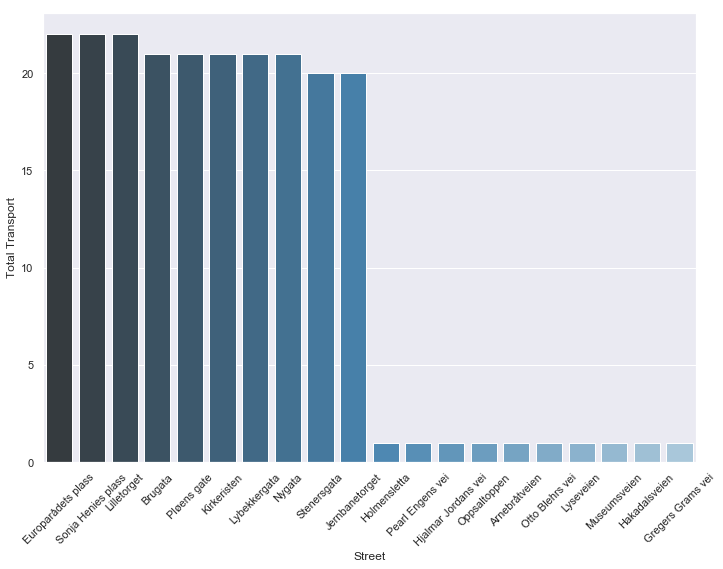

In [2884]:
#Let us combine the top10 and bottom 10 dataframes into a single dataframe
#We will use pd.concat that takes in a LIST of dataframes to concat
df_list = [top_streets, bottom_streets]
combinedTop10_bottom10streets = pd.concat(df_list)
#combinedTop10_bottom10streets

#Let us visualise this
sns.barplot(x = 'Street', y = 'Total Transport', data = combinedTop10_bottom10streets, palette = 'Blues_d')
plt.xticks(rotation = 45)

### 6.3 Distribution of transport options across all streets

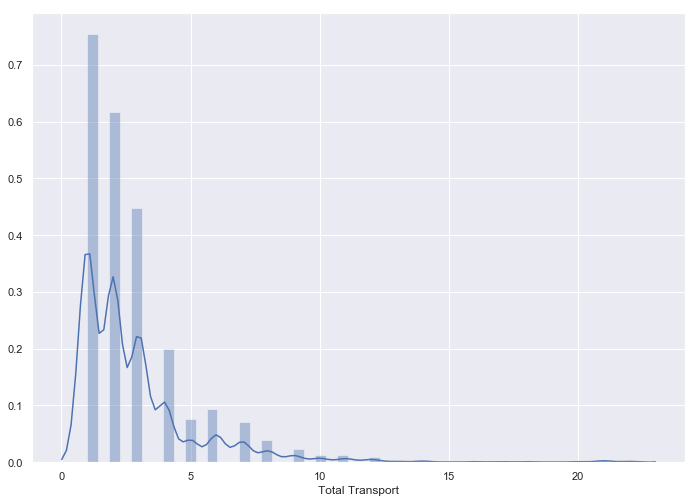

In [2859]:
sns.distplot(orderedStreetTrikkBussMetroTog['Total Transport'])

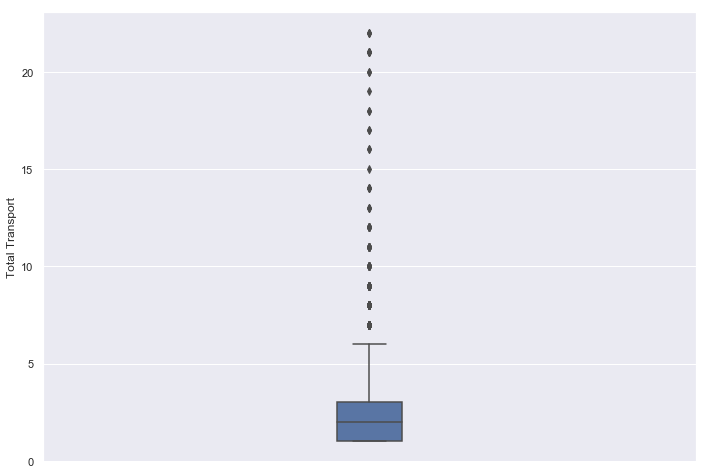

In [2844]:
sns.boxplot(y = orderedStreetTrikkBussMetroTog['Total Transport'], width = 0.1)

### 6.4 Visualise relation between total bus options and total transport

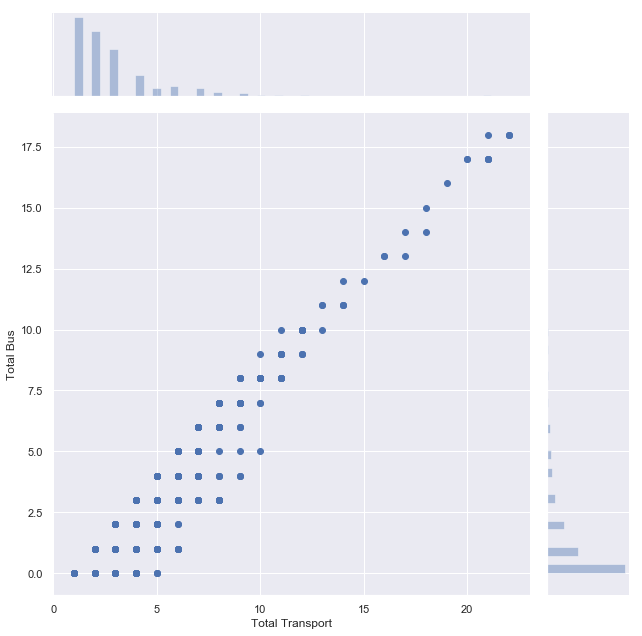

In [2886]:
sns.jointplot(x = 'Total Transport', y = 'Total Bus', data = orderedStreetTrikkBussMetroTog, height= 9)

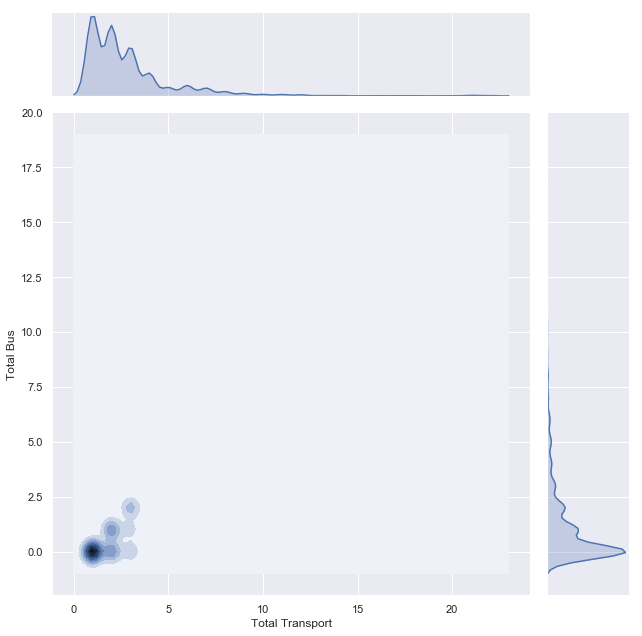

In [2863]:
#Make a density plot version of the above
sns.jointplot(x = 'Total Transport', y = 'Total Bus', kind = 'kde', data = orderedStreetTrikkBussMetroTog, height = 9)

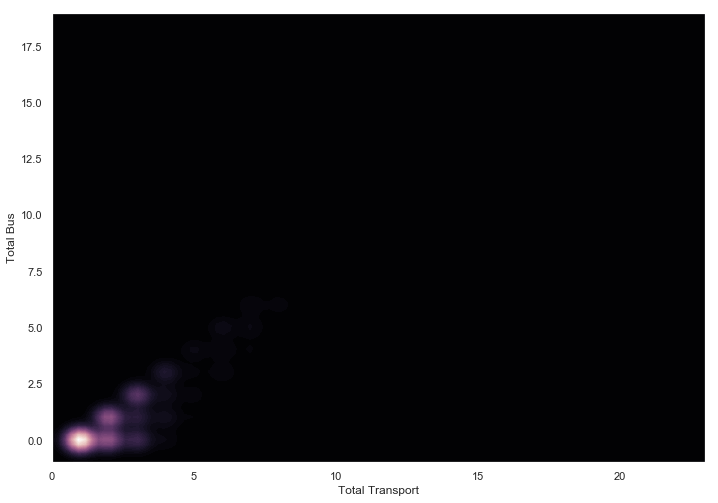

In [2852]:
cmap = sns.cubehelix_palette(as_cmap=True, dark=0, light=1, reverse=True)
sns.kdeplot(orderedStreetTrikkBussMetroTog['Total Transport'], orderedStreetTrikkBussMetroTog['Total Bus'], cmap=cmap, n_levels=60, shade=True);


### 6.4 Divide streets based on no. of transport options

In [2902]:
bins = np.linspace(min(orderedStreetTrikkBussMetroTog['Total Transport']), max(orderedStreetTrikkBussMetroTog['Total Transport']), 8)#Provide 1 more than the number of levels to create
bins

array([ 1.,  4.,  7., 10., 13., 16., 19., 22.])

In [2903]:
group_names = ['1-4', '5-7', '8-10', '11-13', '14-16', '17-19', '20-22']

In [2904]:
orderedStreetTrikkBussMetroTog['Binned Transport'] = pd.cut(orderedStreetTrikkBussMetroTog['Total Transport'], bins, labels = group_names, include_lowest= True)
orderedStreetTrikkBussMetroTog[['Binned Transport','Total Transport']].head(20)

/opt/local/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


,Binned Transport,Total Transport
0,20-22,22
1,20-22,22
2,20-22,22
3,20-22,21
4,20-22,21
5,20-22,21
6,20-22,21
7,20-22,21
8,20-22,20
9,20-22,20


In [2905]:
orderedStreetTrikkBussMetroTog['Binned Transport'].value_counts()

1-4      2085
5-7       249
8-10       78
11-13      26
20-22      10
14-16       7
17-19       5
Name: Binned Transport, dtype: int64

In [2906]:
new_df = orderedStreetTrikkBussMetroTog['Binned Transport'].value_counts().to_frame()
new_df

,Binned Transport
1-4,2085
5-7,249
8-10,78
11-13,26
20-22,10
14-16,7
17-19,5


In [2907]:
new_df.reset_index(inplace = True)
new_df.columns = ['Transport Options', 'Total Streets']
new_df

,Transport Options,Total Streets
0,1-4,2085
1,5-7,249
2,8-10,78
3,11-13,26
4,20-22,10
5,14-16,7
6,17-19,5


(array([0, 1, 2, 3, 4, 5, 6]), <a list of 7 Text xticklabel objects>)

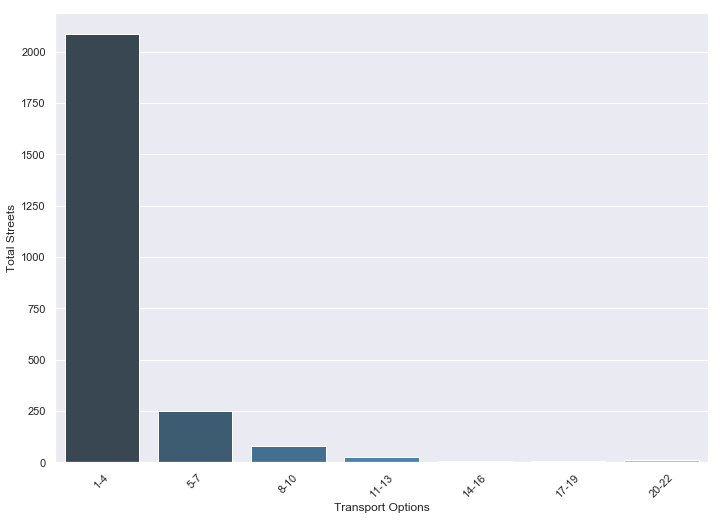

In [2908]:
sns.barplot(x = 'Transport Options', y = 'Total Streets', data = new_df, palette= 'Blues_d')
plt.xticks(rotation = 45)

## Step 7 Clustering and Visualisation

In [2909]:
#K-means clustering on Total Transport
kclusters = 7

#Create object
kmClust = KMeans(init = 'k-means++', n_clusters = kclusters, n_init= 12, random_state= 1)

#Fit
kmLabels4 = kmClust.fit(orderedStreetTrikkBussMetroTog[['Total Transport']])

#Check labels
kmLabels4.labels_[0:6]

array([4, 4, 4, 4, 4, 4], dtype=int32)

In [2913]:
#Insert into dataframe of ordered bus trikk
orderedStreetTrikkBussMetroTog.drop('Cluster', axis = 'columns', inplace = True)#In case Cluster exists already from previous rounds
orderedStreetTrikkBussMetroTog.insert(3, 'Cluster', kmLabels4.labels_)
orderedStreetTrikkBussMetroTog.head(20)

,Street,Street Latitude,Street Longitude,Cluster,Trikk,Trikk Distance,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,T-bane_1,T-bane_2,T-bane_3,T-bane_4,Train Station,Total Transport,Total Bus,Binned Transport
0,Europarådets plass,59.912000,10.749300,4,Jernbanetorget (Trikk/B),48,Buss 31 E,Buss 34,Buss 542 Seiersten Ekspress,Buss 54,Buss 82E,Buss 143,Buss 542 Til Drøbak,Buss 37,Buss 70,Buss 54,Buss 30,Buss 252,buss 500,Buss 83,Buss 31,81B-Bussen,81A-bussen,platform 29 oslo bussterminal,"(Jernbanetorget (T), 164)","(Stortinget (T), 420)",None,None,"(Oslo Sentralstasjon, 300)",22,18,20-22
1,Sonja Henies plass,59.912700,10.755500,4,NA,NA,Buss 252,platform 29 oslo bussterminal,buss 500,Buss 70,Buss 30,Buss 143,Buss 34,Buss 490E,Buss 54,Buss 54,Buss 31 E,Buss 82E,Buss 31,Buss 542 Seiersten Ekspress,Buss 111,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,550 Oslo Bussterminal - Lillestrøm,plattform 20-Buss 501 enebakk-Lillestrøm,"(Jernbanetorget (T), 190)","(Grønland (T), 327)",None,None,"(Oslo Sentralstasjon, 240)",22,18,20-22
2,Lilletorget,59.913500,10.755900,4,Jernbanetorget (Trikk/B),356,buss 500,Buss 30,Buss 252,Buss 70,Buss 34,Buss 54,Buss 143,Buss 54,Buss 490E,platform 29 oslo bussterminal,Buss 111,Buss 31,Buss 31 E,Buss 542 Seiersten Ekspress,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,plattform 20-Buss 501 enebakk-Lillestrøm,550 Oslo Bussterminal - Lillestrøm,Plattform 18 - Buss 411 Lillestrøm,"(Jernbanetorget (T), 248)","(Grønland (T), 318)",None,None,"(Oslo Sentralstasjon, 332)",22,18,20-22
3,Brugata,59.914005,10.755774,4,Jernbanetorget (Trikk/B),375,Buss 30,buss 500,Buss 252,Buss 54,Buss 70,Buss 34,Buss 111,Buss 143,Buss 490E,Buss 54,Buss 31,Buss 31 E,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,plattform 20-Buss 501 enebakk-Lillestrøm,550 Oslo Bussterminal - Lillestrøm,Plattform 18 - Buss 411 Lillestrøm,None,"(Jernbanetorget (T), 277)","(Grønland (T), 345)",None,None,"(Oslo Sentralstasjon, 384)",21,17,20-22
4,Pløens gate,59.913900,10.749325,4,Jernbanetorget (Trikk/B),187,Buss 54,Buss 31,Buss 54,Buss 30,Buss 37,Buss 34,Buss 31 E,Buss 70,Buss 143,Buss 252,Buss 82E,Buss 542 Til Drøbak,buss 500,Buss 542 Seiersten Ekspress,81A-bussen,81B-Bussen,platform 29 oslo bussterminal,None,"(Jernbanetorget (T), 241)","(Stortinget (T), 428)",None,None,"(Oslo Sentralstasjon, 443)",21,17,20-22
5,Kirkeristen,59.913000,10.747450,4,Jernbanetorget (Trikk/B),166,Buss 37,Buss 31 E,Buss 54,Buss 54,Buss 34,Buss 30,Buss 31,Buss 542 Til Drøbak,Buss 82E,Buss 143,Buss 542 Seiersten Ekspress,Buss 83,Buss 70,Buss 252,Buss 32,81B-Bussen,81A-bussen,None,"(Jernbanetorget (T), 276)","(Stortinget (T), 307)",None,None,"(Oslo Sentralstasjon, 447)",21,17,20-22
6,Lybekkergata,59.913567,10.752767,4,Jernbanetorget (Trikk/B),212,Buss 30,Buss 54,Buss 54,Buss 34,Buss 70,Buss 31,Buss 252,Buss 143,buss 500,Buss 31 E,Buss 37,Buss 82E,Buss 111,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,81A-bussen,"(Jernbanetorget (T), 147)",None,None,None,"(Oslo Sentralstasjon, 329)",21,18,20-22
7,Nygata,59.913150,10.750750,4,Jernbanetorget (Trikk/B),108,Buss 54,Buss 54,Buss 34,Buss 30,Buss 31 E,Buss 31,Buss 70,Buss 143,Buss 37,Buss 252,Buss 82E,Buss 542 Til Drøbak,buss 500,Buss 542 Seiersten Ekspress,81B-Bussen,81A-bussen,platform 29 oslo bussterminal,None,"(Jernbanetorget (T), 126)","(Stortinget (T), 492)",None,None,"(Oslo Sentralstasjon, 329)",21,17,20-22
8,Stenersgata,59.913111,10.752633,4,Jernbanetorget (Trikk/B),174,Buss 30,Buss 34,Buss 70,Buss 54,Buss 54,Buss 252,Buss 143,Buss 31,Buss 31 E,buss 500,Buss 37,Buss 82E,Buss 542 Til Drøbak,Buss 542 Seiersten Ekspress,Buss 111,platform 29 oslo bussterminal,150 Oslo Bussterminal - Gullhaug - Oslo Busst...,None,"(Jernbanetorget (T), 96)",None,None,None,"(Oslo Sentralstasjon, 281)",20,17,20-22
9,Jernbanetorget,59.911300,10.750425,4,Jernbanetorget (Trikk/B),107,Buss 31 E,Buss 542 Seiersten Ekspress,Buss 82E,Buss 143,Bus

In [2916]:
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

#Make map object
map_cluster = folium.Map(location=[latitude, longitude], zoom_start=11)


# set color scheme for the clusters
x = np.arange(kclusters)#kclusters
ys = [i + x + (i*x)**2 for i in range(kclusters)]#kclusters
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to map
markers_colors = []
for lat, lng, street, cluster, group in zip(orderedStreetTrikkBussMetroTog['Street Latitude'], orderedStreetTrikkBussMetroTog['Street Longitude'],
                                   orderedStreetTrikkBussMetroTog['Street'], orderedStreetTrikkBussMetroTog['Cluster'].astype('int'), orderedStreetTrikkBussMetroTog['Binned Transport']):
    

    #label = folium.Popup(str(street) + ' Cluster ' + str(cluster) + ' ' + str(group), parse_html=True)
    label = folium.Popup(str(street) + ' Group:' + str(group) + '\nCluster:'+ str(cluster) , parse_html = True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_cluster)
       
map_cluster

#### Cluster 4

In [2934]:
#Let us compare Total transport options for various clusters
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 4].iloc[:, -3:]

,Total Transport,Total Bus,Binned Transport
0,22,18,20-22
1,22,18,20-22
2,22,18,20-22
3,21,17,20-22
4,21,17,20-22
5,21,17,20-22
6,21,18,20-22
7,21,17,20-22
8,20,17,20-22
9,20,17,20-22


So we see all streets with __15+__ transport options get categorised into **Cluster 4**

#### Cluster 2

In [2936]:
#Let us compare Total transport options for various clusters
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 2].iloc[:, -3:].tail()

,Total Transport,Total Bus,Binned Transport
81,9,6,8-10
82,9,7,8-10
83,9,4,8-10
84,9,8,8-10
85,9,7,8-10


Here, we see all streets with __9-14__ transport options are put into **Cluster 2**

#### Cluster 5

In [2950]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 5].iloc[:, -3:].head()

,Total Transport,Total Bus,Binned Transport
86,8,6,8-10
87,8,6,8-10
88,8,5,8-10
89,8,7,8-10
90,8,6,8-10


In [2951]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 5].iloc[:, -3:].tail()

,Total Transport,Total Bus,Binned Transport
291,6,4,5-7
292,6,4,5-7
293,6,3,5-7
294,6,4,5-7
295,6,5,5-7


All streets with __6-8__ transport options are in **Cluster 5**

#### Cluster 0

In [2941]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 0].iloc[:, -3:].head()

,Total Transport,Total Bus,Binned Transport
296,5,4,5-7
297,5,2,5-7
298,5,2,5-7
299,5,4,5-7
300,5,4,5-7


In [2940]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 0].iloc[:, -3:].tail()

,Total Transport,Total Bus,Binned Transport
576,4,0,1-4
577,4,3,1-4
578,4,3,1-4
579,4,3,1-4
580,4,0,1-4


All streets with __4-5__ transport options are in **Cluster 0**

#### Cluster 3

In [2947]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 3].iloc[:, -3:].head()

,Total Transport,Total Bus,Binned Transport
581,3,0,1-4
582,3,1,1-4
583,3,2,1-4
584,3,0,1-4
585,3,0,1-4


In [2948]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 3].iloc[:, -3:].tail()

,Total Transport,Total Bus,Binned Transport
1038,3,2,1-4
1039,3,0,1-4
1040,3,1,1-4
1041,3,2,1-4
1042,3,2,1-4


All streets with __3__ transport options are in **Cluster 3**

#### Cluster 6

In [2952]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 6].iloc[:, -3:].head()

,Total Transport,Total Bus,Binned Transport
1043,2,1,1-4
1044,2,1,1-4
1045,2,0,1-4
1046,2,1,1-4
1047,2,0,1-4


In [2953]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 6].iloc[:, -3:].tail()

,Total Transport,Total Bus,Binned Transport
1676,2,1,1-4
1677,2,1,1-4
1678,2,0,1-4
1679,2,0,1-4
1680,2,1,1-4


All streets with __2__ transport options are in **Cluster 6**

#### Cluster 1

In [2944]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 1].iloc[:, -3:].head()

,Total Transport,Total Bus,Binned Transport
1681,1,0,1-4
1682,1,0,1-4
1683,1,0,1-4
1684,1,0,1-4
1685,1,0,1-4


In [2945]:
orderedStreetTrikkBussMetroTog[ orderedStreetTrikkBussMetroTog['Cluster'] == 1].iloc[:, -3:].tail()

,Total Transport,Total Bus,Binned Transport
2455,1,0,1-4
2456,1,0,1-4
2457,1,0,1-4
2458,1,0,1-4
2459,1,0,1-4


All streets with __1__ transport options are in **Cluster 0**

In [2969]:
#Let us find out how many streets belong to each cluster
cluster_df = orderedStreetTrikkBussMetroTog['Cluster'].value_counts().to_frame()
cluster_df

#Reset index
cluster_df.reset_index(inplace = True)

#Change column name
cluster_df.columns = ['Cluster Label', 'Total Streets']
cluster_df
#cluster_df.sort_values(by = 'Cluster Label', ascending = True, axis = 'rows')

,Cluster Label,Total Streets
0,1,779
1,6,638
2,3,462
3,0,285
4,5,210
5,2,68
6,4,18


### Let us make new column label that describes the no. of transport options in each cluster

In [2993]:
bins_kmeans = [0, 1, 2, 3, 5, 8, 14, 22]#Set the values -1 from the range you want, so if you want >15, so give 14; similarly if you want 9-14, give 8; want 6-8, give 5; want 4-5 give 3; want 3 give 2; want 2 give 1
bins_kmeans

[0, 1, 2, 3, 5, 8, 14, 22]

In [2994]:
group_names2 = ['1', '2', '3', '4-5', '6-8', '9-14', '15+']

In [2995]:
orderedStreetTrikkBussMetroTog['Clustered Transport'] = pd.cut(orderedStreetTrikkBussMetroTog['Total Transport'], bins_kmeans, labels = group_names2, include_lowest= True)
orderedStreetTrikkBussMetroTog[['Clustered Transport','Total Transport']]

/opt/local/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


,Clustered Transport,Total Transport
0,15+,22
1,15+,22
2,15+,22
3,15+,21
4,15+,21
5,15+,21
6,15+,21
7,15+,21
8,15+,20
9,15+,20


In [2997]:
#Ensure value counts is the same as the cluster labels
orderedStreetTrikkBussMetroTog['Clustered Transport'].value_counts().to_frame()

,Clustered Transport
1,779
2,638
3,462
4-5,285
6-8,210
9-14,68
15+,18


In [3000]:
#And in Cluster df
cluster_df

,Cluster Label,Total Streets
0,1,779
1,6,638
2,3,462
3,0,285
4,5,210
5,2,68
6,4,18


### Make the Folium map, this time, showing no. of transport options in each cluster

In [3016]:
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

#Make map object
map_cluster = folium.Map(location=[latitude, longitude], zoom_start=12, tiles= 'Stamen Toner')#'Stamen Toner' 'Stamen Terrain' 'Mapbox Bright' 'Mapbox Control Room' MAPBOX DOES NOT RENDER


# set color scheme for the clusters
#x = np.arange(kclusters)#kclusters
#ys = [i + x + (i*x)**2 for i in range(kclusters)]#kclusters
#colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
#rainbow = [colors.rgb2hex(i) for i in colors_array]
x = np.arange(kclusters)
colors_array = cm.rainbow(np.linspace(0, .8, len(x)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


# add markers to map
markers_colors = []
for lat, lng, street, cluster, group in zip(orderedStreetTrikkBussMetroTog['Street Latitude'], orderedStreetTrikkBussMetroTog['Street Longitude'],
                                   orderedStreetTrikkBussMetroTog['Street'], orderedStreetTrikkBussMetroTog['Cluster'].astype('int'), orderedStreetTrikkBussMetroTog['Clustered Transport']):
    

    #label = folium.Popup(str(street) + ' Cluster ' + str(cluster) + ' ' + str(group), parse_html=True)
    label = folium.Popup(str(street) + ' Transport Options:' + str(group) + '\nCluster:'+ str(cluster) , parse_html = True)
    folium.CircleMarker(
        [lat, lng],
        radius=10,
        popup=label,
        color= rainbow[cluster],#rainbow[cluster-1],
        fill=True,
        fill_color= rainbow[cluster],#rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_cluster)
       
map_cluster

# Part IV: Conclusion & Discussion

## Conclusion

Vast parts of Oslo, measured down to the street level have very few transport options within 400m.  
With the help of the above map, the Transport Department can now easily plan which areas of Oslo to emphasise for building more infrastructure.

## Discussion

A major caveat in this work is that mid points of streets were taken. Since we define nearest transport option as those within 400m radius, ff the street itself is >800m in length, then the midpoint may not necesarily be a good location measurement.

One can elaborate this project further:-
* by obtaining population info (folketal) for each bydel (city district) / streets and making choropleth maps showing population density
 * choropleth maps need GeoJSON file containing boundary info for each bydel/city district
* by mapping foot traffic info onto heatmaps, that can help truly emphasize areas with maximum passenger traffic
* Work on ferry data as well
* Use Google Maps API instead of Foursquare API